# **Statistical and Clustering Analysis of St. Patrick's Day Footfall Counts in Dublin City Centre**
### *Prepared by Ben Wilson, sbs24004, CCT*
## Introduction
This project aims to uncover patterns and trends in pedestrian footfall within Dublin City Centre, focusing particularly on the dynamics surrounding St. Patrick's Day, and identifying similar behaviour of other events throughout the year. As Ireland's national holiday, St. Patrick's Day attracts thousands of both local and international tourists to the capital's streets. The project will mainly utilise footfall count data from 2023 to highlight trends, peak activity, and heavily used areas. By comparing everyday footfall with that on St. Patrick's Day, to reveal changes in footfall dynamics and tourist visitor volume, including a year-on-year comparison. Through the use of unsupervised k-means clustering, identify signature footfall patterns associated with large-scale events, and group them with other periods of similar activity. This should serve to provide future insights valuable for large-scale event organisation, tourism boards, festival coordinators, and local businesses.

> *"Fáilte Ireland is pleased to welcome thousands of visitors to locations across the country this weekend for St. Patrick’s Day celebrations. Festivals and events play a key role in delivering brilliant experiences, providing a unique reason for visitors to choose a destination and increase footfall for local businesses, supporting jobs and revenue generation. Fáilte Ireland estimates that last year 570,000 people attended the Saint Patrick’s Festival Dublin over the bank holiday weekend generating €113million in revenue for Dublin."*  
Source: [Fáilte Ireland 2024](https://www.failteireland.ie/Utility/News-Library/failte-ireland-welcomes-visitors-st-patricks-day.aspx)

## Objectives:
- To perform statistical analysis of footfall count patterns in Dublin City Centre
- To quantify the effect of St. Patrick's Day Festival on pedestrian footfall and compare counts with previous years
- To create a k-means clustering machine learning model for identifying similar periods of activity and their characteristics

## Data Source
The data used in this project was downloaded from Smart Dublin; a data set entitled [Pedestrian Footfall DCC](https://data.smartdublin.ie/dataset/dublin-city-centre-footfall-counters). According to the "Dublinked Open Data Store", the counts are recorded using *"a network of PYRO-Box people counters located throughout central Dublin"*. The data is supplied by Dublin City Council and the NTA (National Transport Authority).

# **0. Imports and Settings**

In [1]:
import pandas as pd
import seaborn as sns
import numpy as np
import matplotlib.pyplot as plt
import scipy.stats as stats
import plotly.express as px 

from scipy.stats import poisson

from sklearn.experimental import enable_iterative_imputer
from sklearn.impute import IterativeImputer
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
from yellowbrick.cluster import KElbowVisualizer
from yellowbrick.cluster import SilhouetteVisualizer
from sklearn.cluster import AgglomerativeClustering
from scipy.cluster.hierarchy import dendrogram, linkage

import warnings
warnings.filterwarnings('ignore')

pd.set_option('display.max_columns', None) #set pandas to display all columns

# **1. Initial Exploratory Data Analysis**

In [2]:
# import Footfall 2023 CSV as a DataFrame
footfall23_df = pd.read_csv('DCCpfc2023.csv')

In [3]:
# examine the initial rows
footfall23_df.head(5)

,Time,Aston Quay/Fitzgeralds,Aston Quay/Fitzgeralds IN,Aston Quay/Fitzgeralds OUT,Bachelors walk/Bachelors way,Bachelors walk/Bachelors way IN,Bachelors walk/Bachelors way OUT,Baggot st lower/Wilton tce inbound,Baggot st lower/Wilton tce inbound Pedestrians IN,Baggot st lower/Wilton tce inbound Pedestrians OUT,Baggot st upper/Mespil rd/Bank,Baggot st upper/Mespil rd/Bank Pedestrians IN,Baggot st upper/Mespil rd/Bank Pedestrians OUT,Capel st/Mary street,Capel st/Mary street Pedestrian IN,Capel st/Mary street Pedestrian OUT,College Green/Bank Of Ireland,College Green/Bank Of Ireland IN,College Green/Bank Of Ireland OUT,College Green/Church Lane,College Green/Church Lane IN,College Green/Church Lane OUT,College st/Westmoreland st,College st/Westmoreland st IN,College st/Westmoreland st OUT,D'olier st/Burgh Quay,D'olier st/Burgh Quay IN,D'olier st/Burgh Quay OUT,Dame Street/Londis,Dame Street/Londis Pedestrian IN,Dame Street/Londis Pedestrian OUT,Dawson Street,Dawson Street IN,Dawson Street OUT,Dawson Street old,Dawson Street old IN,Dawson Street old OUT,Dawson Street/Molesworth Pedestrian,Dawson Street/Molesworth IN,Dawson Street/Molesworth OUT,Grafton st/Monsoon,Grafton st/Monsoon Pedestrian IN,Grafton st/Monsoon Pedestrian OUT,Grafton Street / Nassau Street / Suffolk Street,Grafton Street / Nassau Street / Suffolk Street IN,Grafton Street / Nassau Street / Suffolk Street OUT,Grafton Street/CompuB,Grafton Street/CompuB IN,Grafton Street/CompuB OUT,Grand Canal st upp/Clanwilliam place,Grand Canal st upp/Clanwilliam place Pedestrians IN,Grand Canal st upp/Clanwilliam place Pedestrians OUT,Grand Canal st upp/Clanwilliam place/Google,Grand Canal st upp/Clanwilliam place/Google Pedestrians IN,Grand Canal st upp/Clanwilliam place/Google Pedestrians OUT,Henry Street/Coles Lane/Dunnes,Henry Street/Coles Lane/Dunnes Pedestrian IN,Henry Street/Coles Lane/Dunnes Pedestrian OUT,Liffey st/Halfpenny Bridge,Liffey st/Halfpenny Bridge Pedestrian IN,Liffey st/Halfpenny Bridge Pedestrian OUT,Liffey Street old,Liffey Street old IN,Liffey Street old OUT,Mary st/Jervis st,Mary st/Jervis st IN,Mary st/Jervis st OUT,Newcomen Bridge/Charleville mall inbound,Newcomen Bridge/Charleville mall inbound Pedestrians IN,Newcomen Bridge/Charleville mall inbound Pedestrians OUT,Newcomen Bridge/Charleville mall outbound,Newcomen Bridge/Charleville mall outbound Pedestrians IN,Newcomen Bridge/Charleville mall outbound Pedestrians OUT,North Wall Quay/Samuel Beckett bridge East,North Wall Quay/Samuel Beckett bridge East Channel 1 IN,North Wall Quay/Samuel Beckett bridge East Channel 2 OUT,North Wall Quay/Samuel Beckett bridge West,North Wall Quay/Samuel Beckett bridge West Pedestrians IN,North Wall Quay/Samuel Beckett bridge West Pedestrians OUT,O'Connell St/Parnell St/AIB,O'Connell St/Parnell St/AIB IN,O'Connell St/Parnell St/AIB OUT,O'Connell St/Pennys Pedestrian,O'Connell St/Pennys Pedestrian IN,O'Connell St/Pennys Pedestrian OUT,O'Connell st/Princes st North,O'Connell st/Princes st North IN,O'Connell st/Princes st North OUT,O'Connell Street Pennys - PYRO EVO Temporary Counter,O'Connell Street Pennys - PYRO EVO Temporary Counter Pedestrian IN,O'Connell Street Pennys - PYRO EVO Temporary Counter Pedestrian OUT,Phibsborough Rd/Enniskerry Road,Phibsborough Rd/Enniskerry Road Pedestrians IN,Phibsborough Rd/Enniskerry Road Pedestrians OUT,Phibsborough Rd/Munster St (Removed due to Overcounting),Phibsborough Rd/Munster St (Removed due to Overcounting) Peds IN,Phibsborough Rd/Munster St (Removed due to Overcounting) Peds OUT,Richmond st south/Portabello Harbour inbound,Richmond st south/Portabello Harbour inbound Pedestrians IN,Richmond st south/Portabello Harbour inbound Pedestrians OUT,Richmond st south/Portabello Harbour outbound,Richmond st south/Portabello Harbour outbound Pedestrians IN,Richmond st south/Portabello Harbour outbound Pedestrians OUT,Talbot st/Guineys,Talbot st/Guineys IN,Talbot st/Guineys OUT,Talbot st/Murrays Pharmacy,Talbot st/Murrays Pharmacy IN,

In [4]:
# examine the shape of the data
footfall23_df.shape

(8760, 115)

**Observations**
- There are 8760 hours in a year
- Data includes 38 counters, each with an IN and OUT column; 3 x 38 = 114 + 1 Time = 115
- Time is not the index, but instead in column 0

In [5]:
# describe the properties of every column
footfall23_df.describe(include='all')

,Time,Aston Quay/Fitzgeralds,Aston Quay/Fitzgeralds IN,Aston Quay/Fitzgeralds OUT,Bachelors walk/Bachelors way,Bachelors walk/Bachelors way IN,Bachelors walk/Bachelors way OUT,Baggot st lower/Wilton tce inbound,Baggot st lower/Wilton tce inbound Pedestrians IN,Baggot st lower/Wilton tce inbound Pedestrians OUT,Baggot st upper/Mespil rd/Bank,Baggot st upper/Mespil rd/Bank Pedestrians IN,Baggot st upper/Mespil rd/Bank Pedestrians OUT,Capel st/Mary street,Capel st/Mary street Pedestrian IN,Capel st/Mary street Pedestrian OUT,College Green/Bank Of Ireland,College Green/Bank Of Ireland IN,College Green/Bank Of Ireland OUT,College Green/Church Lane,College Green/Church Lane IN,College Green/Church Lane OUT,College st/Westmoreland st,College st/Westmoreland st IN,College st/Westmoreland st OUT,D'olier st/Burgh Quay,D'olier st/Burgh Quay IN,D'olier st/Burgh Quay OUT,Dame Street/Londis,Dame Street/Londis Pedestrian IN,Dame Street/Londis Pedestrian OUT,Dawson Street,Dawson Street IN,Dawson Street OUT,Dawson Street old,Dawson Street old IN,Dawson Street old OUT,Dawson Street/Molesworth Pedestrian,Dawson Street/Molesworth IN,Dawson Street/Molesworth OUT,Grafton st/Monsoon,Grafton st/Monsoon Pedestrian IN,Grafton st/Monsoon Pedestrian OUT,Grafton Street / Nassau Street / Suffolk Street,Grafton Street / Nassau Street / Suffolk Street IN,Grafton Street / Nassau Street / Suffolk Street OUT,Grafton Street/CompuB,Grafton Street/CompuB IN,Grafton Street/CompuB OUT,Grand Canal st upp/Clanwilliam place,Grand Canal st upp/Clanwilliam place Pedestrians IN,Grand Canal st upp/Clanwilliam place Pedestrians OUT,Grand Canal st upp/Clanwilliam place/Google,Grand Canal st upp/Clanwilliam place/Google Pedestrians IN,Grand Canal st upp/Clanwilliam place/Google Pedestrians OUT,Henry Street/Coles Lane/Dunnes,Henry Street/Coles Lane/Dunnes Pedestrian IN,Henry Street/Coles Lane/Dunnes Pedestrian OUT,Liffey st/Halfpenny Bridge,Liffey st/Halfpenny Bridge Pedestrian IN,Liffey st/Halfpenny Bridge Pedestrian OUT,Liffey Street old,Liffey Street old IN,Liffey Street old OUT,Mary st/Jervis st,Mary st/Jervis st IN,Mary st/Jervis st OUT,Newcomen Bridge/Charleville mall inbound,Newcomen Bridge/Charleville mall inbound Pedestrians IN,Newcomen Bridge/Charleville mall inbound Pedestrians OUT,Newcomen Bridge/Charleville mall outbound,Newcomen Bridge/Charleville mall outbound Pedestrians IN,Newcomen Bridge/Charleville mall outbound Pedestrians OUT,North Wall Quay/Samuel Beckett bridge East,North Wall Quay/Samuel Beckett bridge East Channel 1 IN,North Wall Quay/Samuel Beckett bridge East Channel 2 OUT,North Wall Quay/Samuel Beckett bridge West,North Wall Quay/Samuel Beckett bridge West Pedestrians IN,North Wall Quay/Samuel Beckett bridge West Pedestrians OUT,O'Connell St/Parnell St/AIB,O'Connell St/Parnell St/AIB IN,O'Connell St/Parnell St/AIB OUT,O'Connell St/Pennys Pedestrian,O'Connell St/Pennys Pedestrian IN,O'Connell St/Pennys Pedestrian OUT,O'Connell st/Princes st North,O'Connell st/Princes st North IN,O'Connell st/Princes st North OUT,O'Connell Street Pennys - PYRO EVO Temporary Counter,O'Connell Street Pennys - PYRO EVO Temporary Counter Pedestrian IN,O'Connell Street Pennys - PYRO EVO Temporary Counter Pedestrian OUT,Phibsborough Rd/Enniskerry Road,Phibsborough Rd/Enniskerry Road Pedestrians IN,Phibsborough Rd/Enniskerry Road Pedestrians OUT,Phibsborough Rd/Munster St (Removed due to Overcounting),Phibsborough Rd/Munster St (Removed due to Overcounting) Peds IN,Phibsborough Rd/Munster St (Removed due to Overcounting) Peds OUT,Richmond st south/Portabello Harbour inbound,Richmond st south/Portabello Harbour inbound Pedestrians IN,Richmond st south/Portabello Harbour inbound Pedestrians OUT,Richmond st south/Portabello Harbour outbound,Richmond st south/Portabello Harbour outbound Pedestrians IN,Richmond st south/Portabello Harbour outbound Pedestrians OUT,Talbot st/Guineys,Talbot st/Guineys IN,Talbot st/Guineys OUT,Talbot st/Murrays Pharmacy,Talbot st/Murrays Pharmacy IN,

**Observations**
- There are several columns with NaNs
- There is a wide range of values across locations, continuous and numerical

In [6]:
# dataframe information
footfall23_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8760 entries, 0 to 8759
Columns: 115 entries, Time to Westmoreland Street West/Carrolls OUT
dtypes: float64(114), object(1)
memory usage: 7.7+ MB


**Observations**
- All locations contain float64 data type

In [7]:
# df column headings
footfall23_df.columns

Index(['Time', 'Aston Quay/Fitzgeralds', 'Aston Quay/Fitzgeralds IN',
       'Aston Quay/Fitzgeralds OUT', 'Bachelors walk/Bachelors way',
       'Bachelors walk/Bachelors way IN', 'Bachelors walk/Bachelors way OUT',
       'Baggot st lower/Wilton tce inbound',
       'Baggot st lower/Wilton tce inbound Pedestrians IN',
       'Baggot st lower/Wilton tce inbound Pedestrians OUT',
       ...
       'Talbot st/Guineys OUT', 'Talbot st/Murrays Pharmacy',
       'Talbot st/Murrays Pharmacy IN', 'Talbot st/Murrays Pharmacy OUT',
       'Westmoreland Street East/Fleet street',
       'Westmoreland Street East/Fleet street IN',
       'Westmoreland Street East/Fleet street OUT',
       'Westmoreland Street West/Carrolls',
       'Westmoreland Street West/Carrolls IN',
       'Westmoreland Street West/Carrolls OUT'],
      dtype='object', length=115)

# **2. Data Cleaning and Preparation**

## **2.1 Define Function for Column Removal**

The columns with IN/OUT data, although possibly useful for analysis, will not be considered, due to the limited scope of this project. A function was defined in order to automatically remove these columns, which are present in all datasets. In file UserDefinedFunctions, see **"remove_IN_OUT( )"**

In [8]:
from UserDefinedFunctions import remove_IN_OUT

In [9]:
footfall23_df = remove_IN_OUT(footfall23_df)

In [10]:
footfall23_df.shape

(8760, 39)

In [11]:
list(footfall23_df)

['Time',
 'Aston Quay/Fitzgeralds',
 'Bachelors walk/Bachelors way',
 'Baggot st lower/Wilton tce inbound',
 'Baggot st upper/Mespil rd/Bank',
 'Capel st/Mary street',
 'College Green/Bank Of Ireland',
 'College Green/Church Lane',
 'College st/Westmoreland st',
 "D'olier st/Burgh Quay",
 'Dame Street/Londis',
 'Dawson Street',
 'Dawson Street old',
 'Dawson Street/Molesworth Pedestrian',
 'Grafton st/Monsoon',
 'Grafton Street / Nassau Street / Suffolk Street',
 'Grafton Street/CompuB',
 'Grand Canal st upp/Clanwilliam place',
 'Grand Canal st upp/Clanwilliam place/Google',
 'Henry Street/Coles Lane/Dunnes',
 'Liffey st/Halfpenny Bridge ',
 'Liffey Street old',
 'Mary st/Jervis st',
 'Newcomen Bridge/Charleville mall inbound',
 'Newcomen Bridge/Charleville mall outbound',
 'North Wall Quay/Samuel Beckett bridge East',
 'North Wall Quay/Samuel Beckett bridge West',
 "O'Connell St/Parnell St/AIB",
 "O'Connell St/Pennys Pedestrian",
 "O'Connell st/Princes st North",
 "O'Connell Street Pe

**Observations**
- Columns containing IN/OUT have been successfully removed

In [12]:
footfall23_df.describe(include='all')

,Time,Aston Quay/Fitzgeralds,Bachelors walk/Bachelors way,Baggot st lower/Wilton tce inbound,Baggot st upper/Mespil rd/Bank,Capel st/Mary street,College Green/Bank Of Ireland,College Green/Church Lane,College st/Westmoreland st,D'olier st/Burgh Quay,Dame Street/Londis,Dawson Street,Dawson Street old,Dawson Street/Molesworth Pedestrian,Grafton st/Monsoon,Grafton Street / Nassau Street / Suffolk Street,Grafton Street/CompuB,Grand Canal st upp/Clanwilliam place,Grand Canal st upp/Clanwilliam place/Google,Henry Street/Coles Lane/Dunnes,Liffey st/Halfpenny Bridge,Liffey Street old,Mary st/Jervis st,Newcomen Bridge/Charleville mall inbound,Newcomen Bridge/Charleville mall outbound,North Wall Quay/Samuel Beckett bridge East,North Wall Quay/Samuel Beckett bridge West,O'Connell St/Parnell St/AIB,O'Connell St/Pennys Pedestrian,O'Connell st/Princes st North,O'Connell Street Pennys - PYRO EVO Temporary Counter,Phibsborough Rd/Enniskerry Road,Phibsborough Rd/Munster St (Removed due to Overcounting),Richmond st south/Portabello Harbour inbound,Richmond st south/Portabello Harbour outbound,Talbot st/Guineys,Talbot st/Murrays Pharmacy,Westmoreland Street East/Fleet street,Westmoreland Street West/Carrolls
count,8760,8759.000000,7396.000000,8759.000000,8759.000000,8759.000000,8705.000000,7036.000000,8759.000000,8759.000000,8759.000000,0.0,0.0,288.000000,8759.000000,8624.000000,8753.000000,8759.000000,8759.000000,7323.000000,8759.000000,0.0,8759.000000,1776.000000,1776.000000,8759.000000,8759.000000,7009.000000,6134.000000,8759.000000,0.0,8759.000000,0.0,8759.000000,8759.000000,6731.000000,490.000000,6335.000000,2591.000000
unique,8759,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
top,26/03/2023 02:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
freq,2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
mean,NaN,3371.344446,1408.451190,124.538760,4159.843019,1235.841877,545.744515,590.919983,602.385775,941.580203,449.773718,NaN,NaN,242.315972,1714.571412,250.199907,1886.637496,157.288960,86.402557,4322.961491,5997.553488,NaN,447.103893,0.015203,0.047860,2121.827378,1579.825208,450.667142,1163.812683,710.051262,NaN,95.790501,NaN,753.056970,226.699052,1288.518794,1757.648980,1335.530387,663.332304
std,NaN,1808.971110,3165.336185,135.577782,3044.631578,1037.122022,631.544924,589.564217,462.085500,545.537413,345.492423,NaN,NaN,1196.914984,1317.868458,222.917269,1657.442950,169.240068,92.337422,5496.750807,2151.587064,NaN,452.895346,0.431564,1.343305,1745.855852,1686.160046,459.060047,1021.537384,499.244161,NaN,70.980989,NaN,606.450604,140.043558,1577.094848,660.949162,747.803159,777.595941
min,NaN,27.000000,0.000000,0.000000,4.000000,4.000000,0.000000,0.000000,1.000000,1.000000,0.000000,NaN,NaN,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,183.000000,NaN,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,3.000000,NaN,0.000000,NaN,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,NaN,1900.500000,0.000000,16.000000,1310.000000,387.000000,116.000000,22.000000,168.000000,514.000000,145.000000,NaN,NaN,0.000000,488.000000,59.000000,458.000000,20.000000,14.000000,69.000000,4651.000000,NaN,44.000000,0.000000,0.000000,591.500000,198.000000,29.000000,226.000000,244.000000,NaN,27.000000,NaN,235.000000,106.500000,38.000000,1336.250000,771.000000,0.000000
50%,NaN,3685.000000,62.500000,87.000000,4039.000000,1018.000000,375.000000,408.000000,537.000000,1025.000000,407.000000,NaN,NaN,0.000000,1425.000000,190.000000,1427.000000,103.000000,73.000000,1236.000000,5846.000000,NaN,274.000000,0.000000,0.000000,1769.000000,945.000000,261.000000,856.500000,703.000000,NaN,98.000000,NaN,655.000000,228.000000,283.000000,1811.000000,

In [13]:
footfall23_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8760 entries, 0 to 8759
Data columns (total 39 columns):
 #   Column                                                    Non-Null Count  Dtype  
---  ------                                                    --------------  -----  
 0   Time                                                      8760 non-null   object 
 1   Aston Quay/Fitzgeralds                                    8759 non-null   float64
 2   Bachelors walk/Bachelors way                              7396 non-null   float64
 3   Baggot st lower/Wilton tce inbound                        8759 non-null   float64
 4   Baggot st upper/Mespil rd/Bank                            8759 non-null   float64
 5   Capel st/Mary street                                      8759 non-null   float64
 6   College Green/Bank Of Ireland                             8705 non-null   float64
 7   College Green/Church Lane                                 7036 non-null   float64
 8   College st/Westmor

**Observations**
- Memory usage has decreased
- Several locations with NaNs
- Time is Column 0

## **2.2 Change index to Time**

For ease of future analysis, the index of the data frame will be changed to the Time column, after being formatted to the appropriate DateTime object

In [14]:
footfall23_df['Time'].head(5)

0    01/01/2023 00:00
1    01/01/2023 01:00
2    01/01/2023 02:00
3    01/01/2023 03:00
4    01/01/2023 04:00
Name: Time, dtype: object

In [15]:
# Convert to dateTime format
footfall23_df['Time'] = pd.to_datetime(footfall23_df['Time'], format='%d/%m/%Y %H:%M')

In [16]:
footfall23_df['Time'].head(5)

0   2023-01-01 00:00:00
1   2023-01-01 01:00:00
2   2023-01-01 02:00:00
3   2023-01-01 03:00:00
4   2023-01-01 04:00:00
Name: Time, dtype: datetime64[ns]

In [17]:
 # Set index to Time
footfall23_df.set_index('Time', inplace=True)

In [18]:
footfall23_df.head(5)

,Aston Quay/Fitzgeralds,Bachelors walk/Bachelors way,Baggot st lower/Wilton tce inbound,Baggot st upper/Mespil rd/Bank,Capel st/Mary street,College Green/Bank Of Ireland,College Green/Church Lane,College st/Westmoreland st,D'olier st/Burgh Quay,Dame Street/Londis,Dawson Street,Dawson Street old,Dawson Street/Molesworth Pedestrian,Grafton st/Monsoon,Grafton Street / Nassau Street / Suffolk Street,Grafton Street/CompuB,Grand Canal st upp/Clanwilliam place,Grand Canal st upp/Clanwilliam place/Google,Henry Street/Coles Lane/Dunnes,Liffey st/Halfpenny Bridge,Liffey Street old,Mary st/Jervis st,Newcomen Bridge/Charleville mall inbound,Newcomen Bridge/Charleville mall outbound,North Wall Quay/Samuel Beckett bridge East,North Wall Quay/Samuel Beckett bridge West,O'Connell St/Parnell St/AIB,O'Connell St/Pennys Pedestrian,O'Connell st/Princes st North,O'Connell Street Pennys - PYRO EVO Temporary Counter,Phibsborough Rd/Enniskerry Road,Phibsborough Rd/Munster St (Removed due to Overcounting),Richmond st south/Portabello Harbour inbound,Richmond st south/Portabello Harbour outbound,Talbot st/Guineys,Talbot st/Murrays Pharmacy,Westmoreland Street East/Fleet street,Westmoreland Street West/Carrolls
Time,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
2023-01-01 00:00:00,3700.0,0.0,74.0,4296.0,808.0,1325.0,829.0,801.0,1714.0,858.0,NaN,NaN,0.0,251.0,362.0,870.0,48.0,9.0,1102.0,5810.0,NaN,189.0,0.0,0.0,2643.0,43.0,548.0,NaN,1408.0,NaN,56.0,NaN,388.0,201.0,2133.0,2891.0,1011.0,1835.0
2023-01-01 01:00:00,4369.0,0.0,100.0,1466.0,639.0,1209.0,685.0,641.0,1411.0,574.0,NaN,NaN,0.0,1319.0,289.0,1243.0,56.0,87.0,836.0,7303.0,NaN,81.0,0.0,0.0,1795.0,582.0,389.0,NaN,891.0,NaN,86.0,NaN,151.0,454.0,1347.0,2562.0,634.0,1426.0
2023-01-01 02:00:00,3807.0,0.0,52.0,1642.0,546.0,1151.0,589.0,481.0,1219.0,664.0,NaN,NaN,0.0,1181.0,277.0,890.0,31.0,27.0,437.0,6950.0,NaN,59.0,0.0,0.0,1011.0,262.0,319.0,NaN,870.0,NaN,63.0,NaN,445.0,277.0,751.0,2207.0,501.0,1458.0
2023-01-01 03:00:00,2477.0,0.0,42.0,967.0,349.0,1368.0,556.0,395.0,1225.0,771.0,NaN,NaN,0.0,1430.0,238.0,740.0,46.0,26.0,456.0,3953.0,NaN,67.0,0.0,0.0,677.0,188.0,215.0,NaN,722.0,NaN,90.0,NaN,512.0,496.0,654.0,1834.0,445.0,1709.0
2023-01-01 04:00:00,1534.0,0.0,11.0,328.0,309.0,710.0,207.0,110.0,559.0,337.0,NaN,NaN,0.0,673.0,61.0,390.0,10.0,12.0,294.0,4805.0,NaN,30.0,0.0,0.0,368.0,123.0,201.0,NaN,283.0,NaN,36.0,NaN,328.0,230.0,794.0,1307.0,127.0,786.0


In [19]:
footfall23_df.describe(include='all')

,Aston Quay/Fitzgeralds,Bachelors walk/Bachelors way,Baggot st lower/Wilton tce inbound,Baggot st upper/Mespil rd/Bank,Capel st/Mary street,College Green/Bank Of Ireland,College Green/Church Lane,College st/Westmoreland st,D'olier st/Burgh Quay,Dame Street/Londis,Dawson Street,Dawson Street old,Dawson Street/Molesworth Pedestrian,Grafton st/Monsoon,Grafton Street / Nassau Street / Suffolk Street,Grafton Street/CompuB,Grand Canal st upp/Clanwilliam place,Grand Canal st upp/Clanwilliam place/Google,Henry Street/Coles Lane/Dunnes,Liffey st/Halfpenny Bridge,Liffey Street old,Mary st/Jervis st,Newcomen Bridge/Charleville mall inbound,Newcomen Bridge/Charleville mall outbound,North Wall Quay/Samuel Beckett bridge East,North Wall Quay/Samuel Beckett bridge West,O'Connell St/Parnell St/AIB,O'Connell St/Pennys Pedestrian,O'Connell st/Princes st North,O'Connell Street Pennys - PYRO EVO Temporary Counter,Phibsborough Rd/Enniskerry Road,Phibsborough Rd/Munster St (Removed due to Overcounting),Richmond st south/Portabello Harbour inbound,Richmond st south/Portabello Harbour outbound,Talbot st/Guineys,Talbot st/Murrays Pharmacy,Westmoreland Street East/Fleet street,Westmoreland Street West/Carrolls
count,8759.000000,7396.000000,8759.000000,8759.000000,8759.000000,8705.000000,7036.000000,8759.000000,8759.000000,8759.000000,0.0,0.0,288.000000,8759.000000,8624.000000,8753.000000,8759.000000,8759.000000,7323.000000,8759.000000,0.0,8759.000000,1776.000000,1776.000000,8759.000000,8759.000000,7009.000000,6134.000000,8759.000000,0.0,8759.000000,0.0,8759.000000,8759.000000,6731.000000,490.000000,6335.000000,2591.000000
mean,3371.344446,1408.451190,124.538760,4159.843019,1235.841877,545.744515,590.919983,602.385775,941.580203,449.773718,NaN,NaN,242.315972,1714.571412,250.199907,1886.637496,157.288960,86.402557,4322.961491,5997.553488,NaN,447.103893,0.015203,0.047860,2121.827378,1579.825208,450.667142,1163.812683,710.051262,NaN,95.790501,NaN,753.056970,226.699052,1288.518794,1757.648980,1335.530387,663.332304
std,1808.971110,3165.336185,135.577782,3044.631578,1037.122022,631.544924,589.564217,462.085500,545.537413,345.492423,NaN,NaN,1196.914984,1317.868458,222.917269,1657.442950,169.240068,92.337422,5496.750807,2151.587064,NaN,452.895346,0.431564,1.343305,1745.855852,1686.160046,459.060047,1021.537384,499.244161,NaN,70.980989,NaN,606.450604,140.043558,1577.094848,660.949162,747.803159,777.595941
min,27.000000,0.000000,0.000000,4.000000,4.000000,0.000000,0.000000,1.000000,1.000000,0.000000,NaN,NaN,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,183.000000,NaN,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,3.000000,NaN,0.000000,NaN,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,1900.500000,0.000000,16.000000,1310.000000,387.000000,116.000000,22.000000,168.000000,514.000000,145.000000,NaN,NaN,0.000000,488.000000,59.000000,458.000000,20.000000,14.000000,69.000000,4651.000000,NaN,44.000000,0.000000,0.000000,591.500000,198.000000,29.000000,226.000000,244.000000,NaN,27.000000,NaN,235.000000,106.500000,38.000000,1336.250000,771.000000,0.000000
50%,3685.000000,62.500000,87.000000,4039.000000,1018.000000,375.000000,408.000000,537.000000,1025.000000,407.000000,NaN,NaN,0.000000,1425.000000,190.000000,1427.000000,103.000000,73.000000,1236.000000,5846.000000,NaN,274.000000,0.000000,0.000000,1769.000000,945.000000,261.000000,856.500000,703.000000,NaN,98.000000,NaN,655.000000,228.000000,283.000000,1811.000000,1368.000000,204.000000
75%,4583.000000,1605.000000,187.000000,6225.000000,1834.000000,687.000000,1086.250000,995.000000,1304.000000,678.000000,NaN,NaN,36.000000,2905.000000,398.000000,3005.000000,232.000000,124.000000,7977.500000,6779.500000,NaN,811.000000,0.000000,0.000000,3277.500000,2553.000000,860.000000,2083.500000,1072.000000,NaN,149.000000,NaN,1112.000000,325.000000,2635.000000,2269.750000,1819.500000,1378.000000
max,10658.000000,16703.000000,1755.000000,15100.000000,9217.000000,3919.000000,2316.000000,3372.000000

In [20]:
footfall23_df.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 8760 entries, 2023-01-01 00:00:00 to 2023-12-31 23:00:00
Data columns (total 38 columns):
 #   Column                                                    Non-Null Count  Dtype  
---  ------                                                    --------------  -----  
 0   Aston Quay/Fitzgeralds                                    8759 non-null   float64
 1   Bachelors walk/Bachelors way                              7396 non-null   float64
 2   Baggot st lower/Wilton tce inbound                        8759 non-null   float64
 3   Baggot st upper/Mespil rd/Bank                            8759 non-null   float64
 4   Capel st/Mary street                                      8759 non-null   float64
 5   College Green/Bank Of Ireland                             8705 non-null   float64
 6   College Green/Church Lane                                 7036 non-null   float64
 7   College st/Westmoreland st                                8759 non-nu

## **2.3 Check for Missing Values** 

Missing values, or NaN's (Not a Number), will be detected, and removed. This is an important step for ensuring data integrity, model performance, and preventing computational errors.

In [21]:
# Check for missing values
print("Are there missing values?", footfall23_df.isnull().values.any())

Are there missing values? True


In [22]:
# How many missing observations per column/street sensor?
footfall23_df.isnull().sum()

Aston Quay/Fitzgeralds                                         1
Bachelors walk/Bachelors way                                1364
Baggot st lower/Wilton tce inbound                             1
Baggot st upper/Mespil rd/Bank                                 1
Capel st/Mary street                                           1
College Green/Bank Of Ireland                                 55
College Green/Church Lane                                   1724
College st/Westmoreland st                                     1
D'olier st/Burgh Quay                                          1
Dame Street/Londis                                             1
Dawson Street                                               8760
Dawson Street old                                           8760
Dawson Street/Molesworth Pedestrian                         8472
Grafton st/Monsoon                                             1
Grafton Street / Nassau Street / Suffolk Street              136
Grafton Street/CompuB    

In [23]:
# Whats the % of missing values per counter?
missing_distribution23 = footfall23_df.isnull().mean().sort_values(ascending=False) * 100
missing_distribution23

Phibsborough Rd/Munster St (Removed due to Overcounting)    100.000000
Liffey Street old                                           100.000000
O'Connell Street Pennys - PYRO EVO Temporary Counter        100.000000
Dawson Street old                                           100.000000
Dawson Street                                               100.000000
Dawson Street/Molesworth Pedestrian                          96.712329
Talbot st/Murrays Pharmacy                                   94.406393
Newcomen Bridge/Charleville mall outbound                    79.726027
Newcomen Bridge/Charleville mall inbound                     79.726027
Westmoreland Street West/Carrolls                            70.422374
O'Connell St/Pennys Pedestrian                               29.977169
Westmoreland Street East/Fleet street                        27.682648
Talbot st/Guineys                                            23.162100
O'Connell St/Parnell St/AIB                                  19.988584
Colleg

**Observations**
- There are some streets with almost or completely missing values
- About half the dataset has very little missing values

## **2.4 Data Removal and Imputation**

To retain data integrity (Quality over Quantity), locations with over 2% missing values will be removed from analysis. This should reduce dependence on imputation methods, which may affect any important signals in the data.

In [24]:
# create list of streets whose missing % is greater than 2%
remove_streets = missing_distribution23[missing_distribution23 > 2].index

# use .drop function to remove columns contained in the list
footfall23_df = footfall23_df.drop(columns=remove_streets)

In [25]:
print("Amount of streets removed:", len(remove_streets))
list(remove_streets)

Amount of streets removed: 17


['Phibsborough Rd/Munster St (Removed due to Overcounting)',
 'Liffey Street old',
 "O'Connell Street Pennys - PYRO EVO Temporary Counter",
 'Dawson Street old',
 'Dawson Street',
 'Dawson Street/Molesworth Pedestrian',
 'Talbot st/Murrays Pharmacy',
 'Newcomen Bridge/Charleville mall outbound',
 'Newcomen Bridge/Charleville mall inbound',
 'Westmoreland Street West/Carrolls',
 "O'Connell St/Pennys Pedestrian",
 'Westmoreland Street East/Fleet street',
 'Talbot st/Guineys',
 "O'Connell St/Parnell St/AIB",
 'College Green/Church Lane',
 'Henry Street/Coles Lane/Dunnes',
 'Bachelors walk/Bachelors way']

In [26]:
print("Remaining streets:", len(list(footfall23_df)))
list(footfall23_df)

Remaining streets: 21


['Aston Quay/Fitzgeralds',
 'Baggot st lower/Wilton tce inbound',
 'Baggot st upper/Mespil rd/Bank',
 'Capel st/Mary street',
 'College Green/Bank Of Ireland',
 'College st/Westmoreland st',
 "D'olier st/Burgh Quay",
 'Dame Street/Londis',
 'Grafton st/Monsoon',
 'Grafton Street / Nassau Street / Suffolk Street',
 'Grafton Street/CompuB',
 'Grand Canal st upp/Clanwilliam place',
 'Grand Canal st upp/Clanwilliam place/Google',
 'Liffey st/Halfpenny Bridge ',
 'Mary st/Jervis st',
 'North Wall Quay/Samuel Beckett bridge East',
 'North Wall Quay/Samuel Beckett bridge West',
 "O'Connell st/Princes st North",
 'Phibsborough Rd/Enniskerry Road',
 'Richmond st south/Portabello Harbour inbound',
 'Richmond st south/Portabello Harbour outbound']

In [27]:
footfall23_df.isnull().sum()

Aston Quay/Fitzgeralds                               1
Baggot st lower/Wilton tce inbound                   1
Baggot st upper/Mespil rd/Bank                       1
Capel st/Mary street                                 1
College Green/Bank Of Ireland                       55
College st/Westmoreland st                           1
D'olier st/Burgh Quay                                1
Dame Street/Londis                                   1
Grafton st/Monsoon                                   1
Grafton Street / Nassau Street / Suffolk Street    136
Grafton Street/CompuB                                7
Grand Canal st upp/Clanwilliam place                 1
Grand Canal st upp/Clanwilliam place/Google          1
Liffey st/Halfpenny Bridge                           1
Mary st/Jervis st                                    1
North Wall Quay/Samuel Beckett bridge East           1
North Wall Quay/Samuel Beckett bridge West           1
O'Connell st/Princes st North                        1
Phibsborou

**Observations**
- 17 streets were removed, with 21 streets remaining
- There are 3 locations with missing values greater than 1
- Every location has a single missing value

### **2.4.1 Single Period NaNs**

Given a single instance of missing data in the time series, linear interpolation over that period should be suitable to fill the NaNs. This assumes there is a linear and gradual change between adjacent data points.

In [28]:
null_rows = footfall23_df[footfall23_df['Aston Quay/Fitzgeralds'].isnull()]
null_rows

,Aston Quay/Fitzgeralds,Baggot st lower/Wilton tce inbound,Baggot st upper/Mespil rd/Bank,Capel st/Mary street,College Green/Bank Of Ireland,College st/Westmoreland st,D'olier st/Burgh Quay,Dame Street/Londis,Grafton st/Monsoon,Grafton Street / Nassau Street / Suffolk Street,Grafton Street/CompuB,Grand Canal st upp/Clanwilliam place,Grand Canal st upp/Clanwilliam place/Google,Liffey st/Halfpenny Bridge,Mary st/Jervis st,North Wall Quay/Samuel Beckett bridge East,North Wall Quay/Samuel Beckett bridge West,O'Connell st/Princes st North,Phibsborough Rd/Enniskerry Road,Richmond st south/Portabello Harbour inbound,Richmond st south/Portabello Harbour outbound
Time,,,,,,,,,,,,,,,,,,,,,
2023-03-26 02:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


**Observations**
- All locations are missing values at the same time on 26th March, 2023
- Perhaps this is due to recorder system update/glitch

In [29]:
# apply interplation to gaps of one hour over all data set
footfall23_df = footfall23_df.interpolate(method='linear', limit=1, limit_direction='forward')

In [30]:
footfall23_df.isnull().sum()

Aston Quay/Fitzgeralds                               0
Baggot st lower/Wilton tce inbound                   0
Baggot st upper/Mespil rd/Bank                       0
Capel st/Mary street                                 0
College Green/Bank Of Ireland                       52
College st/Westmoreland st                           0
D'olier st/Burgh Quay                                0
Dame Street/Londis                                   0
Grafton st/Monsoon                                   0
Grafton Street / Nassau Street / Suffolk Street    130
Grafton Street/CompuB                                5
Grand Canal st upp/Clanwilliam place                 0
Grand Canal st upp/Clanwilliam place/Google          0
Liffey st/Halfpenny Bridge                           0
Mary st/Jervis st                                    0
North Wall Quay/Samuel Beckett bridge East           0
North Wall Quay/Samuel Beckett bridge West           0
O'Connell st/Princes st North                        0
Phibsborou

### **2.4.2 Short Period NaN**

Grafton Street/CompuB has a short null time period of 5 hours. Applying the same logic from the previous step, linear interpolation over that period should be suitable to fill the NaNs. Additionally, it is more appropriate here given the start and end time, from 4am to 8am. As this is a time of day well outside of working hours, one can assume footfall would generally be low and consistent.

In [31]:
# select where the data is missing
null_rows = footfall23_df[footfall23_df['Grafton Street/CompuB'].isnull()]

# use .index to print first and last datetime value
print("Amount of missing hour counts:", len(null_rows))
print("First count missing at:",null_rows.index[0])
print("Last count missing at:", null_rows.index[-1])

Amount of missing hour counts: 5
First count missing at: 2023-01-15 04:00:00
Last count missing at: 2023-01-15 08:00:00


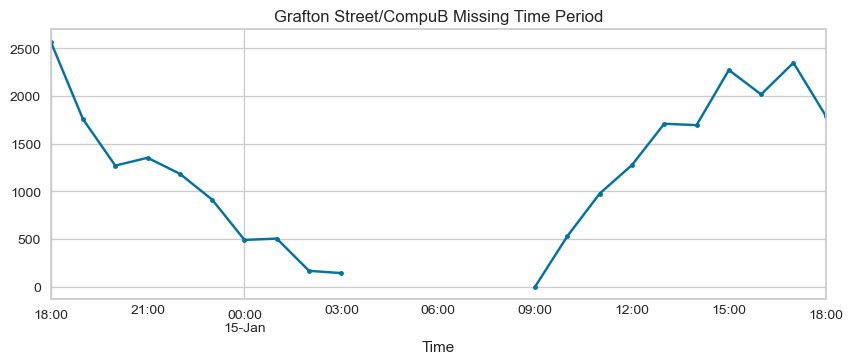

In [32]:
# select out Grafton Street/CompuB location 
graftonCompuB_footfall23_df = footfall23_df['Grafton Street/CompuB']

# plot the footfall over missing time period for visualisation
graftonCompuB_footfall23_df["2023-01-14 18:00:00":"2023-01-15 18:00:00"].plot(grid=True, marker=".", figsize=(10, 3.5))
plt.title('Grafton Street/CompuB Missing Time Period')
plt.show()

In [33]:
# Apply linear interpolation
footfall23_df['Grafton Street/CompuB'] = footfall23_df['Grafton Street/CompuB'].interpolate(method='linear', limit=5, limit_direction='forward')

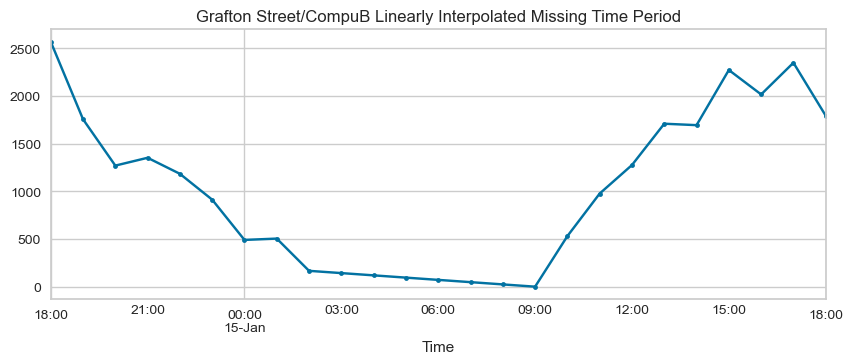

In [34]:
# show results after interpolation
graftonCompuB_footfall23_df = footfall23_df['Grafton Street/CompuB']
graftonCompuB_footfall23_df["2023-01-14 18:00:00":"2023-01-15 18:00:00"].plot(grid=True, marker=".", figsize=(10, 3.5))
plt.title('Grafton Street/CompuB Linearly Interpolated Missing Time Period')
plt.show()

**Observations**
- The data has gone through correct linear interpolation
- Imputation appears inline with expectations

### **2.4.3 Long Period NaNs**

The longer periods possess a greater challenge for imputation, given the cyclic and dynamic behaviour of footfall. Linear interpolation would not be appropriate over such a long time period.

#### **2.4.3.1 College Green/Bank Of Ireland Null Time Periods**

In [35]:
null_rows = footfall23_df[footfall23_df['College Green/Bank Of Ireland'].isnull()]

print("Amount of missing hour counts:", len(null_rows))
print("First count missing at:", null_rows.index[0])
print("Last count missing at:", null_rows.index[-1])

Amount of missing hour counts: 52
First count missing at: 2023-02-26 01:00:00
Last count missing at: 2023-08-29 02:00:00


In [36]:
# show complete missing dates
null_rows.index

DatetimeIndex(['2023-02-26 01:00:00', '2023-02-26 02:00:00',
               '2023-02-26 03:00:00', '2023-02-26 04:00:00',
               '2023-02-26 05:00:00', '2023-02-26 06:00:00',
               '2023-02-26 07:00:00', '2023-02-26 08:00:00',
               '2023-02-26 09:00:00', '2023-02-26 10:00:00',
               '2023-02-26 11:00:00', '2023-02-26 12:00:00',
               '2023-02-26 13:00:00', '2023-02-26 14:00:00',
               '2023-02-26 15:00:00', '2023-02-26 16:00:00',
               '2023-02-26 17:00:00', '2023-02-26 18:00:00',
               '2023-02-26 19:00:00', '2023-02-26 20:00:00',
               '2023-02-26 21:00:00', '2023-02-26 22:00:00',
               '2023-02-26 23:00:00', '2023-02-27 00:00:00',
               '2023-02-27 01:00:00', '2023-02-27 02:00:00',
               '2023-08-28 01:00:00', '2023-08-28 02:00:00',
               '2023-08-28 03:00:00', '2023-08-28 04:00:00',
               '2023-08-28 05:00:00', '2023-08-28 06:00:00',
               '2023-08-

**Observations**
- There are two null time periods
- Each period is over a full-day cycle

In [37]:
# isolate College Green/Bank Of Ireland
collegeGrBOI_footfall23_df = footfall23_df['College Green/Bank Of Ireland']

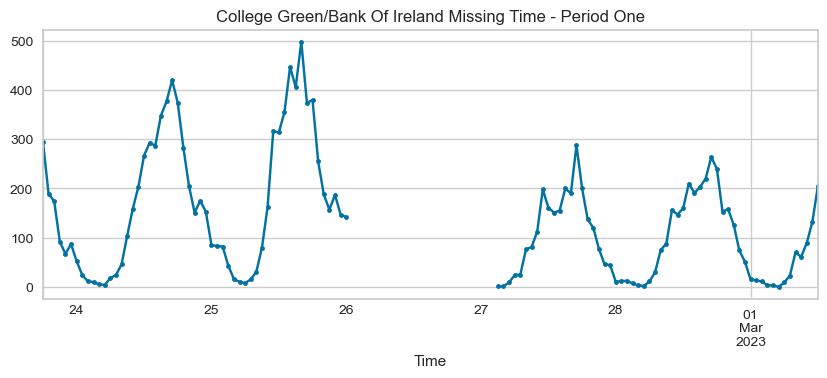

In [38]:
# plot time period One
collegeGrBOI_footfall23_df["2023-02-23 18:00:00'":"2023-03-01 12:00:00"].plot(grid=True, marker=".", figsize=(10, 3.5))
plt.title('College Green/Bank Of Ireland Missing Time - Period One')
plt.show()

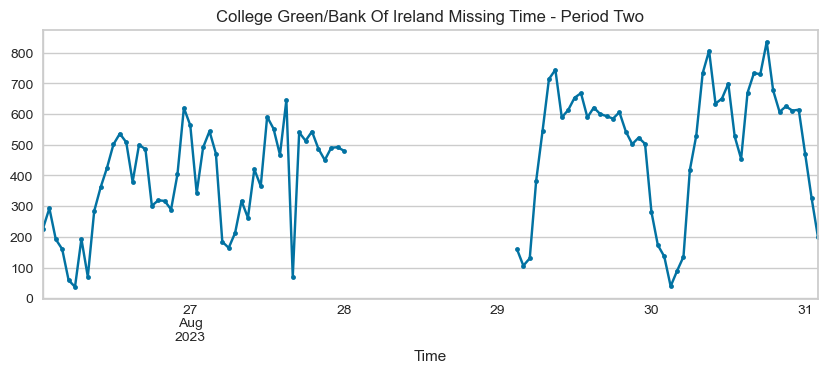

In [39]:
# plot time period Two
collegeGrBOI_footfall23_df["2023-08-26 01:00:00":"2023-08-31 02:00:00"].plot(grid=True, marker=".", figsize=(10, 3.5))
plt.title('College Green/Bank Of Ireland Missing Time - Period Two')
plt.show()

**Observations**
- Visually it is apparent linear interpolation would not reflect the data accurately
- The daily pattern of footfall makes evident its cyclic nature

#### **2.4.3.2 Grafton Street / Nassau Street / Suffolk Street Null Time Periods**

In [40]:
null_rows = footfall23_df[footfall23_df['Grafton Street / Nassau Street / Suffolk Street'].isnull()]

print("Amount of missing hour counts:", len(null_rows))
print("First count missing at:", null_rows.index[0])
print("Last count missing at:", null_rows.index[-1])

Amount of missing hour counts: 130
First count missing at: 2023-07-10 01:00:00
Last count missing at: 2023-10-12 02:00:00


In [41]:
# show complete missing dates
null_rows.index

DatetimeIndex(['2023-07-10 01:00:00', '2023-07-10 02:00:00',
               '2023-07-10 03:00:00', '2023-07-10 04:00:00',
               '2023-07-10 05:00:00', '2023-07-10 06:00:00',
               '2023-07-10 07:00:00', '2023-07-10 08:00:00',
               '2023-07-10 09:00:00', '2023-07-10 10:00:00',
               ...
               '2023-10-11 17:00:00', '2023-10-11 18:00:00',
               '2023-10-11 19:00:00', '2023-10-11 20:00:00',
               '2023-10-11 21:00:00', '2023-10-11 22:00:00',
               '2023-10-11 23:00:00', '2023-10-12 00:00:00',
               '2023-10-12 01:00:00', '2023-10-12 02:00:00'],
              dtype='datetime64[ns]', name='Time', length=130, freq=None)

**Observations**
- There are two null time periods
- Each period is over a full-day cycle

In [42]:
# isolate Grafton Street / Nassau Street / Suffolk Street
graftNassSuff_footfall23_df = footfall23_df['Grafton Street / Nassau Street / Suffolk Street']

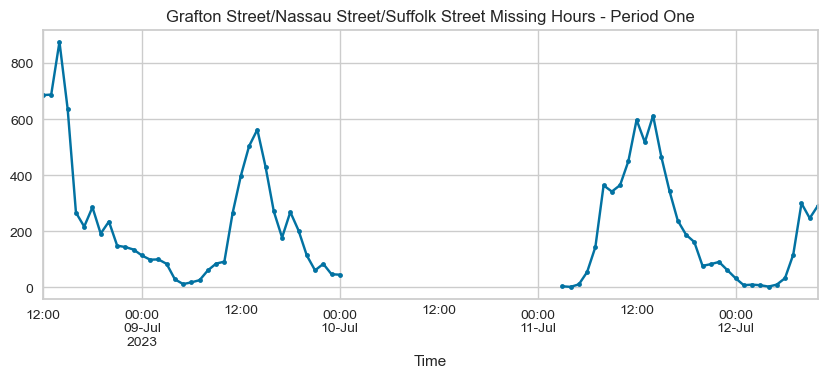

In [43]:
# plot Time period One
graftNassSuff_footfall23_df["2023-07-8 12:00:00":"2023-07-12 10:00:00"].plot(grid=True, marker=".", figsize=(10, 3.5))
plt.title('Grafton Street/Nassau Street/Suffolk Street Missing Hours - Period One')
plt.show()

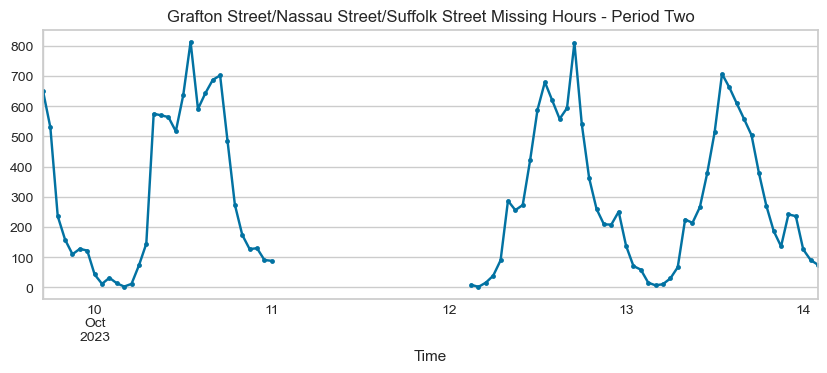

In [44]:
# plot Time period Two
graftNassSuff_footfall23_df["2023-10-09 17:00:00":"2023-10-14 02:00:00"].plot(grid=True, marker=".", figsize=(10, 3.5))
plt.title('Grafton Street/Nassau Street/Suffolk Street Missing Hours - Period Two')
plt.show()

**Observations**
- Again, visually it is apparent linear interpolation would not be suitable for imputation

### **2.4.4 Iterative Imputer**

[Iterative Imputer](https://scikit-learn.org/stable/modules/generated/sklearn.impute.IterativeImputer.html) is an experimental module from the sklearn library. As an estimator, it uses a multivariate strategy for the imputation of missing data. From [6.4.3. Multivariate feature imputation](https://scikit-learn.org/stable/modules/impute.html#iterative-imputer), the class:
> "...models each feature with missing values as a function of other features, and uses that estimate for imputation. It does so in an iterated round-robin fashion: at each step, a feature column is designated as output y and the other feature columns are treated as inputs X. A regressor is fit on (X, y) for known y. Then, the regressor is used to predict the missing values of y. This is done for each feature in an iterative fashion, and then is repeated for max_iter imputation rounds. The results of the final imputation round are returned."

Given the strong correlations between many features in this dataset, this module was deemed an adequate solution.

In [45]:
# make a copy of df to apply imputaion
footfall23_imp_df = footfall23_df

imputer = IterativeImputer(random_state=42)

# fit df and apply imputer
footfall23_imp = imputer.fit_transform(footfall23_imp_df)

# convert back to df
footfall23_imp_df = pd.DataFrame(footfall23_imp, columns=footfall23_imp_df.columns, index=footfall23_imp_df.index)

# set any negatives values from imputation to 0
footfall23_imp_df = footfall23_imp_df.clip(lower=0)

In [46]:
# are there any NaNs left?
footfall23_imp_df.isnull().sum()

Aston Quay/Fitzgeralds                             0
Baggot st lower/Wilton tce inbound                 0
Baggot st upper/Mespil rd/Bank                     0
Capel st/Mary street                               0
College Green/Bank Of Ireland                      0
College st/Westmoreland st                         0
D'olier st/Burgh Quay                              0
Dame Street/Londis                                 0
Grafton st/Monsoon                                 0
Grafton Street / Nassau Street / Suffolk Street    0
Grafton Street/CompuB                              0
Grand Canal st upp/Clanwilliam place               0
Grand Canal st upp/Clanwilliam place/Google        0
Liffey st/Halfpenny Bridge                         0
Mary st/Jervis st                                  0
North Wall Quay/Samuel Beckett bridge East         0
North Wall Quay/Samuel Beckett bridge West         0
O'Connell st/Princes st North                      0
Phibsborough Rd/Enniskerry Road               

#### **2.4.4.1 Visual Comparison of Missing Time Period with Imputed data**

As we can see from above, Iterative Imputer has sucessfully filled the NaN's. The fidelity of the imputation however, and it's ability to reflect real world data is difficult to measure. A visual comparison will act both as an insight and validation process to this approximation.

In [47]:
# slice footfall23_imp_df 
collegeGrBOI_footfall23_imp_df  = footfall23_imp_df['College Green/Bank Of Ireland']
graftNassSuff_footfall23_imp_df  = footfall23_imp_df['Grafton Street / Nassau Street / Suffolk Street']

#### **2.4.4.2 Imputed College Green/Bank Of Ireland** 

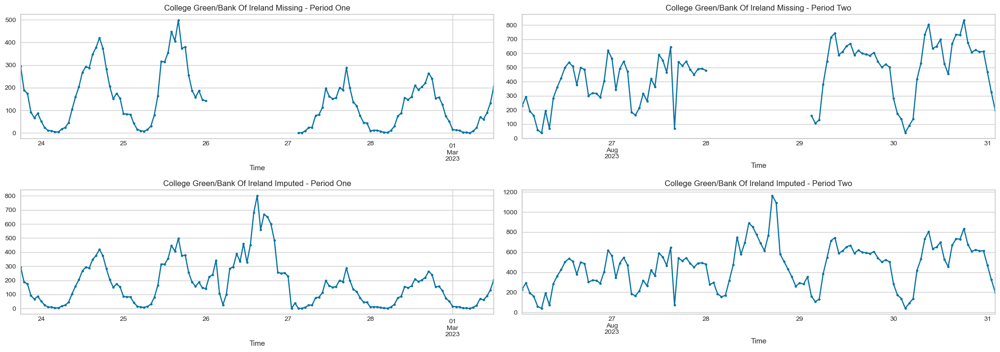

In [48]:
fig, axs = plt.subplots(2, 2, figsize=(21, 7.5))

collegeGrBOI_footfall23_df["2023-02-23 18:00:00":"2023-03-01 12:00:00"].plot(ax=axs[0,0], grid=True, marker=".", title='College Green/Bank Of Ireland Missing - Period One')
collegeGrBOI_footfall23_imp_df["2023-02-23 18:00:00":"2023-03-01 12:00:00"].plot(ax=axs[1,0], grid=True, marker=".", title='College Green/Bank Of Ireland Imputed - Period One')

collegeGrBOI_footfall23_df["2023-08-26 01:00:00":"2023-08-31 02:00:00"].plot(ax=axs[0,1], grid=True, marker=".", title='College Green/Bank Of Ireland Missing - Period Two')
collegeGrBOI_footfall23_imp_df["2023-08-26 01:00:00":"2023-08-31 02:00:00"].plot(ax=axs[1,1], grid=True, marker=".", title='College Green/Bank Of Ireland Imputed - Period Two')

plt.tight_layout()
plt.show()

**Observations**
- The imputed data reflects the cyclical nature of the surrounding and general footfall
- The imputed data has a greater magnitude than the typical surrounding footfall

#### **2.4.4.3 Imputed Grafton Street / Nassau Street / Suffolk Street**

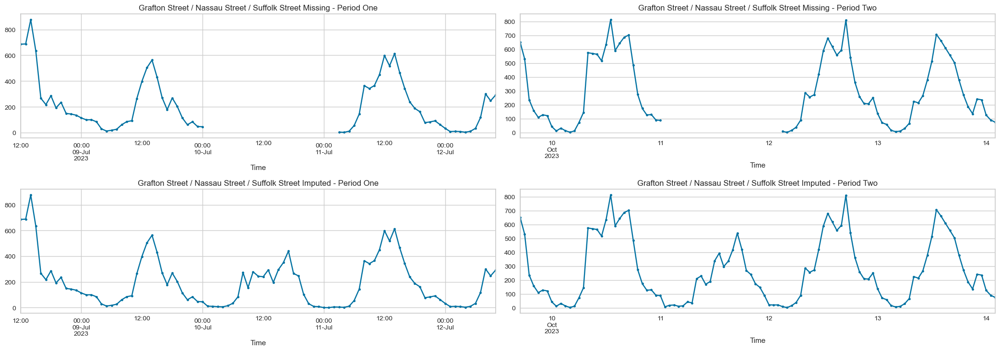

In [49]:
fig, axs = plt.subplots(2, 2, figsize=(21, 7.5))

graftNassSuff_footfall23_df["2023-07-08 12:00:00":"2023-07-12 10:00:00"].plot(ax=axs[0,0], grid=True, marker=".", title='Grafton Street / Nassau Street / Suffolk Street Missing - Period One')
graftNassSuff_footfall23_imp_df["2023-07-08 12:00:00":"2023-07-12 10:00:00"].plot(ax=axs[1,0], grid=True, marker=".", title='Grafton Street / Nassau Street / Suffolk Street Imputed - Period One')

graftNassSuff_footfall23_df["2023-10-09 17:00:00":"2023-10-14 02:00:00"].plot(ax=axs[0,1], grid=True, marker=".", title='Grafton Street / Nassau Street / Suffolk Street Missing - Period Two')
graftNassSuff_footfall23_imp_df["2023-10-09 17:00:00":"2023-10-14 02:00:00"].plot(ax=axs[1,1], grid=True, marker=".", title='Grafton Street / Nassau Street / Suffolk Street Imputed - Period Two')

plt.tight_layout()
plt.show()

**Observations**
- The imputed data reflects the cyclical nature of the surrounding and general footfall
- The imputed data is of a similar magnitude to the typical surrounding footfall

**Interpolation Notes**

There are several interpolation strategies, including linear, polynomial, and spline, with each having an application in specific situations. Challenges include overfitting, unreliable estimates, and loss of data fidelity. The methods in this section were chosen to accurately reflect the characteristics of the data, and for this project, adequately reflect a desired level of accuracy.

In [50]:
# set and continue analysis with imputed data
footfall23_df = footfall23_imp_df

## **2.5 Counter Locations**

In [51]:
# create counter location DataFrame
counterLocations_df = pd.read_csv('DCCcounterlocations.csv')

# Inspect location df
counterLocations_df.head(4)

,_id,Counter Locations,Eco-Visio Oupput,Latitude,Longitude,Setup Date,User Type
0,1,Henry Street,Henry Street/Coles Lane/Dunnes,53.34973,-6.26090,2013-07-16T00:00:00,Pedestrians
1,2,O'Connell St Outside Clerys,O'Connell st/Princes st North,53.34902,-6.26005,2011-07-06T00:00:00,Pedestrians
2,3,Mary Street,Mary st/Jervis st,53.34877,-6.26674,2011-09-06T00:00:00,Pedestrians
3,4,Capel Street,Capel st/Mary street,53.34842,-6.26918,2011-01-08T00:00:00,Pedestrians


**Observations**
- There are several columns irrelevant to the analysis
- Eco-Visio Oupput column values align with location names in the 2023 footfall dataset
- Locations are unordered


In [52]:
#remove unimportant columns
counterLocations_df = counterLocations_df.loc[:,["Eco-Visio Oupput", "Latitude","Longitude"]]
#rename Eco-Visio Oupput as Counter Location
counterLocations_df = counterLocations_df.rename(columns={"Eco-Visio Oupput": "Counter Location"})

# sort alphabetically
counterLocations_df.sort_values(by='Counter Location', inplace=True)
# reset index
counterLocations_df.reset_index(drop=True, inplace=True)

In [53]:
counterLocations_df.head(4)

,Counter Location,Latitude,Longitude
0,Aston Quay/Fitzgeralds,53.34662,-6.259820
1,Bachelors walk/Bachelors way,53.34720,-6.260863
2,Baggot st lower/Wilton tce inbound,53.33448,-6.245770
3,Baggot st upper/Mespil rd/Bank,53.33385,-6.244690


In [54]:
# remove streets previously discarded ('~' works as logical not here)
counterLocations_df = counterLocations_df[~counterLocations_df['Counter Location'].isin(remove_streets)]
# reset index
counterLocations_df.reset_index(drop=True, inplace=True)

In [55]:
counterLocations_df.head(4)

,Counter Location,Latitude,Longitude
0,Aston Quay/Fitzgeralds,53.34662,-6.25982
1,Baggot st lower/Wilton tce inbound,53.33448,-6.24577
2,Baggot st upper/Mespil rd/Bank,53.33385,-6.24469
3,Capel st/Mary street,53.34842,-6.26918


### **2.5.1 Match Counter Locations to Footfall Data**

Matching the locations will allow for easier manipulation of datasets in the same context, and ensuring we have geospatial information for each street location analysed.

In [56]:
# Do the streets match?
counterLocations_df['Counter Location'] == list(footfall23_df)

0      True
1      True
2      True
3      True
4      True
5      True
6      True
7      True
8     False
9     False
10    False
11     True
12     True
13     True
14     True
15     True
16     True
17     True
18     True
19     True
20     True
Name: Counter Location, dtype: bool

In [57]:
# create df to investigate mismatch
location_comparison = pd.DataFrame({'Counter Location': counterLocations_df['Counter Location'], 'Footfall23 Location': list(footfall23_df)})
location_comparison

,Counter Location,Footfall23 Location
0,Aston Quay/Fitzgeralds,Aston Quay/Fitzgeralds
1,Baggot st lower/Wilton tce inbound,Baggot st lower/Wilton tce inbound
2,Baggot st upper/Mespil rd/Bank,Baggot st upper/Mespil rd/Bank
3,Capel st/Mary street,Capel st/Mary street
4,College Green/Bank Of Ireland,College Green/Bank Of Ireland
5,College st/Westmoreland st,College st/Westmoreland st
6,D'olier st/Burgh Quay,D'olier st/Burgh Quay
7,Dame Street/Londis,Dame Street/Londis
8,Grafton Street / Nassau Street / Suffolk Street,Grafton st/Monsoon
9,Grafton Street/CompuB,Grafton Street / Nassau Street / Suffolk Street


**Observations**
- The locations are not mismatched, both contain the same location string values
- The locations are misaligned

In [58]:
# re order footfall df alphabetically
alpha_columns = sorted(footfall23_df.columns)

footfall23_df = footfall23_df[alpha_columns]

In [59]:
# Do the streets match?
counterLocations_df['Counter Location'] == list(footfall23_df)

0     True
1     True
2     True
3     True
4     True
5     True
6     True
7     True
8     True
9     True
10    True
11    True
12    True
13    True
14    True
15    True
16    True
17    True
18    True
19    True
20    True
Name: Counter Location, dtype: bool

In [60]:
location_comparison = pd.DataFrame({'Counter Location': counterLocations_df['Counter Location'], 'Footfall23 Location': list(footfall23_df)})
location_comparison

,Counter Location,Footfall23 Location
0,Aston Quay/Fitzgeralds,Aston Quay/Fitzgeralds
1,Baggot st lower/Wilton tce inbound,Baggot st lower/Wilton tce inbound
2,Baggot st upper/Mespil rd/Bank,Baggot st upper/Mespil rd/Bank
3,Capel st/Mary street,Capel st/Mary street
4,College Green/Bank Of Ireland,College Green/Bank Of Ireland
5,College st/Westmoreland st,College st/Westmoreland st
6,D'olier st/Burgh Quay,D'olier st/Burgh Quay
7,Dame Street/Londis,Dame Street/Londis
8,Grafton Street / Nassau Street / Suffolk Street,Grafton Street / Nassau Street / Suffolk Street
9,Grafton Street/CompuB,Grafton Street/CompuB


**Observations**
- The locations are now matched and aligned

## **2.6 Footfall over 2023: Post-Processed**

In [61]:
footfall23_df.describe(include='all')

,Aston Quay/Fitzgeralds,Baggot st lower/Wilton tce inbound,Baggot st upper/Mespil rd/Bank,Capel st/Mary street,College Green/Bank Of Ireland,College st/Westmoreland st,D'olier st/Burgh Quay,Dame Street/Londis,Grafton Street / Nassau Street / Suffolk Street,Grafton Street/CompuB,Grafton st/Monsoon,Grand Canal st upp/Clanwilliam place,Grand Canal st upp/Clanwilliam place/Google,Liffey st/Halfpenny Bridge,Mary st/Jervis st,North Wall Quay/Samuel Beckett bridge East,North Wall Quay/Samuel Beckett bridge West,O'Connell st/Princes st North,Phibsborough Rd/Enniskerry Road,Richmond st south/Portabello Harbour inbound,Richmond st south/Portabello Harbour outbound
count,8760.000000,8760.000000,8760.000000,8760.000000,8760.000000,8760.000000,8760.000000,8760.000000,8760.000000,8760.000000,8760.000000,8760.000000,8760.000000,8760.000000,8760.000000,8760.000000,8760.000000,8760.000000,8760.000000,8760.000000,8760.000000
mean,3371.399201,124.528139,4159.611530,1235.809989,545.018518,602.348402,941.566153,449.768950,249.639912,1885.224372,1714.492694,157.275000,86.394235,5997.554224,447.060388,2121.690297,1579.664326,710.015011,95.784018,753.001712,226.702169
std,1808.875103,135.573687,3044.534866,1037.067112,629.966588,462.072361,545.507856,345.472989,222.603041,1657.536140,1317.813822,169.235451,92.335436,2151.464240,452.887798,1745.803333,1686.131026,499.227191,70.979531,606.438038,140.035867
min,27.000000,0.000000,4.000000,4.000000,0.000000,1.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,183.000000,0.000000,0.000000,0.000000,3.000000,0.000000,1.000000,0.000000
25%,1900.750000,16.000000,1310.500000,387.000000,117.000000,168.000000,514.000000,145.000000,58.750000,456.750000,488.000000,20.000000,14.000000,4651.000000,44.000000,591.750000,197.750000,244.000000,27.000000,235.000000,106.750000
50%,3685.000000,87.000000,4038.500000,1017.500000,374.000000,537.000000,1025.000000,407.000000,190.000000,1425.500000,1424.500000,103.000000,73.000000,5846.000000,274.000000,1768.500000,944.500000,703.000000,98.000000,655.000000,228.000000
75%,4583.000000,187.000000,6225.000000,1834.000000,687.000000,995.000000,1304.000000,678.000000,397.000000,3004.250000,2904.500000,232.000000,124.000000,6779.250000,811.000000,3277.250000,2553.000000,1072.000000,149.000000,1112.000000,325.000000
max,10658.000000,1755.000000,15100.000000,9217.000000,3919.000000,3372.000000,3632.000000,1792.000000,1976.000000,8750.000000,5387.000000,1493.000000,1492.000000,15857.000000,2439.000000,10124.000000,9718.000000,2625.000000,496.000000,4436.000000,895.000000


**Observations**
- The mean varies noticeably between locations; a low of 95 for "Phibsborough Rd/Enniskerry Road", and a high of 4,159 for "Baggot st upper/Mespil rd/Bank"
- The standard deviation has a lot of variability across locations; "Baggot st upper/Mespil rd/Bank" has a std of 3044, highlighting a wide range of footfall, whereas "Baggot st lower/Wilton tce inbound" has an std of 136, signifying a quite small range of footfall
- Minimum values are quite consistent, although notably 'Liffey st/Halfpenny Bridge' has a minimum of 183 hourly footfall across the whole year
- The maximum values are generally a lot higher than the 75% upper quartile, for example at "College Green/Bank Of Ireland" the max is 3919 compared to an iq3 of 687. This shows that most of the time, the counts are moderate, but with surges in activity
- Outliers in activity may be useful in predicting events like St. Patrick’s Day

## **2.7 Average Day of Footfall 2023**

Looking at the average day of footfall in 2023 can give us insight into the characteristics of a normal day, as well as more importantly allow us to compare and contrast with periods of high footfall, including St. Patrick's Day.

In [62]:
averageday23_df = footfall23_df.groupby(footfall23_df.index.hour).mean()

In [63]:
averageday23_df.head()

,Aston Quay/Fitzgeralds,Baggot st lower/Wilton tce inbound,Baggot st upper/Mespil rd/Bank,Capel st/Mary street,College Green/Bank Of Ireland,College st/Westmoreland st,D'olier st/Burgh Quay,Dame Street/Londis,Grafton Street / Nassau Street / Suffolk Street,Grafton Street/CompuB,Grafton st/Monsoon,Grand Canal st upp/Clanwilliam place,Grand Canal st upp/Clanwilliam place/Google,Liffey st/Halfpenny Bridge,Mary st/Jervis st,North Wall Quay/Samuel Beckett bridge East,North Wall Quay/Samuel Beckett bridge West,O'Connell st/Princes st North,Phibsborough Rd/Enniskerry Road,Richmond st south/Portabello Harbour inbound,Richmond st south/Portabello Harbour outbound
Time,,,,,,,,,,,,,,,,,,,,,
0,2125.057534,32.561644,2246.394521,787.695890,330.242058,179.980822,577.282192,219.550685,82.250901,721.797260,99.846575,21.739726,2.243836,5495.410959,50.093151,789.293151,115.504110,248.178082,32.726027,769.145205,153.997260
1,1569.590659,14.489011,783.956044,557.744505,235.706526,109.151099,384.538462,153.950549,56.173669,468.958791,608.975275,12.453297,9.642857,4791.706044,26.989011,455.228022,145.936813,144.673077,20.618132,221.060440,159.049451
2,1246.142077,9.438525,831.265027,442.903005,199.118397,84.046448,296.006831,133.092896,47.806224,347.370219,582.622951,7.459016,5.479508,4949.486339,17.571038,283.877049,79.356557,123.493169,8.822404,392.256831,80.855191
3,809.810959,7.542466,593.572603,344.619178,177.232140,60.701370,198.336986,101.652055,36.957223,243.274755,522.816438,7.087671,4.345205,6629.643836,13.638356,238.805479,64.334247,87.641096,11.860274,285.243836,92.194521
4,526.071233,5.079452,424.065753,333.671233,111.734323,23.723288,103.736986,66.684932,11.757344,113.954990,282.630137,4.550685,2.304110,6001.569863,11.720548,223.657534,55.441096,44.687671,6.238356,146.295890,33.326027


In [64]:
averageday23_df.describe()

,Aston Quay/Fitzgeralds,Baggot st lower/Wilton tce inbound,Baggot st upper/Mespil rd/Bank,Capel st/Mary street,College Green/Bank Of Ireland,College st/Westmoreland st,D'olier st/Burgh Quay,Dame Street/Londis,Grafton Street / Nassau Street / Suffolk Street,Grafton Street/CompuB,Grafton st/Monsoon,Grand Canal st upp/Clanwilliam place,Grand Canal st upp/Clanwilliam place/Google,Liffey st/Halfpenny Bridge,Mary st/Jervis st,North Wall Quay/Samuel Beckett bridge East,North Wall Quay/Samuel Beckett bridge West,O'Connell st/Princes st North,Phibsborough Rd/Enniskerry Road,Richmond st south/Portabello Harbour inbound,Richmond st south/Portabello Harbour outbound
count,24.000000,24.000000,24.000000,24.000000,24.000000,24.000000,24.000000,24.000000,24.000000,24.000000,24.000000,24.000000,24.000000,24.000000,24.000000,24.000000,24.000000,24.000000,24.000000,24.000000,24.000000
mean,3371.436124,124.528716,4159.606129,1235.823098,545.022695,602.351268,941.576259,449.771331,249.640868,1885.238252,1714.495702,157.275570,86.394710,5997.536212,447.061463,2121.709857,1579.671927,710.017429,95.785365,752.982169,226.711095
std,1508.980229,92.922358,2423.755588,737.360602,282.212748,422.159935,432.477160,249.496278,193.828846,1269.359707,1239.617504,130.575088,64.261537,601.583738,425.412895,1293.611707,1199.791466,444.866385,64.083854,335.832263,116.768025
min,526.071233,5.079452,407.821918,269.394521,80.087980,23.723288,103.736986,57.865753,11.757344,99.917417,99.846575,4.550685,2.243836,4791.706044,11.720548,223.657534,55.441096,44.687671,6.238356,132.304110,26.312329
25%,2037.982877,44.631507,1874.850000,529.034130,306.608175,180.264384,569.817123,207.091781,75.731593,672.628865,602.387194,36.690411,29.525783,5689.704110,49.847945,781.004795,304.877354,296.317808,31.847260,445.301879,151.021233
50%,3992.175342,122.410959,5082.678082,1214.713699,570.252194,606.930137,1169.524658,470.589041,217.301132,2011.019178,1427.790411,142.619178,88.272603,6201.154795,283.594521,2355.472603,1649.387671,773.884932,101.012329,895.316438,229.004110
75%,4598.529452,188.769178,6342.858219,1963.768493,772.918029,1002.768493,1270.328082,670.186301,419.673408,2989.788356,2949.039041,260.410274,134.073973,6395.378082,903.900000,3250.330822,2707.770548,1114.690411,151.103425,963.837671,300.463699
max,4780.915068,323.153425,7228.095890,2357.572603,1005.931402,1223.276712,1344.389041,808.147945,613.793718,4119.586301,3691.917808,423.323288,215.813699,6746.871233,1117.493151,3694.293151,3278.035616,1414.627397,197.027397,1150.701370,440.038356


## **2.8 St. Patrick's Day Footfall Data**

There are several years of footfall data available through SmartDublin. By analysing as much useful data about the annual period of St. Patrick's Day, there will be more data points to contribute to a larger sample size. This allows for greater statistical significance, more effective detection of outliers, and a larger dataset to train machine learning models. It will also allow for comparing St. Patricks Day year to year. The years 2020 and 2021 have been excluded due to the effect of lockdown restrictions during that period.

### **2.8.1 St. Patrick's Day 2023**

In [65]:
# use of boolean logic to select dates containing March AND 17th
patrick23_df = footfall23_df[(footfall23_df.index.month == 3) & (footfall23_df.index.day == 17)]
patrick23_df.head(4)

,Aston Quay/Fitzgeralds,Baggot st lower/Wilton tce inbound,Baggot st upper/Mespil rd/Bank,Capel st/Mary street,College Green/Bank Of Ireland,College st/Westmoreland st,D'olier st/Burgh Quay,Dame Street/Londis,Grafton Street / Nassau Street / Suffolk Street,Grafton Street/CompuB,Grafton st/Monsoon,Grand Canal st upp/Clanwilliam place,Grand Canal st upp/Clanwilliam place/Google,Liffey st/Halfpenny Bridge,Mary st/Jervis st,North Wall Quay/Samuel Beckett bridge East,North Wall Quay/Samuel Beckett bridge West,O'Connell st/Princes st North,Phibsborough Rd/Enniskerry Road,Richmond st south/Portabello Harbour inbound,Richmond st south/Portabello Harbour outbound
Time,,,,,,,,,,,,,,,,,,,,,
2023-03-17 00:00:00,837.0,67.0,5469.0,1195.0,157.0,414.0,1150.0,522.0,191.0,373.0,186.0,39.0,3.0,5363.0,102.0,842.0,66.0,557.0,56.0,845.0,250.0
2023-03-17 01:00:00,2178.0,50.0,2292.0,949.0,97.0,183.0,890.0,295.0,124.0,340.0,1191.0,26.0,36.0,6185.0,55.0,470.0,117.0,307.0,31.0,493.0,273.0
2023-03-17 02:00:00,1719.0,10.0,1835.0,638.0,116.0,182.0,943.0,399.0,108.0,337.0,1863.0,12.0,8.0,5500.0,22.0,652.0,164.0,251.0,12.0,403.0,127.0
2023-03-17 03:00:00,1422.0,7.0,1842.0,100.0,84.0,124.0,664.0,231.0,70.0,200.0,1219.0,17.0,17.0,12094.0,17.0,314.0,148.0,226.0,20.0,397.0,189.0


In [66]:
patrick23_df.describe()

,Aston Quay/Fitzgeralds,Baggot st lower/Wilton tce inbound,Baggot st upper/Mespil rd/Bank,Capel st/Mary street,College Green/Bank Of Ireland,College st/Westmoreland st,D'olier st/Burgh Quay,Dame Street/Londis,Grafton Street / Nassau Street / Suffolk Street,Grafton Street/CompuB,Grafton st/Monsoon,Grand Canal st upp/Clanwilliam place,Grand Canal st upp/Clanwilliam place/Google,Liffey st/Halfpenny Bridge,Mary st/Jervis st,North Wall Quay/Samuel Beckett bridge East,North Wall Quay/Samuel Beckett bridge West,O'Connell st/Princes st North,Phibsborough Rd/Enniskerry Road,Richmond st south/Portabello Harbour inbound,Richmond st south/Portabello Harbour outbound
count,24.000000,24.000000,24.000000,24.000000,24.000000,24.000000,24.000000,24.000000,24.000000,24.000000,24.000000,24.000000,24.000000,24.000000,24.000000,24.000000,24.000000,24.000000,24.000000,24.000000,24.000000
mean,2884.750000,119.250000,4531.791667,1443.750000,265.458333,1105.916667,1502.083333,781.583333,705.833333,627.000000,2632.958333,89.541667,70.375000,5377.375000,437.041667,1236.875000,797.541667,1004.666667,135.125000,826.375000,379.333333
std,1552.412799,80.859648,2441.195697,885.262243,252.048128,981.561397,920.765084,590.825430,625.765039,418.492429,1486.891519,66.260999,48.393148,2247.806502,460.069511,810.454371,611.330977,652.551958,102.601938,402.460672,233.978384
min,662.000000,5.000000,238.000000,100.000000,1.000000,49.000000,243.000000,95.000000,25.000000,21.000000,186.000000,4.000000,2.000000,2755.000000,13.000000,142.000000,26.000000,87.000000,6.000000,169.000000,28.000000
25%,1503.750000,40.500000,2187.000000,714.500000,26.000000,252.000000,833.500000,240.750000,174.250000,280.250000,1282.000000,32.750000,27.750000,4367.500000,51.500000,606.500000,160.000000,337.750000,33.250000,470.500000,177.000000
50%,2612.000000,139.000000,5438.000000,1384.500000,181.000000,905.000000,1467.000000,624.500000,490.500000,695.500000,2903.500000,77.500000,69.000000,5003.000000,276.500000,1092.500000,757.000000,1002.500000,135.500000,879.500000,424.000000
75%,4449.750000,185.750000,6479.250000,2191.000000,480.500000,1581.000000,1804.250000,1359.000000,1133.000000,957.500000,3751.000000,134.250000,106.250000,5397.250000,658.250000,1800.000000,1211.250000,1713.000000,221.500000,1028.750000,522.000000
max,4924.000000,253.000000,8880.000000,2795.000000,685.000000,3372.000000,3632.000000,1765.000000,1976.000000,1208.000000,5158.000000,231.000000,151.000000,12166.000000,1588.000000,2833.000000,2080.000000,1940.000000,346.000000,1602.000000,895.000000


**Observations**
- The mean and median vary remarkably across different streets; 'College Green/Bank Of Ireland' has a low median of 181, compared to a median of 2612 on 'Aston Quay/Fitzgeralds'
- There are maximum counts outside the 75% on every location, with 'Liffey st/Halfpenny Bridge' having a max of 12166, however with a notably low min of 2247
- The  upper quartile of 'Aston Quay/Fitzgeralds' is 4449, indicating that 25% of the time, the count was above this level

**Comparison: Average Day vs. St. Patricks Day 2023**

There are some unexpected observations when comparing both time periods. If we take a look at 'Aston Quay/Fitzgeralds', the Average mean count is 3371, and the St. Patrick's Day mean count is 2884, with a similar drop when comparing the median, 3992 to 2612 respectively. By the counts, this would suggest footfall on St. Patrick's Day is lower overall at this location. Similar observations include locations 'College Green/Bank Of Ireland', 'Grafton Street/CompuB', 'Grand Canal st upp/Clanwilliam place', and both 'North Wall Quay' Locations. <br>
Looking at the 75%, we can see there are some increases on St. Patricks Day compared to the rest of the year, including 'College st/Westmoreland st', where there is an increase from 1002 to 1581, and "Grafton Street / Nassau Street / Suffolk Street", where there is an increase from 419 to 1133.

### **2.8.2 St. Patricks Day 2022**

In [67]:
footfall22_df = pd.read_csv('DCCpfc2022.csv')

In [68]:
# remove IN OUT columns
footfall22_df = remove_IN_OUT(footfall22_df)

In [69]:
# reset index
footfall22_df['Time'] = pd.to_datetime(footfall22_df['Time'], format='%d/%m/%Y %H:%M') # Convert to dateTime format
footfall22_df.set_index('Time', inplace=True) # Set index to Time

In [70]:
# take out st pats day
patrick22_df = footfall22_df[(footfall22_df.index.month == 3) & (footfall23_df.index.day == 17)]
patrick22_df.head(4)

,Aston Quay/Fitzgeralds,Bachelors walk/Bachelors way,Baggot st lower/Wilton tce inbound,Baggot st upper/Mespil rd/Bank,Capel st/Mary street,College Green/Bank Of Ireland,College Green/Church Lane,College st/Westmoreland st,D'olier st/Burgh Quay,Dame Street/Londis,Dawson Street/Molesworth,Grafton st/Monsoon Pedestrian,Grafton Street / Nassau Street / Suffolk Street,Grafton Street/CompuB,Grand Canal st upp/Clanwilliam place,Grand Canal st upp/Clanwilliam place/Google,Henry Street/Coles Lane/Dunnes,Liffey st/Halfpenny Bridge,Mary st/Jervis st,Newcomen Bridge/Charleville mall inbound,Newcomen Bridge/Charleville mall outbound,North Wall Quay/Samuel Beckett bridge East,North Wall Quay/Samuel Beckett bridge West,O'Connell St/Parnell St/AIB,O'Connell St/Pennys Pedestrian,O'Connell st/Princes st North,Phibsborough Rd/Enniskerry Road,Phibsborough Rd/Munster St,Richmond st south/Portabello Harbour inbound,Richmond st south/Portabello Harbour outbound,Talbot st/Guineys,Talbot st/Murrays Pharmacy,Westmoreland Street East/Fleet street,Westmoreland Street West/Carrolls
Time,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
2022-03-17 00:00:00,NaN,675.0,120.0,206.0,1230.0,580.0,397.0,282.0,765.0,756.0,217.0,NaN,181.0,607.0,51.0,2.0,329.0,NaN,55.0,4212.0,7240.0,1595.0,168.0,194.0,NaN,488.0,70.0,0.0,368.0,270.0,1902.0,3786.0,374.0,1296.0
2022-03-17 01:00:00,NaN,410.0,41.0,61.0,412.0,478.0,304.0,189.0,464.0,733.0,127.0,NaN,177.0,546.0,20.0,19.0,282.0,NaN,29.0,4669.0,2631.0,1152.0,222.0,144.0,NaN,354.0,55.0,0.0,78.0,271.0,1544.0,3865.0,185.0,992.0
2022-03-17 02:00:00,NaN,424.0,53.0,79.0,540.0,488.0,301.0,157.0,729.0,943.0,155.0,NaN,119.0,606.0,21.0,18.0,120.0,NaN,26.0,3223.0,4069.0,497.0,81.0,137.0,NaN,307.0,34.0,0.0,204.0,88.0,1987.0,4041.0,267.0,657.0
2022-03-17 03:00:00,NaN,486.0,66.0,46.0,385.0,658.0,234.0,137.0,440.0,772.0,55.0,NaN,112.0,320.0,21.0,8.0,411.0,NaN,16.0,1937.0,12678.0,1718.0,580.0,96.0,NaN,276.0,47.0,0.0,223.0,245.0,1666.0,2418.0,214.0,688.0


In [71]:
# rename column to match
patrick22_df = patrick22_df.rename(columns={"Grafton st/Monsoon Pedestrian": "Grafton st/Monsoon"})

In [72]:
# keep interested streets/columns
patrick22_df = patrick22_df[counterLocations_df['Counter Location']]
patrick22_df.head(4)

,Aston Quay/Fitzgeralds,Baggot st lower/Wilton tce inbound,Baggot st upper/Mespil rd/Bank,Capel st/Mary street,College Green/Bank Of Ireland,College st/Westmoreland st,D'olier st/Burgh Quay,Dame Street/Londis,Grafton Street / Nassau Street / Suffolk Street,Grafton Street/CompuB,Grafton st/Monsoon,Grand Canal st upp/Clanwilliam place,Grand Canal st upp/Clanwilliam place/Google,Liffey st/Halfpenny Bridge,Mary st/Jervis st,North Wall Quay/Samuel Beckett bridge East,North Wall Quay/Samuel Beckett bridge West,O'Connell st/Princes st North,Phibsborough Rd/Enniskerry Road,Richmond st south/Portabello Harbour inbound,Richmond st south/Portabello Harbour outbound
Time,,,,,,,,,,,,,,,,,,,,,
2022-03-17 00:00:00,NaN,120.0,206.0,1230.0,580.0,282.0,765.0,756.0,181.0,607.0,NaN,51.0,2.0,NaN,55.0,1595.0,168.0,488.0,70.0,368.0,270.0
2022-03-17 01:00:00,NaN,41.0,61.0,412.0,478.0,189.0,464.0,733.0,177.0,546.0,NaN,20.0,19.0,NaN,29.0,1152.0,222.0,354.0,55.0,78.0,271.0
2022-03-17 02:00:00,NaN,53.0,79.0,540.0,488.0,157.0,729.0,943.0,119.0,606.0,NaN,21.0,18.0,NaN,26.0,497.0,81.0,307.0,34.0,204.0,88.0
2022-03-17 03:00:00,NaN,66.0,46.0,385.0,658.0,137.0,440.0,772.0,112.0,320.0,NaN,21.0,8.0,NaN,16.0,1718.0,580.0,276.0,47.0,223.0,245.0


In [73]:
# Check values arent null
patrick22_df.isnull().sum()

Aston Quay/Fitzgeralds                             24
Baggot st lower/Wilton tce inbound                  0
Baggot st upper/Mespil rd/Bank                      0
Capel st/Mary street                                0
College Green/Bank Of Ireland                       0
College st/Westmoreland st                          0
D'olier st/Burgh Quay                               0
Dame Street/Londis                                  0
Grafton Street / Nassau Street / Suffolk Street     0
Grafton Street/CompuB                               0
Grafton st/Monsoon                                 24
Grand Canal st upp/Clanwilliam place                0
Grand Canal st upp/Clanwilliam place/Google         0
Liffey st/Halfpenny Bridge                         24
Mary st/Jervis st                                   0
North Wall Quay/Samuel Beckett bridge East          0
North Wall Quay/Samuel Beckett bridge West          0
O'Connell st/Princes st North                       0
Phibsborough Rd/Enniskerry R

In [74]:
# are both df in same format?
list(patrick22_df) == list(patrick23_df)

True

In [75]:
patrick22_df.describe(include = 'all')

,Aston Quay/Fitzgeralds,Baggot st lower/Wilton tce inbound,Baggot st upper/Mespil rd/Bank,Capel st/Mary street,College Green/Bank Of Ireland,College st/Westmoreland st,D'olier st/Burgh Quay,Dame Street/Londis,Grafton Street / Nassau Street / Suffolk Street,Grafton Street/CompuB,Grafton st/Monsoon,Grand Canal st upp/Clanwilliam place,Grand Canal st upp/Clanwilliam place/Google,Liffey st/Halfpenny Bridge,Mary st/Jervis st,North Wall Quay/Samuel Beckett bridge East,North Wall Quay/Samuel Beckett bridge West,O'Connell st/Princes st North,Phibsborough Rd/Enniskerry Road,Richmond st south/Portabello Harbour inbound,Richmond st south/Portabello Harbour outbound
count,0.0,24.000000,24.000000,24.000000,24.000000,24.000000,24.000000,24.000000,24.00000,24.000000,0.0,24.000000,24.000000,0.0,24.000000,24.000000,24.000000,24.000000,24.000000,24.000000,24.000000
mean,NaN,321.875000,356.416667,1345.375000,1251.708333,1124.458333,1074.916667,1393.625000,767.25000,1511.458333,NaN,87.458333,67.333333,NaN,911.708333,1685.041667,620.958333,1207.166667,178.875000,379.125000,419.041667
std,NaN,222.486797,266.271179,937.059731,1028.219587,1123.757013,645.008319,1123.547867,790.84832,1077.028964,NaN,65.112598,48.349872,NaN,1059.862398,742.274090,382.709730,938.381755,116.831842,226.272116,273.977701
min,NaN,31.000000,8.000000,158.000000,7.000000,25.000000,52.000000,77.000000,20.00000,51.000000,NaN,2.000000,2.000000,NaN,8.000000,449.000000,34.000000,108.000000,18.000000,40.000000,37.000000
25%,NaN,106.500000,74.500000,423.250000,425.250000,225.750000,458.000000,389.500000,180.00000,501.250000,NaN,21.000000,23.500000,NaN,38.000000,1197.750000,294.000000,342.250000,88.750000,189.500000,174.000000
50%,NaN,345.000000,320.000000,1303.500000,1077.500000,712.500000,1291.000000,892.500000,410.00000,1821.000000,NaN,75.000000,65.500000,NaN,275.000000,1683.500000,558.000000,1096.500000,178.000000,408.000000,487.000000
75%,NaN,485.500000,580.250000,1854.750000,1882.250000,1572.750000,1609.000000,2392.750000,1148.75000,2309.500000,NaN,143.250000,106.000000,NaN,1781.500000,2108.750000,941.250000,2010.250000,265.250000,507.250000,633.500000
max,NaN,887.000000,769.000000,3225.000000,3611.000000,3988.000000,1963.000000,3525.000000,2619.00000,3158.000000,NaN,203.000000,160.000000,NaN,3309.000000,3366.000000,1204.000000,3127.000000,376.000000,886.000000,954.000000


**Observations**
- The are three locations completely missing data for St. Patricks Day 2022, in comparison to our 2023 dataset; 'Aston Quay/Fitzgeralds', 'Grafton st/Monsoon', 'Liffey st/Halfpenny Bridge'
- Given the significance of this time period for analysis, imputation would not be appropriate

In [76]:
# remove NaN streets
remove_pat22_streets = ['Aston Quay/Fitzgeralds', 'Grafton st/Monsoon', 'Liffey st/Halfpenny Bridge ']

# create two new common format dfs
patrick22_red_df = patrick22_df.drop(columns=remove_pat22_streets)
patrick23_red_df = patrick23_df.drop(columns=remove_pat22_streets)

**Comparison: St. Patricks Day 2022 vs. St. Patricks Day 2023**

Considering 'College Green/Bank Of Ireland', the max recorded count goes down from 3611 to 685, with the median going down from 1077 to 181. A similar characteristic can be seen at 'Grafton Street/CompuB', with max count dropping from 3158 to 1208, and median drop from 1821 to 695. <br>
There are also some notable increases, such as at 'Baggot st upper/Mespil rd/Bank', with the median increasing from 320 to 5438, and max increasing from 769 to 8880. However, mot counts appear to drop from 2022 to 2023.

### **2.8.3 St. Patricks Day 2019**

In [77]:
footfall19_df = pd.read_csv('DCCpfc2019.csv')

In [78]:
# remove IN OUT columns
footfall19_df = remove_IN_OUT(footfall19_df)

In [79]:
footfall19_df.head(4)

,Time,O'Connell St Outside Pennys,O'Connell St Outside Clerys,Mary Street,Capel Street,Aston Quay,Grafton Street @ CompuB,Talbot Street North,"Doilier Street, Burgh Quay",Dawson Street Replacement,Dame Street,Talbot Street South,"O'Connell St, Parnell St @ AIB",Grafton Street / Nassau Street / Suffolk Street,"College Green, Bank Of Ireland",Henry Street,Westmoreland Street East,Dawson Street,Liffey Street,Westmoreland Street West,Grafton Street,Bachelors Walk,College Green @ Church Lane,College Green - Dame St Side
0,01-01-2019 00:00:00,244,1914.0,20,16,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,95.0,1670.0,255.0,881.0,1988.0,140.0,NaN,NaN,NaN
1,01-01-2019 00:15:00,454,NaN,24,62,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,265.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,01-01-2019 00:30:00,391,NaN,69,99,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,117.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,01-01-2019 00:45:00,415,NaN,50,61,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,120.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [80]:
#reset index
footfall19_df['Time'] = pd.to_datetime(footfall19_df['Time'], format='%d-%m-%Y %H:%M:%S') # Convert to dateTime format
footfall19_df.set_index('Time', inplace=True) # Set index to Time

In [81]:
# take out st pats day
patrick19_df = footfall19_df[(footfall19_df.index.month == 3) & (footfall19_df.index.day == 17)]

In [82]:
# resorder patrick19_df
alpha_columns = sorted(patrick19_df.columns)
patrick19_df = patrick19_df[alpha_columns]

list(patrick19_df)

['Aston Quay',
 'Bachelors Walk',
 'Capel Street',
 'College Green - Dame St Side',
 'College Green @ Church Lane',
 'College Green, Bank Of Ireland',
 'Dame Street',
 'Dawson Street',
 'Dawson Street Replacement',
 'Doilier Street, Burgh Quay',
 'Grafton Street',
 'Grafton Street / Nassau Street / Suffolk Street',
 'Grafton Street @ CompuB',
 'Henry Street',
 'Liffey Street',
 'Mary Street',
 "O'Connell St Outside Clerys",
 "O'Connell St Outside Pennys",
 "O'Connell St, Parnell St @ AIB",
 'Talbot Street North',
 'Talbot Street South',
 'Westmoreland Street East',
 'Westmoreland Street West']

In [83]:
counterLocations_df['Counter Location']

0                              Aston Quay/Fitzgeralds
1                  Baggot st lower/Wilton tce inbound
2                      Baggot st upper/Mespil rd/Bank
3                                Capel st/Mary street
4                       College Green/Bank Of Ireland
5                          College st/Westmoreland st
6                               D'olier st/Burgh Quay
7                                  Dame Street/Londis
8     Grafton Street / Nassau Street / Suffolk Street
9                               Grafton Street/CompuB
10                                 Grafton st/Monsoon
11               Grand Canal st upp/Clanwilliam place
12        Grand Canal st upp/Clanwilliam place/Google
13                        Liffey st/Halfpenny Bridge 
14                                  Mary st/Jervis st
15         North Wall Quay/Samuel Beckett bridge East
16         North Wall Quay/Samuel Beckett bridge West
17                      O'Connell st/Princes st North
18                    Phibsb

**Observations**
- The Counter Locations do not appear to match 1:1 with 2019 records
- Given the time jump between 2019 and 2022, there a possibly a change in recording system
- There are some specific streets of interest, such as 'College Green/Bank Of Ireland', data which can still be useful

In [84]:
patrick19_df.describe()

,Aston Quay,Bachelors Walk,Capel Street,College Green - Dame St Side,College Green @ Church Lane,"College Green, Bank Of Ireland",Dame Street,Dawson Street,Dawson Street Replacement,"Doilier Street, Burgh Quay",Grafton Street,Grafton Street / Nassau Street / Suffolk Street,Grafton Street @ CompuB,Henry Street,Liffey Street,Mary Street,O'Connell St Outside Clerys,O'Connell St Outside Pennys,"O'Connell St, Parnell St @ AIB",Talbot Street North,Talbot Street South,Westmoreland Street East,Westmoreland Street West
count,96.000000,96.000000,96.000000,96.000000,96.000000,96.000000,96.000000,24.000000,0.0,96.000000,24.000000,96.000000,96.000000,96.000000,24.000000,96.000000,24.000000,96.000000,0.0,96.000000,96.000000,24.000000,24.000000
mean,329.708333,1756.104167,65.614583,278.052083,212.927083,299.604167,284.541667,350.000000,NaN,304.552083,516.958333,173.802083,383.708333,322.260417,546.833333,76.458333,929.375000,373.229167,NaN,1019.656250,3273.010417,931.458333,1361.708333
std,192.570693,932.502355,55.712867,294.355116,154.528229,216.902087,177.788160,289.543419,NaN,186.132486,307.633955,189.184545,284.707751,343.244435,489.702187,86.432927,692.511297,263.149406,NaN,451.702367,576.891972,730.023048,730.577168
min,15.000000,106.000000,1.000000,3.000000,4.000000,2.000000,16.000000,11.000000,NaN,3.000000,38.000000,2.000000,37.000000,6.000000,1.000000,1.000000,94.000000,31.000000,NaN,134.000000,1971.000000,49.000000,138.000000
25%,176.250000,829.500000,17.500000,54.000000,71.750000,99.750000,126.500000,81.750000,NaN,146.500000,252.250000,38.000000,122.500000,36.000000,69.250000,9.000000,357.000000,131.500000,NaN,665.500000,3083.500000,288.250000,816.750000
50%,368.500000,2143.000000,52.000000,165.500000,225.500000,249.500000,331.000000,259.000000,NaN,346.000000,551.500000,94.500000,328.500000,159.500000,431.500000,39.500000,854.500000,355.500000,NaN,1123.500000,3342.500000,771.500000,1528.500000
75%,495.250000,2488.500000,99.000000,384.250000,326.500000,466.750000,420.750000,587.500000,NaN,397.750000,753.250000,267.000000,673.250000,569.000000,1109.500000,125.500000,1397.500000,551.250000,NaN,1413.250000,3523.250000,1338.500000,1874.750000
max,655.000000,3064.000000,214.000000,1108.000000,510.000000,687.000000,718.000000,884.000000,NaN,809.000000,1007.000000,788.000000,945.000000,1334.000000,1348.000000,304.000000,2516.000000,925.000000,NaN,1616.000000,5048.000000,2852.000000,2478.000000


### **2.8.4 St. Patricks Day 2018**

In [85]:
footfall18_df = pd.read_csv('DCCpfc2018.csv')

In [86]:
# remove IN OUT columns
footfall18_df = remove_IN_OUT(footfall18_df)

In [87]:
footfall18_df.head(4)

,Date and Time,Capel st/Mary street,Grafton st/Monsoon,Henry Street/Coles Lane/Dunnes,Liffey st/Halfpenny Bridge,Mary st/Jervis st,O'Connell St/Pennys,O'Connell st/Princes st North,Westmoreland Street East/Fleet street,Westmoreland Street West/Carrolls
0,01/01/2018 00:00,152.0,596.0,332.0,891.0,56.0,766.0,NaN,970.0,0.0
1,01/01/2018 01:00,146.0,488.0,256.0,666.0,42.0,722.0,NaN,552.0,0.0
2,01/01/2018 02:00,129.0,451.0,211.0,659.0,49.0,865.0,NaN,731.0,0.0
3,01/01/2018 03:00,191.0,382.0,236.0,645.0,61.0,956.0,NaN,545.0,0.0


**Observations**
- There is only data for 9 locations on 2018
- Many PYRO Box counters had not been set up by this time
- The scope for comparison to future years is limited

## **2.9 Visualize Counter Locations with Plotly**

Creating a geographic visualisation in this way can aid in understanding the geospatial significance of each counter. For example, 'College Green/Bank Of Ireland' may have comparatively more relevance in understanding the main thoroughfare of inner city footfall. This has implications for Tourist experience or the effect of a parade such as the St. Patrick’s Day festival.

### **2.9.1 Counter Locations 2023**

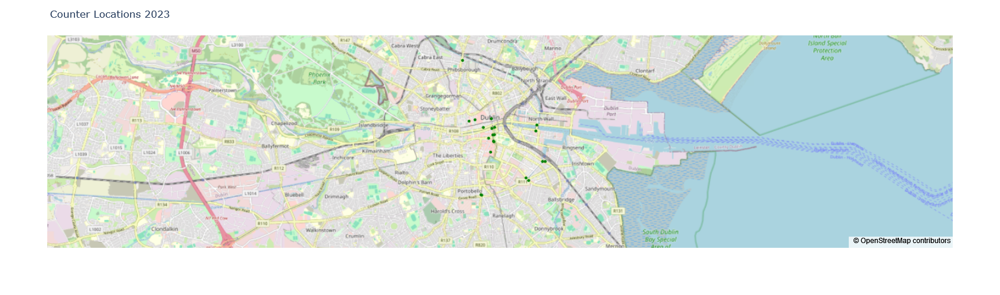

In [88]:
counterLocations_df_fig = px.scatter_mapbox(counterLocations_df,
                        lat="Latitude",
                        lon="Longitude",
                        hover_name="Counter Location",
                        zoom=11.5,
                        mapbox_style="open-street-map")

counterLocations_df_fig.update_traces(marker=dict(color='green')) # green markers for St.Patricks Day
counterLocations_df_fig.update_layout(width=900,
                                    height=500,
                                    title="Counter Locations 2023")

counterLocations_df_fig.show()

### **2.9.2 Counter Locations 2022/2023**

The aim is to create a similar map, with the locations only common to our 2022/2023 dataset. This is useful for visualizing the reduction in our dataset, after removing NaNs.

In [89]:
# remove streets
counterLocations_red_df = counterLocations_df[~counterLocations_df['Counter Location'].isin(remove_pat22_streets)]
# reset index
counterLocations_red_df.reset_index(drop=True, inplace=True)

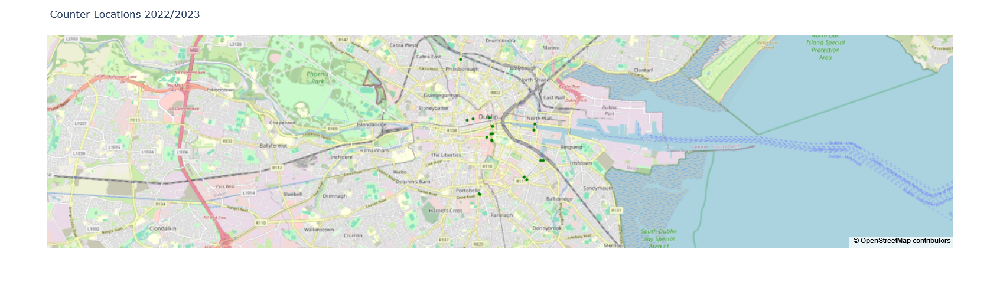

In [90]:
counterLocations_red_df_fig = px.scatter_mapbox(counterLocations_red_df,
                        lat="Latitude",
                        lon="Longitude",
                        hover_name="Counter Location",
                        zoom=11.5,
                        mapbox_style="open-street-map")

counterLocations_red_df_fig.update_traces(marker=dict(color='green'))
counterLocations_red_df_fig.update_layout(width=900,
                                    height=500,
                                    title="Counter Locations 2022/2023")

counterLocations_red_df_fig.show()

# **3. Statistical Analysis**

In [91]:
#pip install --upgrade jinja2
#pip install skimpy

from skimpy import skim

**Processed DataFrame Definitions**

| **DataFrame** |   | **Definition** |
| --------------- | - | -------------- |
| footfall23_df | - | Complete Footfall of 2023 |
| averageday23_df | - | Average Day of Footfall 2023, aggregated by hour |
| patrick23_df | - | Footfall of St.Patrick's Day 2023 |
| patrick23_red_df | - | Footfall of St.Patrick's Day 2023, less missing locations from 2022 |
| patrick22_df | - | Footfall of St.Patrick's Day 2022 |
| patrick22_red_df | - | Footfall of St.Patrick's Day 2022, less missing locations |
| patrick19_df | - | Footfall of St.Patrick's Day 2019 |
| counterLocations_df | - | All Counter Locations for 2023 |
| counterLocations_red_df | - | Common Counter Locations for 2022/2023 |

## **3.1 Complete Footfall of 2023**

In [92]:
footfall23_df.describe()

,Aston Quay/Fitzgeralds,Baggot st lower/Wilton tce inbound,Baggot st upper/Mespil rd/Bank,Capel st/Mary street,College Green/Bank Of Ireland,College st/Westmoreland st,D'olier st/Burgh Quay,Dame Street/Londis,Grafton Street / Nassau Street / Suffolk Street,Grafton Street/CompuB,Grafton st/Monsoon,Grand Canal st upp/Clanwilliam place,Grand Canal st upp/Clanwilliam place/Google,Liffey st/Halfpenny Bridge,Mary st/Jervis st,North Wall Quay/Samuel Beckett bridge East,North Wall Quay/Samuel Beckett bridge West,O'Connell st/Princes st North,Phibsborough Rd/Enniskerry Road,Richmond st south/Portabello Harbour inbound,Richmond st south/Portabello Harbour outbound
count,8760.000000,8760.000000,8760.000000,8760.000000,8760.000000,8760.000000,8760.000000,8760.000000,8760.000000,8760.000000,8760.000000,8760.000000,8760.000000,8760.000000,8760.000000,8760.000000,8760.000000,8760.000000,8760.000000,8760.000000,8760.000000
mean,3371.399201,124.528139,4159.611530,1235.809989,545.018518,602.348402,941.566153,449.768950,249.639912,1885.224372,1714.492694,157.275000,86.394235,5997.554224,447.060388,2121.690297,1579.664326,710.015011,95.784018,753.001712,226.702169
std,1808.875103,135.573687,3044.534866,1037.067112,629.966588,462.072361,545.507856,345.472989,222.603041,1657.536140,1317.813822,169.235451,92.335436,2151.464240,452.887798,1745.803333,1686.131026,499.227191,70.979531,606.438038,140.035867
min,27.000000,0.000000,4.000000,4.000000,0.000000,1.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,183.000000,0.000000,0.000000,0.000000,3.000000,0.000000,1.000000,0.000000
25%,1900.750000,16.000000,1310.500000,387.000000,117.000000,168.000000,514.000000,145.000000,58.750000,456.750000,488.000000,20.000000,14.000000,4651.000000,44.000000,591.750000,197.750000,244.000000,27.000000,235.000000,106.750000
50%,3685.000000,87.000000,4038.500000,1017.500000,374.000000,537.000000,1025.000000,407.000000,190.000000,1425.500000,1424.500000,103.000000,73.000000,5846.000000,274.000000,1768.500000,944.500000,703.000000,98.000000,655.000000,228.000000
75%,4583.000000,187.000000,6225.000000,1834.000000,687.000000,995.000000,1304.000000,678.000000,397.000000,3004.250000,2904.500000,232.000000,124.000000,6779.250000,811.000000,3277.250000,2553.000000,1072.000000,149.000000,1112.000000,325.000000
max,10658.000000,1755.000000,15100.000000,9217.000000,3919.000000,3372.000000,3632.000000,1792.000000,1976.000000,8750.000000,5387.000000,1493.000000,1492.000000,15857.000000,2439.000000,10124.000000,9718.000000,2625.000000,496.000000,4436.000000,895.000000


In [93]:
skim(footfall23_df)

╭──────────────────────────────────────────────── skimpy summary ─────────────────────────────────────────────────╮
│          Data Summary                Data Types                                                                 │
│ ┏━━━━━━━━━━━━━━━━━━━┳━━━━━━━━┓ ┏━━━━━━━━━━━━━┳━━━━━━━┓                                                          │
│ ┃ dataframe         ┃ Values ┃ ┃ Column Type ┃ Count ┃                                                          │
│ ┡━━━━━━━━━━━━━━━━━━━╇━━━━━━━━┩ ┡━━━━━━━━━━━━━╇━━━━━━━┩                                                          │
│ │ Number of rows    │ 8760   │ │ float64     │ 21    │                                                          │
│ │ Number of columns │ 21     │ └─────────────┴───────┘                                                          │
│ └───────────────────┴────────┘                                                                                  │
│                                                     number                                                      │
│ ┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━┳━━━━━━━━┳━━━━━━━┳━━━━━━━┳━━━━━━┳━━━━━━━┳━━━━━━━┳━━━━━━━┳━━━━━━━━┳━━━━━━━━━┓  │
│ ┃ column_name               ┃ NA  ┃ NA %   ┃ mean  ┃ sd    ┃ p0   ┃ p25   ┃ p50   ┃ p75   ┃ p100   ┃ hist    ┃  │
│ ┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━╇━━━━━━━━╇━━━━━━━╇━━━━━━━╇━━━━━━╇━━━━━━━╇━━━━━━━╇━━━━━━━╇━━━━━━━━╇━━━━━━━━━┩  │
│ │ Aston Quay/Fitzgeralds    │   0 │      0 │  3400 │  1800 │   27 │  1900 │  3700 │  4600 │  11000 │  ▅▅▇▂   │  │
│ │ Baggot st lower/Wilton    │   0 │      0 │   120 │   140 │    0 │    16 │    87 │   190 │   1800 │   ▇▁    │  │
│ │ tce inbound               │     │        │       │       │      │       │       │       │        │         │  │
│ │ Baggot st upper/Mespil    │   0 │      0 │  4200 │  3000 │    4 │  1300 │  4000 │  6200 │  15000 │  ▇▆▅▂▁  │  │
│ │ rd/Bank                   │     │        │       │       │      │       │       │       │        │         │  │
│ │ Capel st/Mary street      │   0 │      0 │  1200 │  1000 │    4 │   390 │  1000 │  1800 │   9200 │   ▇▃▁   │  │
│ │ College Green/Bank Of     │   0 │      0 │   550 │   630 │    0 │   120 │   370 │   690 │   3900 │   ▇▂▁   │  │
│ │ Ireland                   │     │        │       │       │      │       │       │       │        │         │  │
│ │ College st/Westmoreland   │   0 │      0 │   600 │   460 │    1 │   170 │   540 │  1000 │   3400 │   ▇▅▂   │  │
│ │ st                        │     │        │       │       │      │       │       │       │        │         │  │
│ │ D'olier st/Burgh Quay     │   0 │      0 │   940 │   550 │    1 │   510 │  1000 │  1300 │   3600 │  ▆▇▆▁   │  │
│ │ Dame Street/Londis        │   0 │      0 │   450 │   350 │    0 │   140 │   410 │   680 │   1800 │  ▇▅▃▂▁  │  │
│ │ Grafton Street / Nassau   │   0 │      0 │   250 │   220 │    0 │    59 │   190 │   400 │   2000 │   ▇▃▁   │  │
│ │ Street / Suffolk Street   │     │        │       │       │      │       │       │       │        │         │  │
│ │ Grafton Street/CompuB     │   0 │      0 │  1900 │  1700 │    0 │   460 │  1400 │  3000 │   8800 │  ▇▃▂▁   │  │
│ │ Grafton st/Monsoon        │   0 │      0 │  1700 │  1300 │    0 │   490 │  1400 │  2900 │   5400 │  ▇▃▃▅▂  │  │
│ │ Grand Canal st            │   0 │      0 │   160 │   170 │    0 │    20 │   100 │   230 │   1500 │   ▇▂▁   │  │
│ │ upp/Clanwilliam place     │     │        │       │       │      │       │       │       │        │         │  │
│ │ Grand Canal st            │   0 │      0 │    86 │    92 │    0 │    14 │    73 │   120 │   1500 │    ▇    │  │
│ │ upp/Clanwilliam           │     │        │       │       │      │       │       │       │        │         │  │
│ │ place/Google              │     │        │       │       │      │       │       │       │        │         │  │
│ │ Liffey st/Halfpenny       │   0 │      0 │  6000 │  2200 │  180 │  4700 │  5800 │  6800 │  16000 │   ▆▇▁▁  │  │
│ │ Bridge                    │     │        │       │  

### **3.1.1 Histograms**

Histograms are a way to visualize frequency tables, with equally spaced "bins" on the x-axis and proportion/frequency on the y-axis. Here, frequency refers to the number of instances an hourly footfall count has occurred. The independent variable is Footfall count, and the dependent variable is the frequency.

In [94]:
# Using .hist to plot Histograms, preference for sns graphs

#footfall23_df.hist(figsize=(10, 16), bins=12, layout=(7, 3))
#plt.suptitle('Histograms for each Counter Location during Year 2023', fontsize=18, y=1)
#plt.tight_layout()
#plt.show()

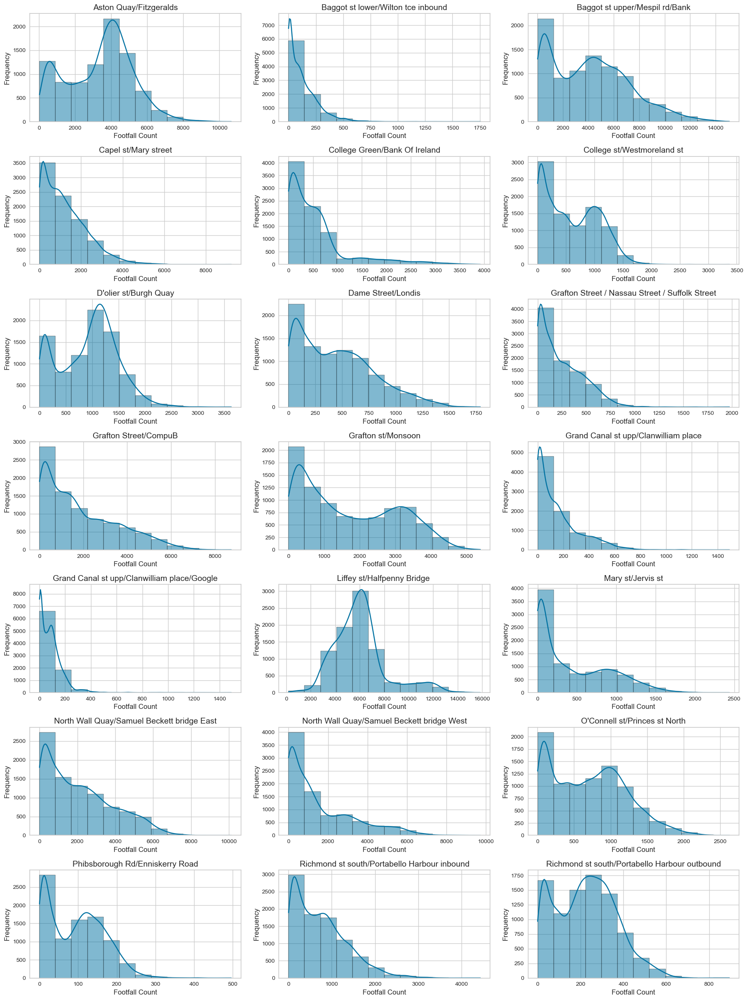

In [95]:
fig, axes = plt.subplots(nrows=7, ncols=3, figsize=(18, 24))
axes = axes.flatten()  # convert it to 1-D or long format to iterate over

for i, column in enumerate(footfall23_df.columns):
    sns.histplot(footfall23_df[column], bins=12, ax=axes[i], kde=True) #kde or density plot/kernel density estimate, a smoothed version of the histogram
    axes[i].set_title(column, fontsize=14)
    axes[i].set_xlabel('Footfall Count', fontsize=12)
    axes[i].set_ylabel('Frequency', fontsize=12)

plt.tight_layout()
plt.show()

**Observations**
- Overall, most of the graphs show right skewness with a long tail, and some centred peaks in footfall. This indicates that most of the time there is a lower proportion of footfall on the streets, with the centred peaks indicating times of high footfall
- The right skewness is possibly affected given we are considering nighttime hours in the data as well, and there may be utility in separating daylight and nighttime to better understand footfall patterns
- **Aston Quay/Fitzgeralds ; D'Olier Street/Burgh Quay** show centralized high peaks in their histograms, indicating a more consistent higher footfall
- **Liffey st/Halfpenny Bridge** shows a more normalised distribution
- **Capel st/Mary street ; Grafton Street/Nassau Street/Suffolk Street** both share a similar shaped right skewness, however Capel Street/Mary Street experiences a general far higher footfall
- **College Green/Bank Of Ireland** shows a broad range of footfall, with a consistent tail between 1000 and 4000

### **3.1.2 Percentiles and Boxplots**

Percentiles are useful for exploring the spread of data and summarizing the whole distribution. Boxplots visualize this data, allowing immediate preliminary interpretation.

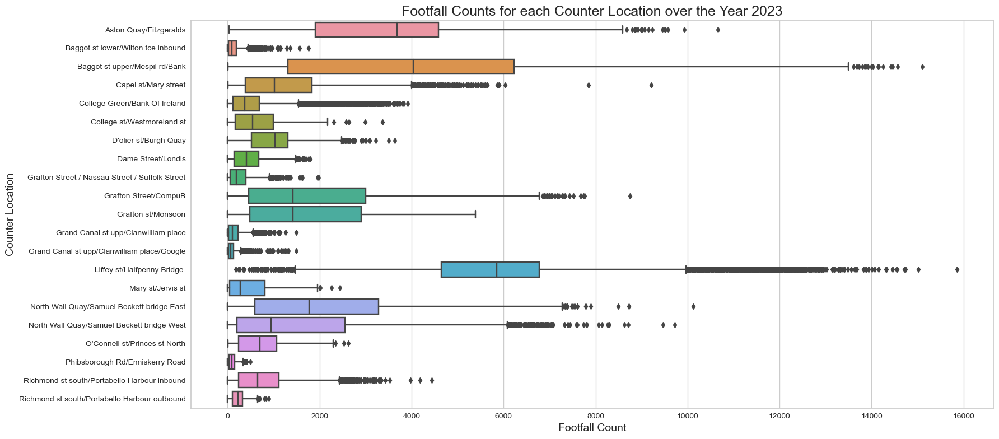

In [96]:
plt.figure(figsize=(18, 8))
sns.boxplot(data=footfall23_df, orient="h") #orient horizontally, as wont fit vertically
plt.title('Footfall Counts for each Counter Location over the Year 2023', fontsize=18)
plt.xlabel('Footfall Count', fontsize=14)
plt.ylabel('Counter Location', fontsize=14)
plt.tight_layout()
plt.show()

**Observations**
- There are some streets with a very wide interquartile range, such as **Baggot st upper/Mespil rd/Bank**. This could be an indication of a lot of variation in footfall counts over the year
- **Aston Quay/Fitzgeralds ; Baggot st upper/Mespil rd/Bank ;  Liffey st/Halfpenny Bridge** have a much higher median compared to other streets
- All locations have upper bound outliers. This may be indicative of periods of higher footfall, due to events like St. Patricks Day festival. Outliers could be used to isolate and identify these events 
- **Liffey st/Halfpenny Bridge** has a noteworthy number of outliers, both above and interestingly below the interquartile range

## **3.2 Footfall of St. Patricks Day 2023**

In [97]:
patrick23_df.describe()

,Aston Quay/Fitzgeralds,Baggot st lower/Wilton tce inbound,Baggot st upper/Mespil rd/Bank,Capel st/Mary street,College Green/Bank Of Ireland,College st/Westmoreland st,D'olier st/Burgh Quay,Dame Street/Londis,Grafton Street / Nassau Street / Suffolk Street,Grafton Street/CompuB,Grafton st/Monsoon,Grand Canal st upp/Clanwilliam place,Grand Canal st upp/Clanwilliam place/Google,Liffey st/Halfpenny Bridge,Mary st/Jervis st,North Wall Quay/Samuel Beckett bridge East,North Wall Quay/Samuel Beckett bridge West,O'Connell st/Princes st North,Phibsborough Rd/Enniskerry Road,Richmond st south/Portabello Harbour inbound,Richmond st south/Portabello Harbour outbound
count,24.000000,24.000000,24.000000,24.000000,24.000000,24.000000,24.000000,24.000000,24.000000,24.000000,24.000000,24.000000,24.000000,24.000000,24.000000,24.000000,24.000000,24.000000,24.000000,24.000000,24.000000
mean,2884.750000,119.250000,4531.791667,1443.750000,265.458333,1105.916667,1502.083333,781.583333,705.833333,627.000000,2632.958333,89.541667,70.375000,5377.375000,437.041667,1236.875000,797.541667,1004.666667,135.125000,826.375000,379.333333
std,1552.412799,80.859648,2441.195697,885.262243,252.048128,981.561397,920.765084,590.825430,625.765039,418.492429,1486.891519,66.260999,48.393148,2247.806502,460.069511,810.454371,611.330977,652.551958,102.601938,402.460672,233.978384
min,662.000000,5.000000,238.000000,100.000000,1.000000,49.000000,243.000000,95.000000,25.000000,21.000000,186.000000,4.000000,2.000000,2755.000000,13.000000,142.000000,26.000000,87.000000,6.000000,169.000000,28.000000
25%,1503.750000,40.500000,2187.000000,714.500000,26.000000,252.000000,833.500000,240.750000,174.250000,280.250000,1282.000000,32.750000,27.750000,4367.500000,51.500000,606.500000,160.000000,337.750000,33.250000,470.500000,177.000000
50%,2612.000000,139.000000,5438.000000,1384.500000,181.000000,905.000000,1467.000000,624.500000,490.500000,695.500000,2903.500000,77.500000,69.000000,5003.000000,276.500000,1092.500000,757.000000,1002.500000,135.500000,879.500000,424.000000
75%,4449.750000,185.750000,6479.250000,2191.000000,480.500000,1581.000000,1804.250000,1359.000000,1133.000000,957.500000,3751.000000,134.250000,106.250000,5397.250000,658.250000,1800.000000,1211.250000,1713.000000,221.500000,1028.750000,522.000000
max,4924.000000,253.000000,8880.000000,2795.000000,685.000000,3372.000000,3632.000000,1765.000000,1976.000000,1208.000000,5158.000000,231.000000,151.000000,12166.000000,1588.000000,2833.000000,2080.000000,1940.000000,346.000000,1602.000000,895.000000


In [98]:
skim(patrick23_df)

╭──────────────────────────────────────────────── skimpy summary ─────────────────────────────────────────────────╮
│          Data Summary                Data Types                                                                 │
│ ┏━━━━━━━━━━━━━━━━━━━┳━━━━━━━━┓ ┏━━━━━━━━━━━━━┳━━━━━━━┓                                                          │
│ ┃ dataframe         ┃ Values ┃ ┃ Column Type ┃ Count ┃                                                          │
│ ┡━━━━━━━━━━━━━━━━━━━╇━━━━━━━━┩ ┡━━━━━━━━━━━━━╇━━━━━━━┩                                                          │
│ │ Number of rows    │ 24     │ │ float64     │ 21    │                                                          │
│ │ Number of columns │ 21     │ └─────────────┴───────┘                                                          │
│ └───────────────────┴────────┘                                                                                  │
│                                                     number                                                      │
│ ┏━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━┳━━━━━━━━┳━━━━━━━┳━━━━━━━┳━━━━━━━┳━━━━━━━┳━━━━━━━┳━━━━━━━┳━━━━━━━━┳━━━━━━━━━┓  │
│ ┃ column_name              ┃ NA  ┃ NA %   ┃ mean  ┃ sd    ┃ p0    ┃ p25   ┃ p50   ┃ p75   ┃ p100   ┃ hist    ┃  │
│ ┡━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━╇━━━━━━━━╇━━━━━━━╇━━━━━━━╇━━━━━━━╇━━━━━━━╇━━━━━━━╇━━━━━━━╇━━━━━━━━╇━━━━━━━━━┩  │
│ │ Aston Quay/Fitzgeralds   │   0 │      0 │  2900 │  1600 │   660 │  1500 │  2600 │  4400 │   4900 │ ▃▅▃▁▁▇  │  │
│ │ Baggot st lower/Wilton   │   0 │      0 │   120 │    81 │     5 │    40 │   140 │   190 │    250 │ ▇▂▂▅▇▂  │  │
│ │ tce inbound              │     │        │       │       │       │       │       │       │        │         │  │
│ │ Baggot st upper/Mespil   │   0 │      0 │  4500 │  2400 │   240 │  2200 │  5400 │  6500 │   8900 │ ▃▅▂▅▇▁  │  │
│ │ rd/Bank                  │     │        │       │       │       │       │       │       │        │         │  │
│ │ Capel st/Mary street     │   0 │      0 │  1400 │   890 │   100 │   710 │  1400 │  2200 │   2800 │ ▇▃▇▃▃▇  │  │
│ │ College Green/Bank Of    │   0 │      0 │   270 │   250 │     1 │    26 │   180 │   480 │    680 │ ▇▂▂▁▂▃  │  │
│ │ Ireland                  │     │        │       │       │       │       │       │       │        │         │  │
│ │ College st/Westmoreland  │   0 │      0 │  1100 │   980 │    49 │   250 │   900 │  1600 │   3400 │ ▇▅▃▁▂▂  │  │
│ │ st                       │     │        │       │       │       │       │       │       │        │         │  │
│ │ D'olier st/Burgh Quay    │   0 │      0 │  1500 │   920 │   240 │   830 │  1500 │  1800 │   3600 │ ▅▃▇▂▁▂  │  │
│ │ Dame Street/Londis       │   0 │      0 │   780 │   590 │    95 │   240 │   620 │  1400 │   1800 │ ▇▂▂ ▃▃  │  │
│ │ Grafton Street / Nassau  │   0 │      0 │   710 │   630 │    25 │   170 │   490 │  1100 │   2000 │ ▇▇▁▃▂▂  │  │
│ │ Street / Suffolk Street  │     │        │       │       │       │       │       │       │        │         │  │
│ │ Grafton Street/CompuB    │   0 │      0 │   630 │   420 │    21 │   280 │   700 │   960 │   1200 │ ▇▅▁▃▇▇  │  │
│ │ Grafton st/Monsoon       │   0 │      0 │  2600 │  1500 │   190 │  1300 │  2900 │  3800 │   5200 │ ▅▃▂▇▆▃  │  │
│ │ Grand Canal st           │   0 │      0 │    90 │    66 │     4 │    33 │    78 │   130 │    230 │ ▇▅▂▃▃▁  │  │
│ │ upp/Clanwilliam place    │     │        │       │       │       │       │       │       │        │         │  │
│ │ Grand Canal st           │   0 │      0 │    70 │    48 │     2 │    28 │    69 │   110 │    150 │ ▇▃▇▃▅▅  │  │
│ │ upp/Clanwilliam          │     │        │       │       │       │       │       │       │        │         │  │
│ │ place/Google             │     │        │       │       │       │       │       │       │        │         │  │
│ │ Liffey st/Halfpenny      │   0 │      0 │  5400 │  2200 │  2800 │  4400 │  5000 │  5400 │  12000 │ ▃▇▂  ▁  │  │
│ │ Bridge                   │     │        │       │   

### **3.2.1 Histograms**

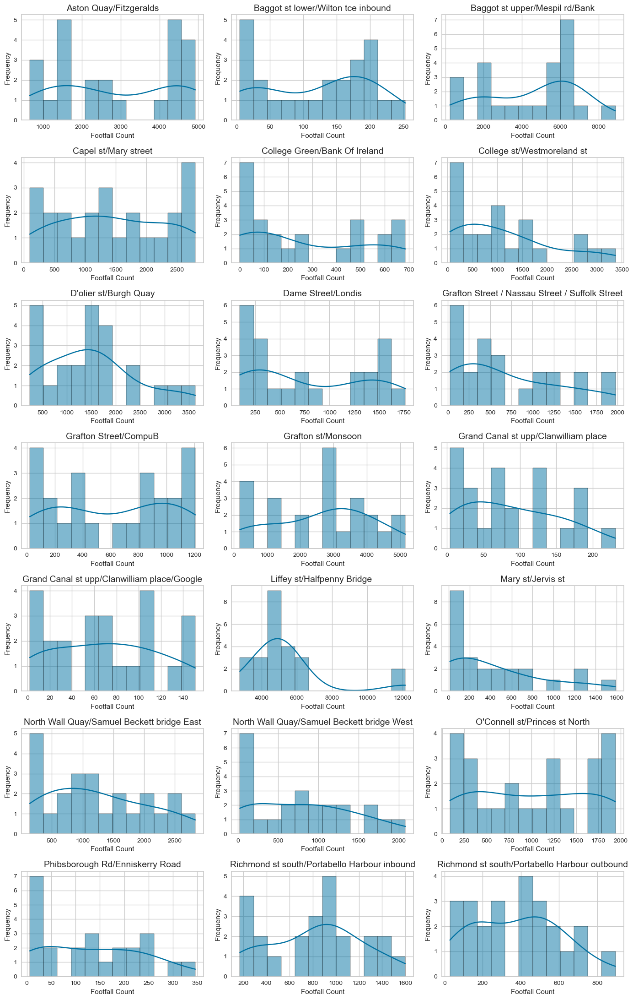

In [99]:
fig, axes = plt.subplots(nrows=7, ncols=3, figsize=(14, 22))
axes = axes.flatten()  # convert it to 1-D or long format to iterate over

for i, column in enumerate(patrick23_df.columns):
    sns.histplot(patrick23_df[column], bins=12, ax=axes[i], kde=True) #kde or density plot/kernel density estimate, a smoothed version of the histogram
    axes[i].set_title(column, fontsize=14)
    axes[i].set_xlabel('Footfall Count')
    axes[i].set_ylabel('Frequency')

plt.tight_layout()
plt.show()

**Observations**
- There is some tendency towards right skewness, such as with **D'olier st/Burgh Quay** and **Grand Canal st upp/Clanwilliam place**
- Most distributions appear to demonstrate slight bimodality, with two peaks. This is possibly due to the nature of peak and off-peak hours, and small sample size of counts over a 24-hour period

### **3.2.2 Percentiles and Boxplots**

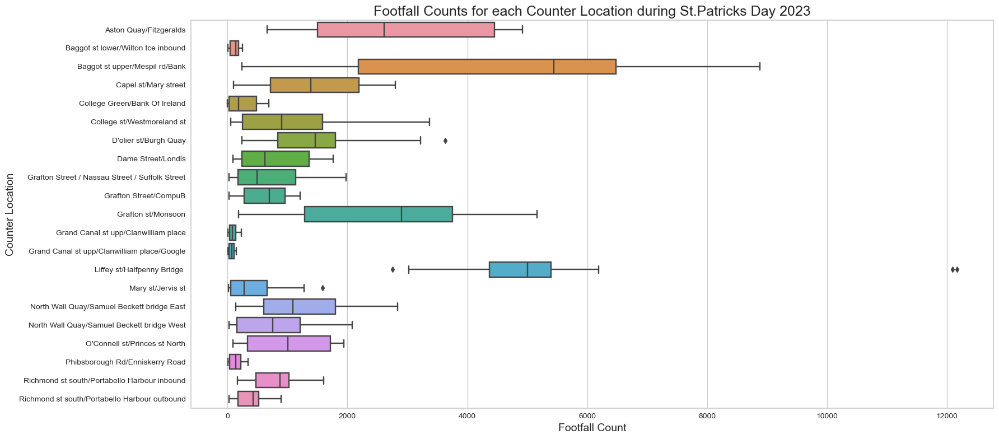

In [100]:
plt.figure(figsize=(18, 8))
sns.boxplot(data=patrick23_df, orient="h") #wont fit vertically
plt.title('Footfall Counts for each Counter Location during St.Patricks Day 2023', fontsize=18)
plt.xlabel('Footfall Count', fontsize=14)
plt.ylabel('Counter Location', fontsize=14)
plt.tight_layout()
plt.show()

**Observations**
- **Liffey st/Halfpenny Bridge** has some very large outliers, and did not record any low counts throughout the day
- Both **D'olier st/Burgh Quay** and **Mary st/Jervis st** have upper outliers
- **Aston Quay/Fitzgeralds** and **Grafton st/Monsoon** have a similar distribution over the day, however with the latter having a higher median
- **Baggot st upper/Mespil rd/Bank** shows a large variation over the day, with counts both high and low

## **3.3 Footfall of St. Patricks Day 2022**

In [101]:
patrick22_df.describe()

,Aston Quay/Fitzgeralds,Baggot st lower/Wilton tce inbound,Baggot st upper/Mespil rd/Bank,Capel st/Mary street,College Green/Bank Of Ireland,College st/Westmoreland st,D'olier st/Burgh Quay,Dame Street/Londis,Grafton Street / Nassau Street / Suffolk Street,Grafton Street/CompuB,Grafton st/Monsoon,Grand Canal st upp/Clanwilliam place,Grand Canal st upp/Clanwilliam place/Google,Liffey st/Halfpenny Bridge,Mary st/Jervis st,North Wall Quay/Samuel Beckett bridge East,North Wall Quay/Samuel Beckett bridge West,O'Connell st/Princes st North,Phibsborough Rd/Enniskerry Road,Richmond st south/Portabello Harbour inbound,Richmond st south/Portabello Harbour outbound
count,0.0,24.000000,24.000000,24.000000,24.000000,24.000000,24.000000,24.000000,24.00000,24.000000,0.0,24.000000,24.000000,0.0,24.000000,24.000000,24.000000,24.000000,24.000000,24.000000,24.000000
mean,NaN,321.875000,356.416667,1345.375000,1251.708333,1124.458333,1074.916667,1393.625000,767.25000,1511.458333,NaN,87.458333,67.333333,NaN,911.708333,1685.041667,620.958333,1207.166667,178.875000,379.125000,419.041667
std,NaN,222.486797,266.271179,937.059731,1028.219587,1123.757013,645.008319,1123.547867,790.84832,1077.028964,NaN,65.112598,48.349872,NaN,1059.862398,742.274090,382.709730,938.381755,116.831842,226.272116,273.977701
min,NaN,31.000000,8.000000,158.000000,7.000000,25.000000,52.000000,77.000000,20.00000,51.000000,NaN,2.000000,2.000000,NaN,8.000000,449.000000,34.000000,108.000000,18.000000,40.000000,37.000000
25%,NaN,106.500000,74.500000,423.250000,425.250000,225.750000,458.000000,389.500000,180.00000,501.250000,NaN,21.000000,23.500000,NaN,38.000000,1197.750000,294.000000,342.250000,88.750000,189.500000,174.000000
50%,NaN,345.000000,320.000000,1303.500000,1077.500000,712.500000,1291.000000,892.500000,410.00000,1821.000000,NaN,75.000000,65.500000,NaN,275.000000,1683.500000,558.000000,1096.500000,178.000000,408.000000,487.000000
75%,NaN,485.500000,580.250000,1854.750000,1882.250000,1572.750000,1609.000000,2392.750000,1148.75000,2309.500000,NaN,143.250000,106.000000,NaN,1781.500000,2108.750000,941.250000,2010.250000,265.250000,507.250000,633.500000
max,NaN,887.000000,769.000000,3225.000000,3611.000000,3988.000000,1963.000000,3525.000000,2619.00000,3158.000000,NaN,203.000000,160.000000,NaN,3309.000000,3366.000000,1204.000000,3127.000000,376.000000,886.000000,954.000000


In [102]:
skim(patrick22_red_df)

╭──────────────────────────────────────────────── skimpy summary ─────────────────────────────────────────────────╮
│          Data Summary                Data Types                                                                 │
│ ┏━━━━━━━━━━━━━━━━━━━┳━━━━━━━━┓ ┏━━━━━━━━━━━━━┳━━━━━━━┓                                                          │
│ ┃ dataframe         ┃ Values ┃ ┃ Column Type ┃ Count ┃                                                          │
│ ┡━━━━━━━━━━━━━━━━━━━╇━━━━━━━━┩ ┡━━━━━━━━━━━━━╇━━━━━━━┩                                                          │
│ │ Number of rows    │ 24     │ │ float64     │ 18    │                                                          │
│ │ Number of columns │ 18     │ └─────────────┴───────┘                                                          │
│ └───────────────────┴────────┘                                                                                  │
│                                                     number                                                      │
│ ┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━┳━━━━━━━━┳━━━━━━━━┳━━━━━━━┳━━━━━━┳━━━━━━━┳━━━━━━━┳━━━━━━━┳━━━━━━━┳━━━━━━━━━┓  │
│ ┃ column_name               ┃ NA  ┃ NA %   ┃ mean   ┃ sd    ┃ p0   ┃ p25   ┃ p50   ┃ p75   ┃ p100  ┃ hist    ┃  │
│ ┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━╇━━━━━━━━╇━━━━━━━━╇━━━━━━━╇━━━━━━╇━━━━━━━╇━━━━━━━╇━━━━━━━╇━━━━━━━╇━━━━━━━━━┩  │
│ │ Baggot st lower/Wilton    │   0 │      0 │    320 │   220 │   31 │   110 │   340 │   490 │   890 │ ▇▂▇▆ ▁  │  │
│ │ tce inbound               │     │        │        │       │      │       │       │       │       │         │  │
│ │ Baggot st upper/Mespil    │   0 │      0 │    360 │   270 │    8 │    74 │   320 │   580 │   770 │ ▇▃▃▃▅▅  │  │
│ │ rd/Bank                   │     │        │        │       │      │       │       │       │       │         │  │
│ │ Capel st/Mary street      │   0 │      0 │   1300 │   940 │  160 │   420 │  1300 │  1900 │  3200 │ ▇▁▅▃▃▂  │  │
│ │ College Green/Bank Of     │   0 │      0 │   1300 │  1000 │    7 │   430 │  1100 │  1900 │  3600 │ ▇▂▃▂▂▁  │  │
│ │ Ireland                   │     │        │        │       │      │       │       │       │       │         │  │
│ │ College st/Westmoreland   │   0 │      0 │   1100 │  1100 │   25 │   230 │   710 │  1600 │  4000 │ ▇▃▃ ▂▁  │  │
│ │ st                        │     │        │        │       │      │       │       │       │       │         │  │
│ │ D'olier st/Burgh Quay     │   0 │      0 │   1100 │   650 │   52 │   460 │  1300 │  1600 │  2000 │ ▇▃▃▃▇▇  │  │
│ │ Dame Street/Londis        │   0 │      0 │   1400 │  1100 │   77 │   390 │   890 │  2400 │  3500 │ ▇▅▁▃▃▃  │  │
│ │ Grafton Street / Nassau   │   0 │      0 │    770 │   790 │   20 │   180 │   410 │  1100 │  2600 │ ▇▂▁▂ ▂  │  │
│ │ Street / Suffolk Street   │     │        │        │       │      │       │       │       │       │         │  │
│ │ Grafton Street/CompuB     │   0 │      0 │   1500 │  1100 │   51 │   500 │  1800 │  2300 │  3200 │ ▇▂ ▅▅▅  │  │
│ │ Grand Canal st            │   0 │      0 │     87 │    65 │    2 │    21 │    75 │   140 │   200 │ ▇▃▆▁▅▅  │  │
│ │ upp/Clanwilliam place     │     │        │        │       │      │       │       │       │       │         │  │
│ │ Grand Canal st            │   0 │      0 │     67 │    48 │    2 │    24 │    66 │   110 │   160 │ ▇▃▂▅▅▂  │  │
│ │ upp/Clanwilliam           │     │        │        │       │      │       │       │       │       │         │  │
│ │ place/Google              │     │        │        │       │      │       │       │       │       │         │  │
│ │ Mary st/Jervis st         │   0 │      0 │    910 │  1100 │    8 │    38 │   280 │  1800 │  3300 │ ▇▁▁▂▁▁  │  │
│ │ North Wall Quay/Samuel    │   0 │      0 │   1700 │   740 │  450 │  1200 │  1700 │  2100 │  3400 │ ▆▇▇▇▆▂  │  │
│ │ Beckett bridge East       │     │        │        │       │      │       │       │       │       │         │  │
│ │ North Wall Quay/Samuel    │   0 │      0 │    620 │ 

### **3.3.1 Histograms**

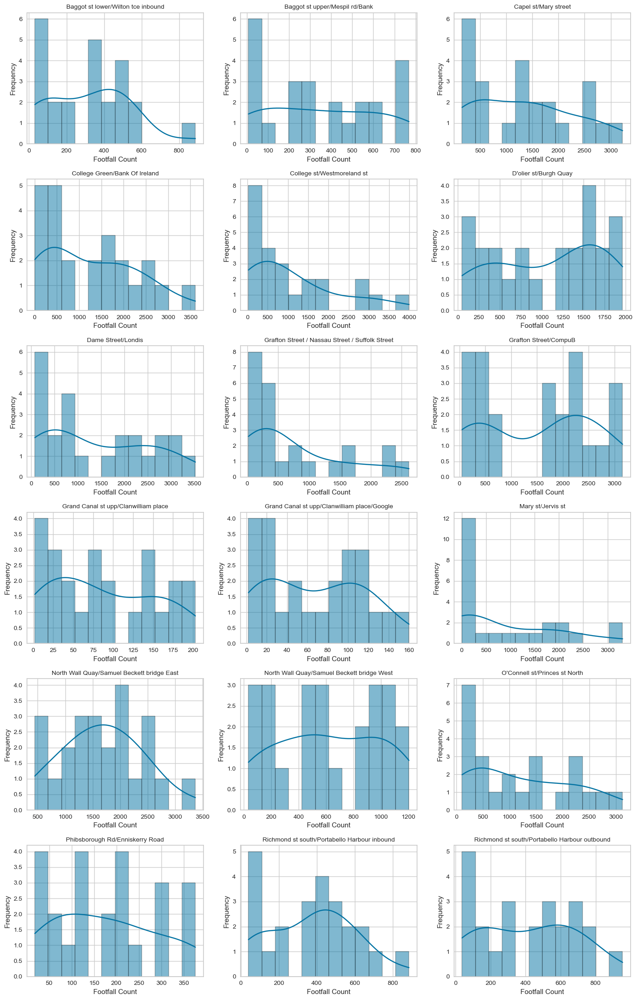

In [103]:
fig, axes = plt.subplots(nrows=6, ncols=3, figsize=(14, 22))
axes = axes.flatten()  # convert it to 1-D or long format to iterate over

for i, column in enumerate(patrick22_red_df.columns):
    sns.histplot(patrick22_red_df[column], bins=12, ax=axes[i], kde=True) #kde or density plot/kernel density estimate, a smoothed version of the histogram
    axes[i].set_title(column, fontsize=10)
    axes[i].set_xlabel('Footfall Count')
    axes[i].set_ylabel('Frequency')

plt.tight_layout()
plt.show()

**Observations**
- There is some tendancy towards right skewness, such as with **College st/Westmoreland st** and **College Green/Bank Of Ireland**
- Similar to St. Patrick's Day 2023, most distributions appear to demonstrate slight bimodality, indicating either periods of low or high footfall count

### **3.3.2 Percentiles and Boxplots**

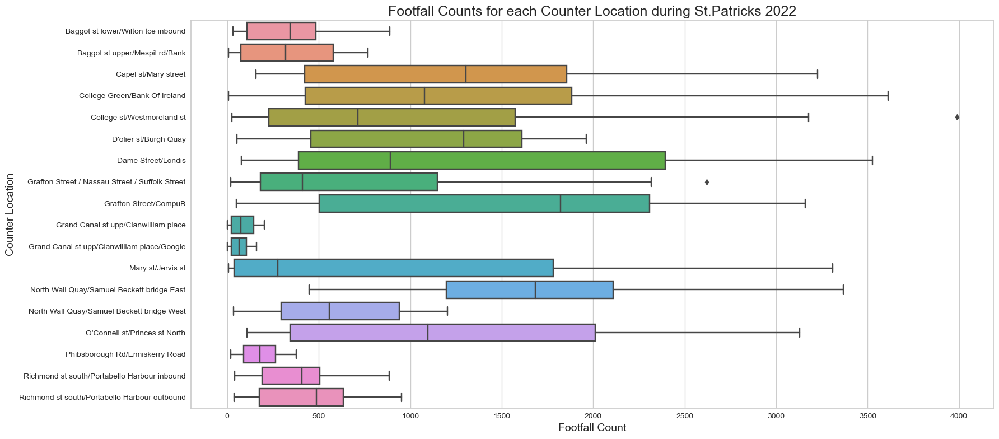

In [104]:
plt.figure(figsize=(18, 8))
sns.boxplot(data=patrick22_red_df, orient="h") #wont fit vertically
plt.title('Footfall Counts for each Counter Location during St.Patricks 2022', fontsize=18)
plt.xlabel('Footfall Count', fontsize=14)
plt.ylabel('Counter Location', fontsize=14)
plt.tight_layout()
plt.show()

**Observations**
- Both **College st/Westmoreland st** and **Grafton Street / Nassau Street / Suffolk Street** have upper outliers
- **Grand Canal st upp/Clanwilliam place** and **Grand Canal st upp/Clanwilliam place/Google** have a similar  low count distribution over the day
- **Mary st/Jervis st** experiences large counts over its median

## **3.4 Outliers of 2023 Analysis**

Assuming upper outliers are indicitive of instances of unusually high footfall, it may be useful to create a function which identifies the time of outliers in a series/location. Using "Dame Street/Londis", we can see it returns 5 outliers dated on St. Patrick's Day, out of 22 for the whole year.
- **outlier_dates( )** takes a df.column as an argument, and returns outliers

In [105]:
from UserDefinedFunctions import outlier_dates

outlier_dates(footfall23_df['Dame Street/Londis'])

Time
2023-01-14 14:00:00    1483.0
2023-01-14 15:00:00    1627.0
2023-02-09 17:00:00    1642.0
2023-03-04 19:00:00    1479.0
2023-03-17 15:00:00    1524.0
2023-03-17 16:00:00    1502.0
2023-03-17 17:00:00    1555.0
2023-03-17 19:00:00    1567.0
2023-03-17 20:00:00    1765.0
2023-04-03 14:00:00    1478.0
2023-04-03 15:00:00    1792.0
2023-04-13 13:00:00    1621.0
2023-04-14 13:00:00    1645.0
2023-04-20 17:00:00    1640.0
2023-05-26 16:00:00    1505.0
2023-05-27 14:00:00    1661.0
2023-05-27 15:00:00    1503.0
2023-06-09 16:00:00    1538.0
2023-06-24 12:00:00    1559.0
2023-06-24 14:00:00    1704.0
2023-06-24 15:00:00    1645.0
2023-07-08 15:00:00    1522.0
Name: Dame Street/Londis, dtype: float64

## **3.5 Visualization of Footfall Counts**

Given there are several streets to visualize, we will make use "plotly" interactive graphs to aid us encapsulate footfall count over time. This allows for toggling on/off of certain locations, or focusing in one location.

### **3.5.1 Graph of Complete Footfall 2023**

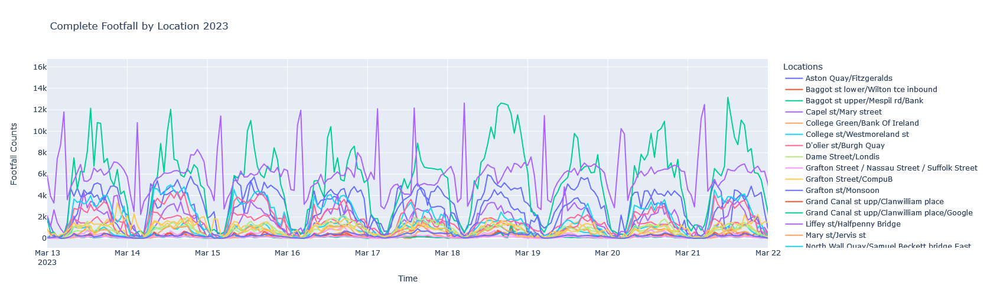

In [106]:
footfall23_fig = px.line(footfall23_df, y=footfall23_df.columns, title='Complete Footfall by Location 2023')

# focus axes on time period around March 17th
footfall23_fig.update_xaxes(range=["2023-03-13","2023-03-22"])

footfall23_fig.update_layout(
    xaxis_title="Time",
    yaxis_title="Footfall Counts",
    legend_title="Locations",
    width=1500,
    height=500
    )

footfall23_fig.show()

### **3.5.2 Graph of Average Day of Footfall 2023**

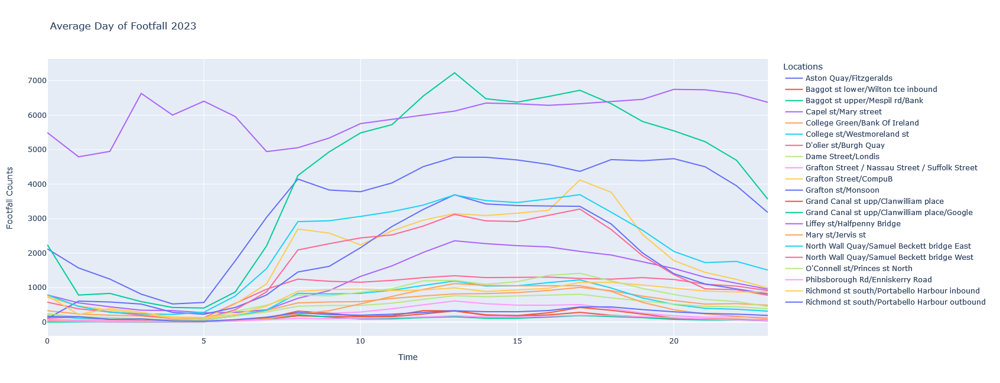

In [107]:
averageday23_fig = px.line(averageday23_df, y=averageday23_df.columns, title='Average Day of Footfall 2023')

averageday23_fig.update_layout(
    xaxis_title="Time",
    yaxis_title="Footfall Counts",
    legend_title="Locations",
    width=1300,
    height=650
    )

averageday23_fig.show()

### **3.5.3 Graph of St.Patrick's Day Footfall 2023**

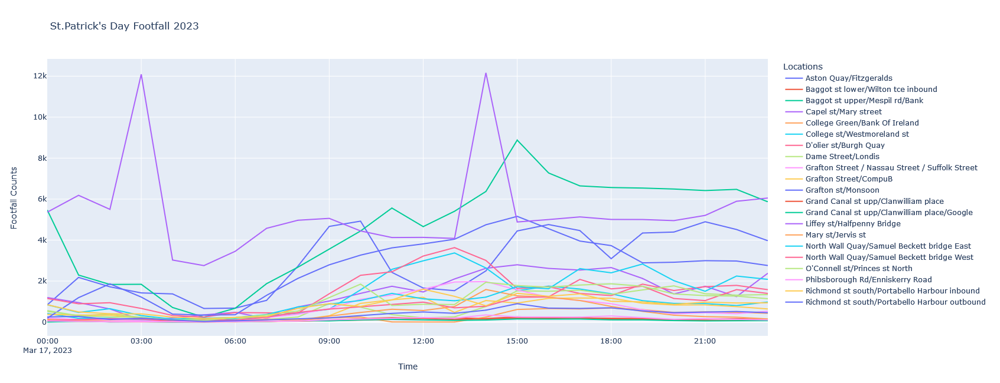

In [108]:
patrick23_fig = px.line(patrick23_df, y=patrick23_df.columns, title="St.Patrick's Day Footfall 2023")

patrick23_fig.update_layout(
    xaxis_title="Time",
    yaxis_title="Footfall Counts",
    legend_title="Locations",
    width=1300,
    height=650
    )

patrick23_fig.show()

### **3.5.4 Graph of St.Patrick's Day Footfall 2022**

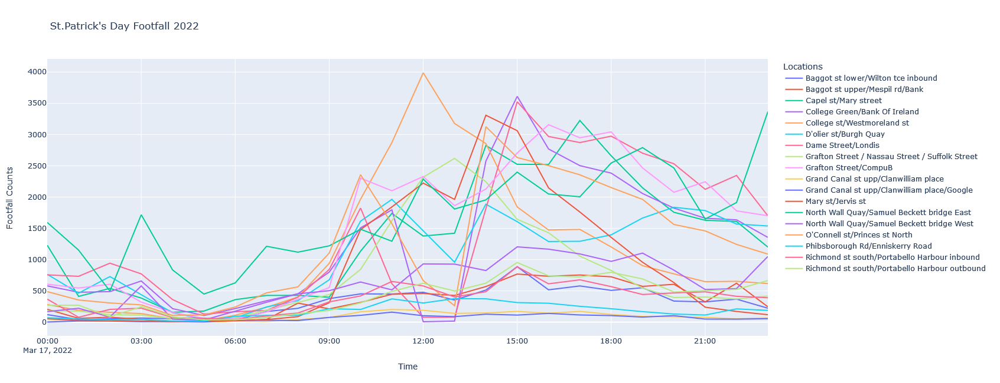

In [109]:
patrick22_red_fig = px.line(patrick22_red_df, y=patrick22_red_df.columns, title="St.Patrick's Day Footfall 2022")

patrick22_red_fig.update_layout(
    xaxis_title="Time",
    yaxis_title="Footfall Counts",
    legend_title="Locations",
    width=1300,
    height=650
    )

patrick22_red_fig.show()

## **3.6 Liffey st/Halfpenny Bridge Analysis and Poisson Distribution** <br>

Given the substantial footfall counts, outliers, and discrepancies observed at Liffey Street/Halfpenny Bridge, this section explores the application of the Poisson Distribution to assess the likelihood of such footfall levels. The Poisson distribution, which models the frequency of events occurring within a fixed interval of time or space, provides a suitable framework for this analysis. To employ this method, we will compare the average footfall counts across all locations during the entire year of 2023 at 3 am against the average footfall counts observed at the same time at Liffey Street/Halfpenny Bridge. This comparison will help in understanding how the footfall counts at Liffey Street/Halfpenny Bridge deviates from the general pattern.

In [110]:
# select 3am footfall over the whole year
threeAM_footfall23_df = footfall23_df[footfall23_df.index.hour == 3]

# select liffey from 3am footfall
threeAM_liffey_footfall23_df = threeAM_footfall23_df['Liffey st/Halfpenny Bridge ']

# Average footfall Liffey 3am per minute
liffey_average = round((threeAM_liffey_footfall23_df.mean())/60)

print("The average footfall count per minute at Liffey st/Halfpenny Bridge at 3am is:", liffey_average)

The average footfall count per minute at Liffey st/Halfpenny Bridge at 3am is: 110


In [111]:
# 3am footfall excluding Liffey
threeAM_remainder_footfall23_df = threeAM_footfall23_df.drop(columns=['Liffey st/Halfpenny Bridge '])

# Average footfall per minute at all other locations at 3am
remainder_average = round((threeAM_remainder_footfall23_df.mean().mean())/60)

print("The average footfall count per minute at all other locations at 3am is:", remainder_average)

The average footfall count per minute at all other locations at 3am is: 3


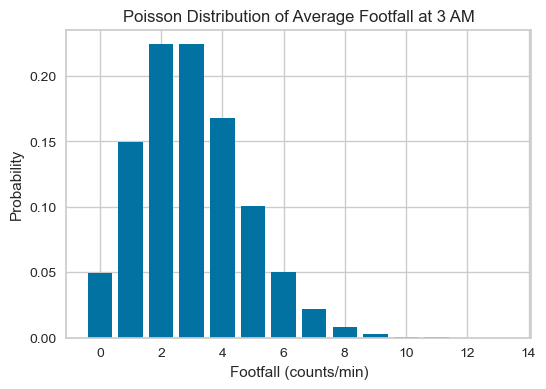

In [112]:
# create a range from 0 to 14
footfall_3am = np.arange(0, 14)

#apply poisson probability mass function
poisson_3am = poisson.pmf(footfall_3am, remainder_average)

plt.figure(figsize=(6, 4))
plt.bar(footfall_3am, poisson_3am)
plt.title('Poisson Distribution of Average Footfall at 3 AM')
plt.xlabel('Footfall (counts/min)')
plt.ylabel('Probability')

plt.show()

In [113]:
# what is the likelihood of 110 counts  at one location, given the poisson average at other locations of 3.25?
print("Probabilty of having >= 110 counts:", (100*poisson.sf(k = liffey_average, mu = remainder_average)), "%")

Probabilty of having >= 110 counts: 2.6492553543087644e-127 %


In [114]:
# what is the likelihood of more than 30 counts at one location, given the poisson average at other locations of 3.25?
print("Probabilty of having >=30 counts:", (100*poisson.sf(k = 30, mu = remainder_average)), "%")

Probabilty of having >=30 counts: 4.1254051981139903e-19 %


In [115]:
# what is the likelihood of more than 6 counts at one location, given the poisson average at other locations of 3.25?
print("Probabilty of having >=6 counts:", (100*poisson.sf(k = 6, mu = remainder_average)), "%")

Probabilty of having >=6 counts: 3.3508535308841214 %


**Observations**
- The average footfall counted at Liffey st/Halfpenny Bridge 3 am is far out of bounds based on other locations
- The probability of one location experiencing an average footfall of more than 110 per minute at 3 am is calculated at nearly 0%
- Due to the improbability of such footfall, the Liffey st/Halfpenny Bridge Counts will be considered as unrepresentative of true figures, and removed from the analysis


In [116]:
counterLocations_df

,Counter Location,Latitude,Longitude
0,Aston Quay/Fitzgeralds,53.34662,-6.259820
1,Baggot st lower/Wilton tce inbound,53.33448,-6.245770
2,Baggot st upper/Mespil rd/Bank,53.33385,-6.244690
3,Capel st/Mary street,53.34842,-6.269180
4,College Green/Bank Of Ireland,53.34505,-6.259390
5,College st/Westmoreland st,53.34510,-6.258778
6,D'olier st/Burgh Quay,53.34690,-6.258720
7,Dame Street/Londis,53.34424,-6.261160
8,Grafton Street / Nassau Street / Suffolk Street,53.34352,-6.259120
9,Grafton Street/CompuB,53.34337,-6.258980


In [117]:
# Liffey st/Halfpenny Bridge dropped from dfs 
footfall23_df = footfall23_df.drop(columns=['Liffey st/Halfpenny Bridge '])
patrick23_df = patrick23_df.drop(columns=['Liffey st/Halfpenny Bridge '])
patrick22_df = patrick22_df.drop(columns=['Liffey st/Halfpenny Bridge '])
averageday23_df = averageday23_df.drop(columns=['Liffey st/Halfpenny Bridge '])
counterLocations_df = counterLocations_df.drop(counterLocations_df.index[13]).reset_index(drop=1)

## **3.7 Average Daily Footfall and Poisson Distribution**

In the application of the Poisson Distribution, we must assume that events are independent, and occur at a constant rate. Footfall count data has the inherent property of fluctuations over a given time period. To minimize this, we will look at relatively stable sub-period of our data, the counts during work hours, 9am-5pm, and average them across the year. This will be considered our constant rate, and then we will compare the average using Poisson, to the counts observed on St. Patrick's Day.

### **3.7.1 Working Hours by Location**

In [118]:
# select hours by index and then average, convert to minutes
avgworkday23_df = (averageday23_df.loc[10:17].mean())/60

In [119]:
print("The Average Footfall Count, in Counts per Minute, during Working Hours are:")
avgworkday23_df

The Average Footfall Count, in Counts per Minute, during Working Hours are:


Aston Quay/Fitzgeralds                              74.004087
Baggot st lower/Wilton tce inbound                   3.670982
Baggot st upper/Mespil rd/Bank                     106.466444
Capel st/Mary street                                33.440439
College Green/Bank Of Ireland                       13.455170
College st/Westmoreland st                          17.656587
D'olier st/Burgh Quay                               21.158225
Dame Street/Londis                                  11.525885
Grafton Street / Nassau Street / Suffolk Street      7.946204
Grafton Street/CompuB                               51.230268
Grafton st/Monsoon                                  52.938624
Grand Canal st upp/Clanwilliam place                 4.353213
Grand Canal st upp/Clanwilliam place/Google          2.135491
Mary st/Jervis st                                   15.752300
North Wall Quay/Samuel Beckett bridge East          57.499406
North Wall Quay/Samuel Beckett bridge West          48.127608
O'Connel

In [120]:
# here we can use between time as the df is indexed by datetime object
workpatrick23_df = (patrick23_df.between_time('10:00', '17:00', inclusive='both').mean())/60
workpatrick23_df

Aston Quay/Fitzgeralds                              55.633333
Baggot st lower/Wilton tce inbound                   3.345833
Baggot st upper/Mespil rd/Bank                     102.591667
Capel st/Mary street                                36.016667
College Green/Bank Of Ireland                        5.016667
College st/Westmoreland st                          37.568750
D'olier st/Burgh Quay                               40.304167
Dame Street/Londis                                  14.339583
Grafton Street / Nassau Street / Suffolk Street     24.570833
Grafton Street/CompuB                               16.625000
Grafton st/Monsoon                                  69.075000
Grand Canal st upp/Clanwilliam place                 2.695833
Grand Canal st upp/Clanwilliam place/Google          2.016667
Mary st/Jervis st                                   15.716667
North Wall Quay/Samuel Beckett bridge East          24.570833
North Wall Quay/Samuel Beckett bridge West          17.772917
O'Connel

In [121]:
# join side by side
poisson_patrick_df = pd.concat([avgworkday23_df, workpatrick23_df], axis=1)
# rename columns
poisson_patrick_df.columns = ["Average, Mu", "Patrick, K"]
# round for clarity and assume discrete steps
poisson_patrick_df = poisson_patrick_df.round().astype(int)
poisson_patrick_df

,"Average, Mu","Patrick, K"
Aston Quay/Fitzgeralds,74,56
Baggot st lower/Wilton tce inbound,4,3
Baggot st upper/Mespil rd/Bank,106,103
Capel st/Mary street,33,36
College Green/Bank Of Ireland,13,5
College st/Westmoreland st,18,38
D'olier st/Burgh Quay,21,40
Dame Street/Londis,12,14
Grafton Street / Nassau Street / Suffolk Street,8,25
Grafton Street/CompuB,51,17


In [122]:
# whats the percentage probablity of seeing less exactly those counts?
poisson_patrick_df['% Less'] = (100*poisson.cdf(poisson_patrick_df['Patrick, K'], poisson_patrick_df['Average, Mu'])).round(1)
# whats the percentage probablity of seeing exactly those counts?
poisson_patrick_df['% Exact'] = (100*poisson.pmf(poisson_patrick_df['Patrick, K'], poisson_patrick_df['Average, Mu'])).round(1)
# whats the percentage probablity of seeing more than those counts?
poisson_patrick_df['% More'] = (100*poisson.sf(poisson_patrick_df['Patrick, K'], poisson_patrick_df['Average, Mu'])).round(1)

In [123]:
# sort by % more
poisson_patrick_df.sort_values(by='% More', ascending=0)

,"Average, Mu","Patrick, K",% Less,% Exact,% More
North Wall Quay/Samuel Beckett bridge West,48,18,0.0,0.0,100.0
Grafton Street/CompuB,51,17,0.0,0.0,100.0
North Wall Quay/Samuel Beckett bridge East,57,25,0.0,0.0,100.0
College Green/Bank Of Ireland,13,5,1.1,0.7,98.9
Aston Quay/Fitzgeralds,74,56,1.8,0.5,98.2
Baggot st upper/Mespil rd/Bank,106,103,41.0,3.8,59.0
Baggot st lower/Wilton tce inbound,4,3,43.3,19.5,56.7
Grand Canal st upp/Clanwilliam place,4,3,43.3,19.5,56.7
Mary st/Jervis st,16,16,56.6,9.9,43.4
Grand Canal st upp/Clanwilliam place/Google,2,2,67.7,27.1,32.3


**Observations**
- The low counts observed at "North Wall Quay/Samuel Beckett bridge West", "Grafton Street/CompuB", and "North Wall Quay/Samuel Beckett bridge East" were almost 100% unlikely
- The high counts observed at "Grafton Street / Nassau Street / Suffolk Street", "D'olier st/Burgh Quay", "College st/Westmoreland st" were almost 100% unlikely

### **3.7.2 Visualize Poisson by Location**

By inserting the counter location below, we can quickly visualize the Poisson distribution and observed counts for each location.

In [124]:
# define your location
location = "College st/Westmoreland st"

In [125]:
# extract poisson values
poisson_values = poisson_patrick_df.loc[location]

In [126]:
# assign variables
mu = poisson_values["Average, Mu"]
k = poisson_values["Patrick, K"]

lessP = poisson_values["% Less"]
moreP = poisson_values["% More"]

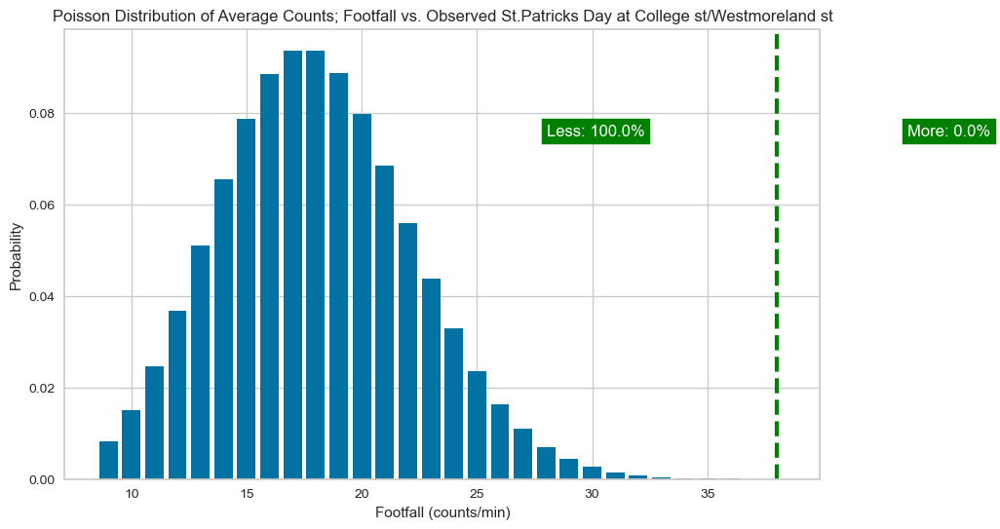

In [127]:
start = min(int(mu*0.5), k-1)
end = max(int(mu*1.5), k+1)
         
# create plottable range
footfall_range = np.arange(start, end)

#apply poisson probability mass function, (k, mu)
poisson_work = poisson.pmf(footfall_range, mu)

plt.figure(figsize=(10, 6))
plt.bar(footfall_range, poisson_work)
# f string here allows for insertion of variable {}
plt.title(f'Poisson Distribution of Average Counts; Footfall vs. Observed St.Patricks Day at {location}')
plt.xlabel('Footfall (counts/min)')
plt.ylabel('Probability')

# plot patrick counts and probablities
plt.axvline(x=k, color='green', linestyle='--', lw=3)
plt.text(k*0.85, (max(poisson_work))*0.8, f'Less: {lessP}%', horizontalalignment='right', color='white', backgroundcolor='green')
plt.text(k*1.15, (max(poisson_work))*0.8, f'More: {moreP}%', horizontalalignment='left', color='white', backgroundcolor='green')

plt.show()

## **3.8 Total Daily Footfall; Normal Distribution and the Central Limit Theorem**

The Normal Distribution has been a cornerstone in the development of modern statistics, providing foundational tools for estimating uncertainty and variability. While raw data may not always follow a normal distribution, the Central Limit Theorem tells us that the distribution of averages or totals from large samples will typically approximate the familiar "bell curve", allowing us to make assumptions about the data. From the above histograms of individual footfall counts across various locations, we can see they do not exhibit a normal distribution. However, by resampling these counts to calculate total daily footfall at each location, we may see that these totals align more closely with a normal distribution.  

In [128]:
# create a df of the total footfall counts per day
totalDaily_footfall23_df = footfall23_df.resample('D').sum()

### **3.8.1 Histograms**

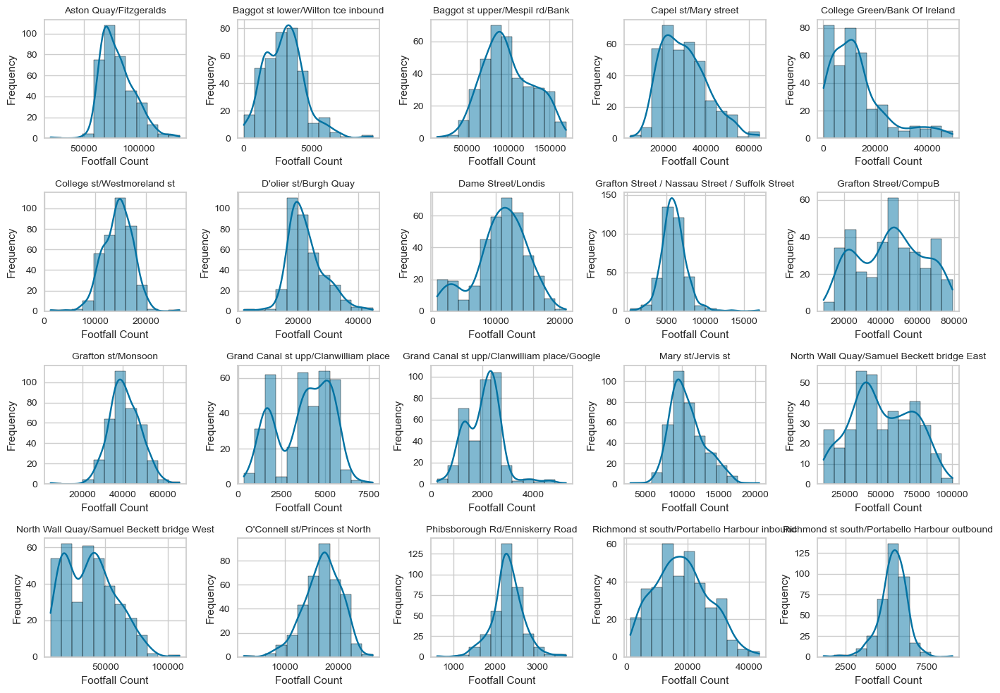

In [129]:
fig, axes = plt.subplots(nrows=4, ncols=5, figsize=(14, 10))
axes = axes.flatten()  # convert it to 1-D or long format to iterate over

# plot histograms of total footfall at each location
for i, column in enumerate(totalDaily_footfall23_df.columns):
    sns.histplot(totalDaily_footfall23_df[column], bins=12, ax=axes[i], kde=True) #kde or density plot/kernel density estimate, a smoothed version of the histogram
    axes[i].set_title(column, fontsize=10)
    axes[i].set_xlabel('Footfall Count')
    axes[i].set_ylabel('Frequency')

plt.tight_layout()
plt.show()

**Observations**
- The total daily counts at all locations overall appear to follow a normal distribution, especially compared with with the distribution of counts themselves
- There are several histograms which do not appear to conform to a bell shape, including Grafton Street/CompuB and Grand Canal st upp/Clanwilliam place

### **3.8.2 QQ Plots**

A QQ plot, or quantile-quantile plot, is visual representation of how closely a sample set is to a given distribution, in this case, a normal distribution. In this plot, the Z-scores from the sample data are plotted on the y-axis, and the corresponding quantiles of normal distribution are plotted on the x-axis. If the dataset follows the specified distribution, the plotted points will align closely with the red diagonal line. By applying QQ plots to the total footfall counts of each location, we can perform a check on the adherence of these totals to a normal distribution. Note that converting data to Z-scores does not force the data to become normally distributed, however works to put the data on the same scale as the normal distribution, for the purpose of comparison.

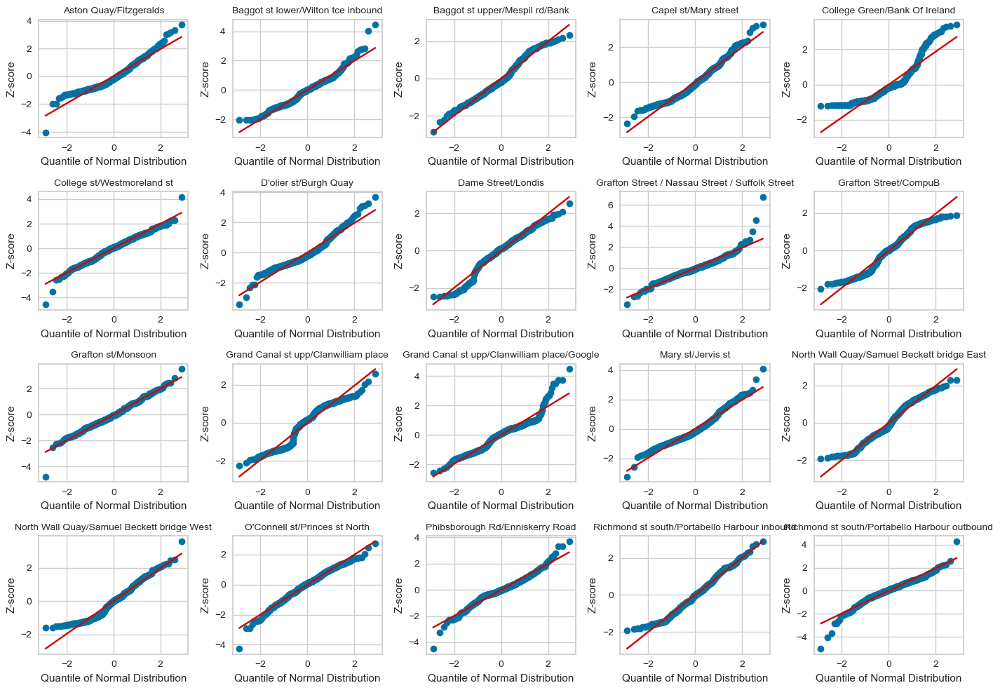

In [130]:
fig, axes = plt.subplots(nrows=4, ncols=5, figsize=(14, 10))
axes = axes.flatten()  # convert it to 1-D or long format to iterate over

z_totalDaily_footfall23_df = stats.zscore(totalDaily_footfall23_df) # convert to Z score

for i, column in enumerate(z_totalDaily_footfall23_df.columns):
    stats.probplot(z_totalDaily_footfall23_df[column], dist="norm", plot=axes[i])
    axes[i].set_title(column, fontsize=10)
    axes[i].set_xlabel('Quantile of Normal Distribution')
    axes[i].set_ylabel('Z-score')

plt.tight_layout()
plt.show()

**Observations**
- The QQ plots demonstrate more clearly how well the total daily counts conform to a normal distribution
- All locations generally match a normal distribution
- Locations such as "College st/Westmoreland st" and "Grafton st/Monsoon" reflect the normal quite well
- Locations such as "College Green/Bank Of Ireland" and "Grand Canal st upp/Clanwilliam place" reflect the normal poorly compared to other locations, however still follow reasonably well

## **3.9 Pushing Total Counts to the Limit**

We can use our data to explore the Central Limit Theorem, which describes the tendency of sampling distribution to become normal distributed as the sample size becomes greater. By taking the mean total footfall of a location, and sampling other totals at that location, we can visualise this process.

In [131]:
clt_location = "College Green/Bank Of Ireland"
mean_counts = totalDaily_footfall23_df[clt_location].mean()
mean_counts

13080.444436638129

In [132]:
# draw Random Samples and Calculate Sample Means
sample_sizes = [14, 30, 60]
sample_means = {size: [totalDaily_footfall23_df[clt_location].sample(size).mean() for _ in range(1000)] for size in sample_sizes}

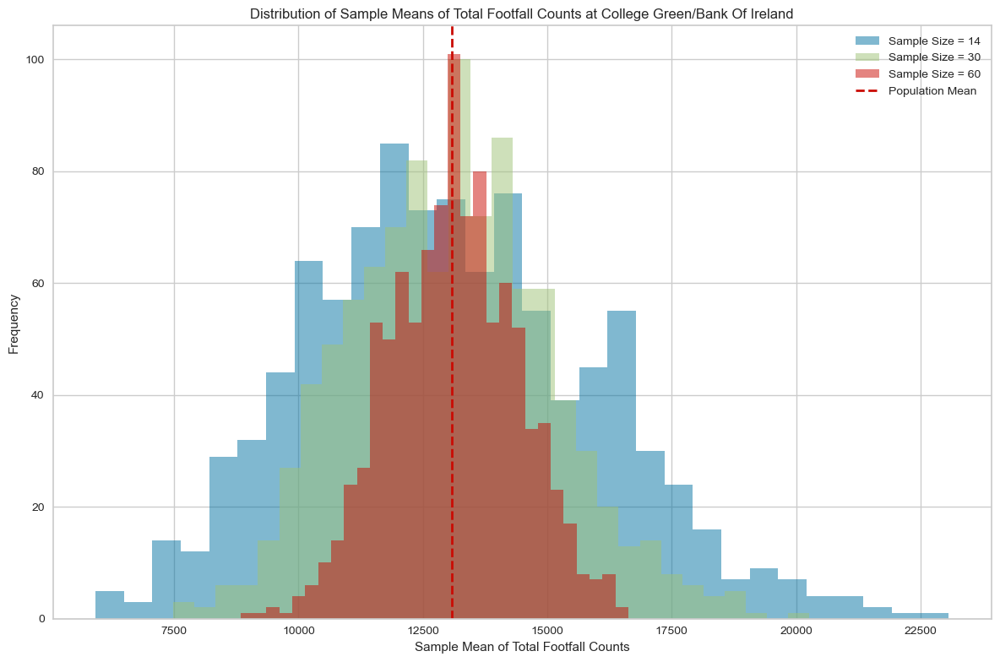

In [133]:
# Visualise the Sampling Distribution
plt.figure(figsize=(12, 8))

for size, means in sample_means.items():
    plt.hist(means, bins=30, alpha=0.5, label=f'Sample Size = {size}')

plt.axvline(mean_counts, color='r', linestyle='dashed', linewidth=2, label='Population Mean')
plt.title(f'Distribution of Sample Means of Total Footfall Counts at {clt_location}')
plt.xlabel('Sample Mean of Total Footfall Counts')
plt.ylabel('Frequency')
plt.legend()

plt.tight_layout()
plt.show()

## **3.10 Footfall Count Maps**

Visualisations of the average footfall during working hours at each counter location, in counts per minute. 

In [134]:
# reset index and rename for merge operation
index_poisson_patrick_df = poisson_patrick_df.reset_index().rename(columns={'index': 'Counter Location'})

In [135]:
# merge dfs
counterLocations_avgCount_df = pd.merge(counterLocations_df, index_poisson_patrick_df, on="Counter Location", how="left")

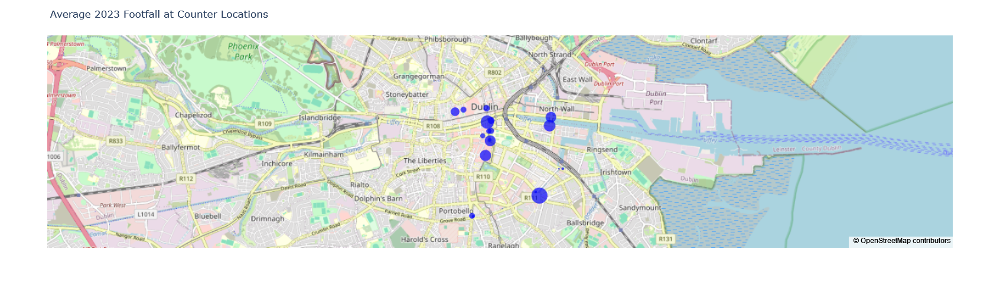

In [136]:
avg_counterLocations_avgCount_df_fig = px.scatter_mapbox(counterLocations_avgCount_df,
                        lat="Latitude",
                        lon="Longitude",
                        hover_name="Counter Location",
                        zoom=12,
                        size='Average, Mu',                   
                        mapbox_style="open-street-map")

avg_counterLocations_avgCount_df_fig.update_traces(marker=dict(color='blue'))
avg_counterLocations_avgCount_df_fig.update_layout(width=900,
                                    height=500,
                                    title="Average 2023 Footfall at Counter Locations")

avg_counterLocations_avgCount_df_fig.show()

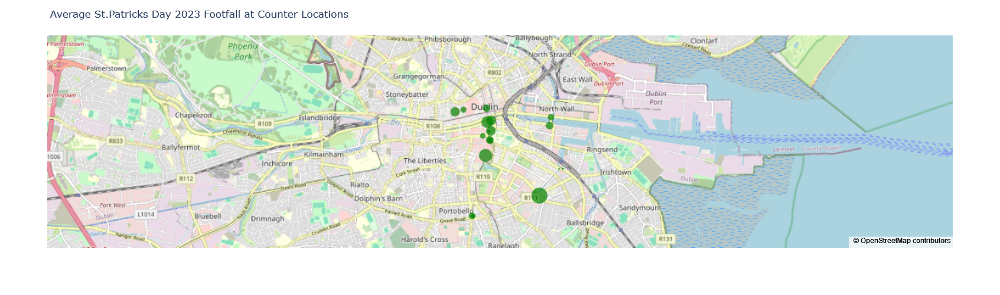

In [137]:
pat_counterLocations_avgCount_df_fig = px.scatter_mapbox(counterLocations_avgCount_df,
                        lat="Latitude",
                        lon="Longitude",
                        hover_name="Counter Location",
                        zoom=12,
                        size='Patrick, K',                   
                        mapbox_style="open-street-map")

pat_counterLocations_avgCount_df_fig.update_traces(marker=dict(color='green'))
pat_counterLocations_avgCount_df_fig.update_layout(width=900,
                                    height=500,
                                    title="Average St.Patricks Day 2023 Footfall at Counter Locations")

pat_counterLocations_avgCount_df_fig.show()

## **3.11 Dublin Debustled**

Dublin is known for the hustle and bustle of it's vibrant street life, with it's unique atmosphere and charm attracting thousands of tourists every year. Below we will deconstruct and rank the busiest steets by footfall count. 

In [138]:
poisson_patrick_df = poisson_patrick_df.sort_values("Average, Mu", ascending=0)

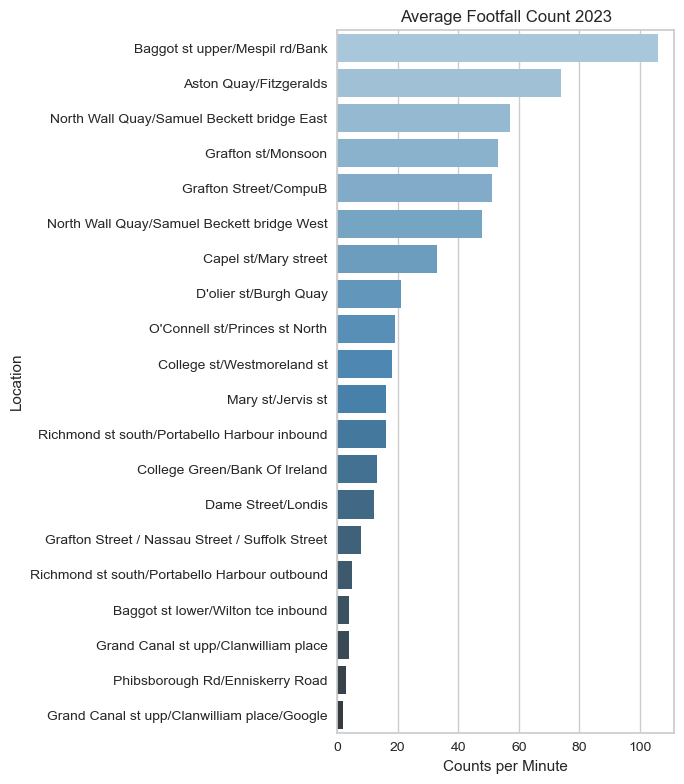

In [139]:
plt.figure(figsize=(7, 8))
sns.barplot(y=poisson_patrick_df.index,
            x=poisson_patrick_df["Average, Mu"],
            orient='h',
            palette= "Blues_d"
           )
plt.title('Average Footfall Count 2023')
plt.ylabel('Location')
plt.xlabel('Counts per Minute')
plt.tight_layout()

In [140]:
poisson_patrick_df = poisson_patrick_df.sort_values("Patrick, K", ascending=0)

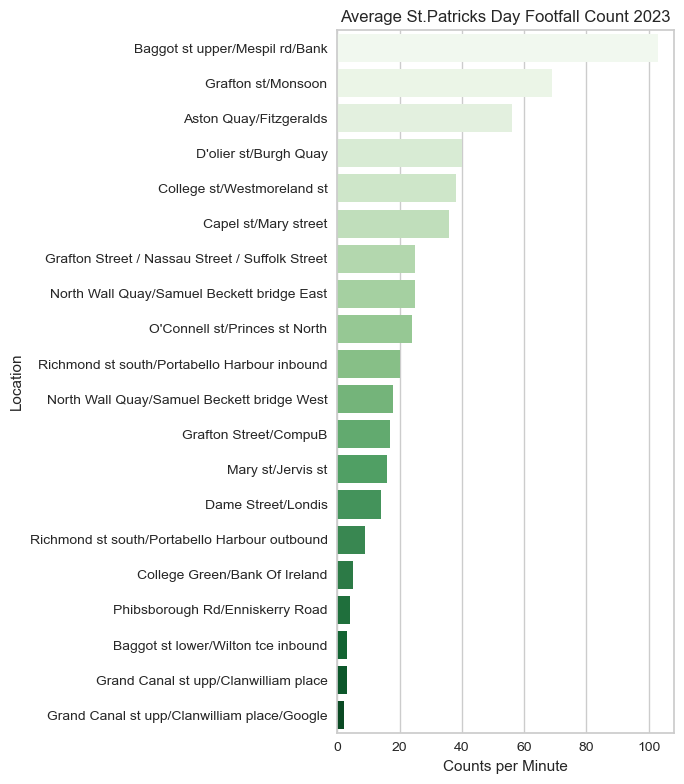

In [141]:
plt.figure(figsize=(7, 8))
sns.barplot(y=poisson_patrick_df.index,
            x=poisson_patrick_df["Patrick, K"],
            orient='h',
            palette= "Greens"
           )
plt.title('Average St.Patricks Day Footfall Count 2023')
plt.ylabel('Location')
plt.xlabel('Counts per Minute')
plt.tight_layout()

## **3.12 Correlation Matrices**

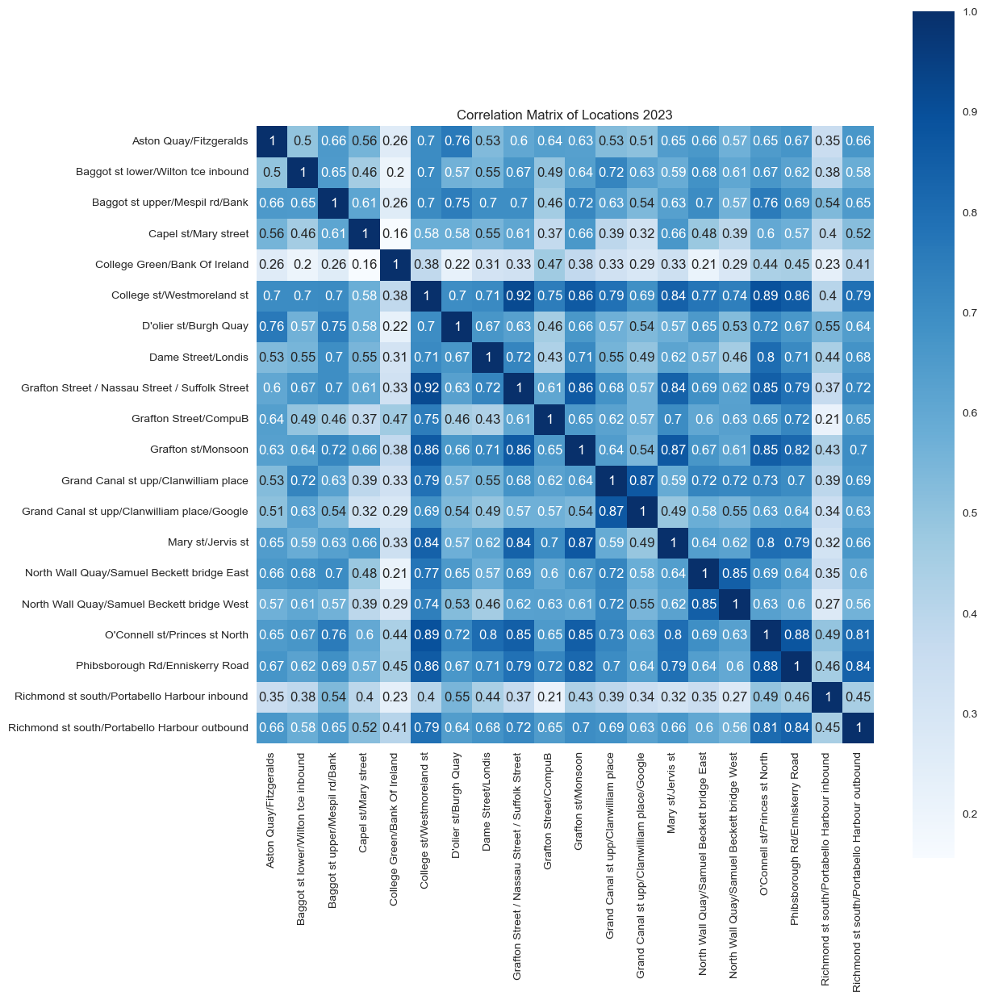

In [142]:
plt.figure(figsize=(13, 13))
plt.title('Correlation Matrix of Locations 2023')

sns.heatmap(footfall23_df.corr(), annot=True, square=True, cmap="Blues")
plt.tight_layout()

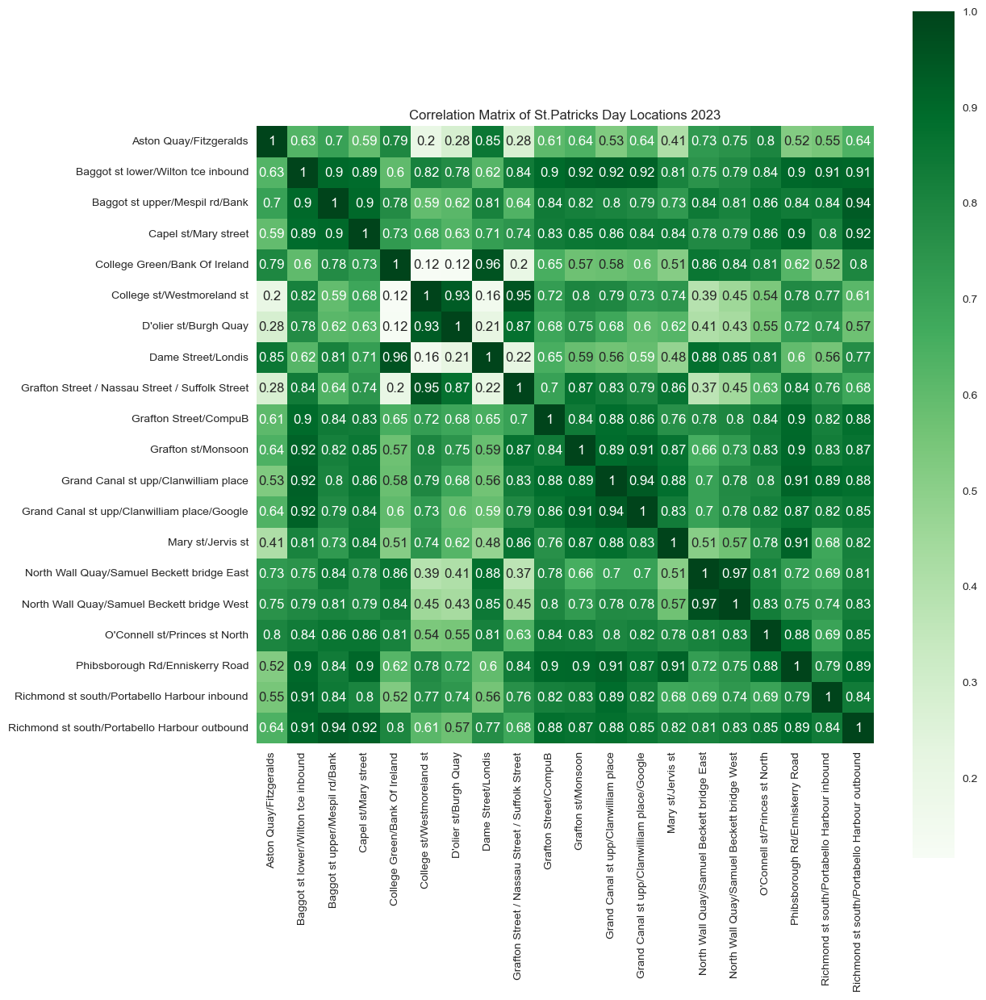

In [143]:
plt.figure(figsize=(13, 13))
plt.title('Correlation Matrix of St.Patricks Day Locations 2023')

sns.heatmap(patrick23_df.corr(), annot=True, square=True, cmap='Greens')
plt.tight_layout()

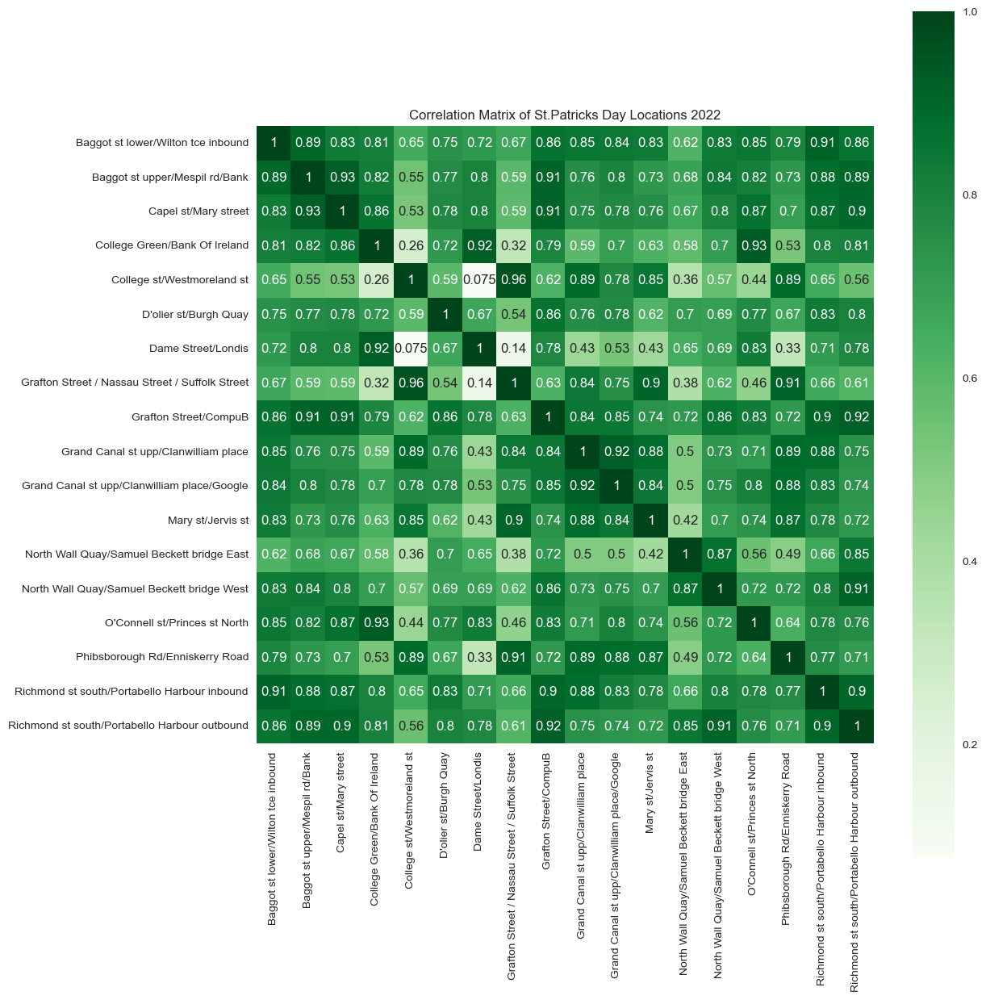

In [144]:
plt.figure(figsize=(13, 13))
plt.title('Correlation Matrix of St.Patricks Day Locations 2022')

sns.heatmap(patrick22_red_df.corr(), annot=True, square=True, cmap='Greens')
plt.tight_layout()

# **4. Machine Learning: k-means Clustering**

In [145]:
#pip install yellowbrick

In [146]:
# Assign scalar function
sc = StandardScaler()

In [147]:
# create ml df to apply ml
footfall23_ml = footfall23_df

In [148]:
# creatr date and hour column from the datetime index
footfall23_ml['Date'] = footfall23_ml.index.date
footfall23_ml['Hour'] = footfall23_ml.index.hour

## **4.1 k-means Clustering of "College st/Westmoreland"**

In [149]:
# create pivot table: values specifies column; index specifies row labels, column specifies column labels
colWest_ml = footfall23_ml.pivot_table(values='College st/Westmoreland st', index='Date', columns='Hour')

In [150]:
# check for NaNs
colWest_ml.isnull().sum()
# fill missing value # Note: unsure how NaNs get created here
colWest_ml = colWest_ml.fillna(method='ffill')

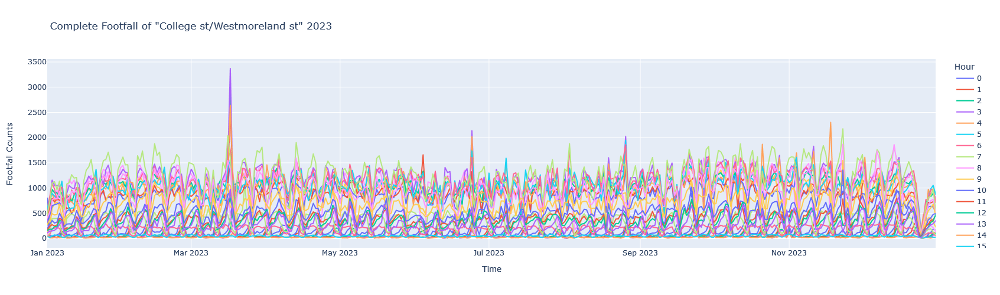

In [151]:
colWest_ml_fig = px.line(colWest_ml, y=colWest_ml.columns, title='Complete Footfall of "College st/Westmoreland st" 2023')

colWest_ml_fig.update_layout(
    xaxis_title="Time",
    yaxis_title="Footfall Counts",
    legend_title="Hour",
    width=1500,
    height=500
    )

colWest_ml_fig.show()

In [152]:
# normalize data
colWest_norm_ml = sc.fit_transform(colWest_ml)

In [153]:
# sets kmeans
kmeans = KMeans(random_state=42)

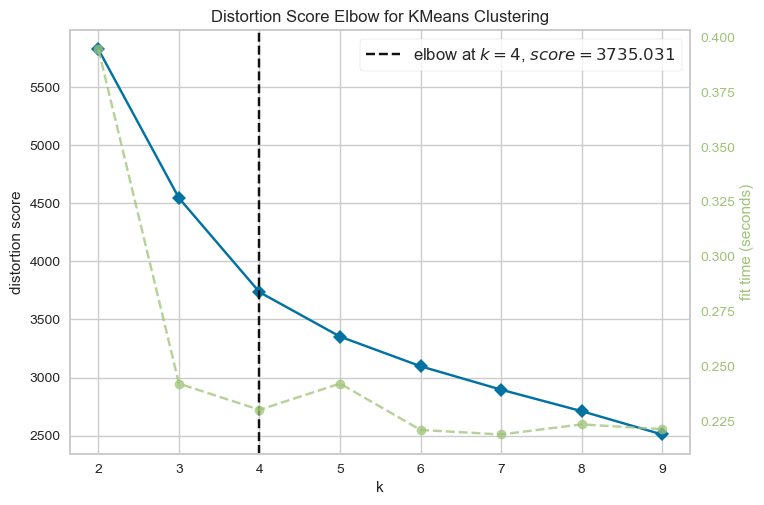

<Axes: title={'center': 'Distortion Score Elbow for KMeans Clustering'}, xlabel='k', ylabel='distortion score'>

In [154]:
# yellowbrick visualizer to display, distortion is essentially inertia
visualizer = KElbowVisualizer(kmeans, k=(2,10))
# fit data to yb visualizer
visualizer.fit(colWest_norm_ml)        
visualizer.show()

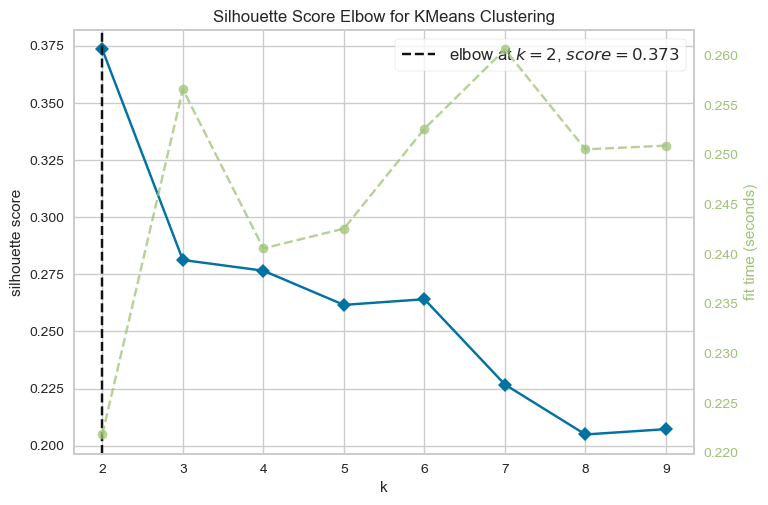

<Axes: title={'center': 'Silhouette Score Elbow for KMeans Clustering'}, xlabel='k', ylabel='silhouette score'>

In [155]:
# yellowbrick visualizer to display silhouette score at each k
visualizer = KElbowVisualizer(kmeans, k=(2,10), metric="silhouette")
# fit data to yb visualizer
visualizer.fit(colWest_norm_ml)        
visualizer.show()

### **4.1.1 Silhouette Diagrams of "College st/Westmoreland"**

**k=2 Clustering of "College st/Westmoreland"**

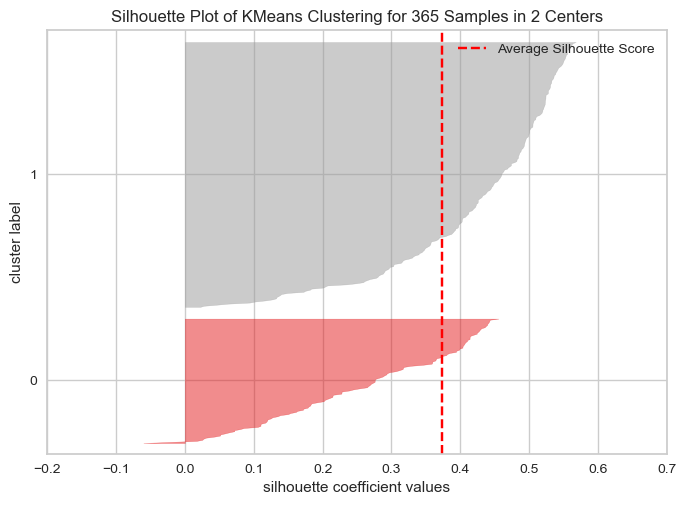

<Axes: title={'center': 'Silhouette Plot of KMeans Clustering for 365 Samples in 2 Centers'}, xlabel='silhouette coefficient values', ylabel='cluster label'>

In [156]:
kmeans = KMeans(n_clusters = 2, random_state=42)

sil_visualizer = SilhouetteVisualizer(kmeans)
sil_visualizer.fit(colWest_norm_ml)    
sil_visualizer.show()

In [157]:
# from sklearn silhouette can be directly called
silhouette_score(colWest_norm_ml, kmeans.labels_)

0.3733413453639108

**k=3 Clustering of "College st/Westmoreland"**

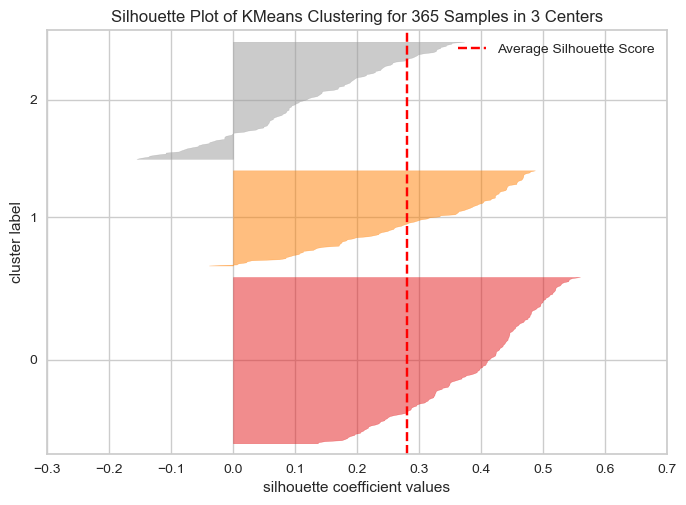

<Axes: title={'center': 'Silhouette Plot of KMeans Clustering for 365 Samples in 3 Centers'}, xlabel='silhouette coefficient values', ylabel='cluster label'>

In [158]:
kmeans = KMeans(n_clusters = 3, random_state=42)

sil_visualizer = SilhouetteVisualizer(kmeans)
sil_visualizer.fit(colWest_norm_ml)    
sil_visualizer.show()

In [159]:
# from sklearn silhouette can be directly called
silhouette_score(colWest_norm_ml, kmeans.labels_)

0.28125588267460266

**k=4 Clustering of "College st/Westmoreland"**

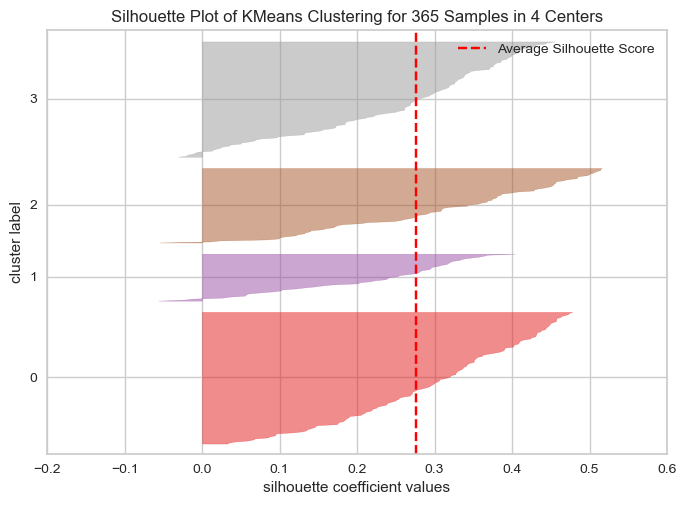

<Axes: title={'center': 'Silhouette Plot of KMeans Clustering for 365 Samples in 4 Centers'}, xlabel='silhouette coefficient values', ylabel='cluster label'>

In [160]:
kmeans = KMeans(n_clusters = 4, random_state=42)

sil_visualizer = SilhouetteVisualizer(kmeans)
sil_visualizer.fit(colWest_norm_ml)    
sil_visualizer.show()

In [161]:
# from sklearn silhouette can be directly called
silhouette_score(colWest_norm_ml, kmeans.labels_)

0.27656855001376435

**k=5 Clustering of "College st/Westmoreland"**

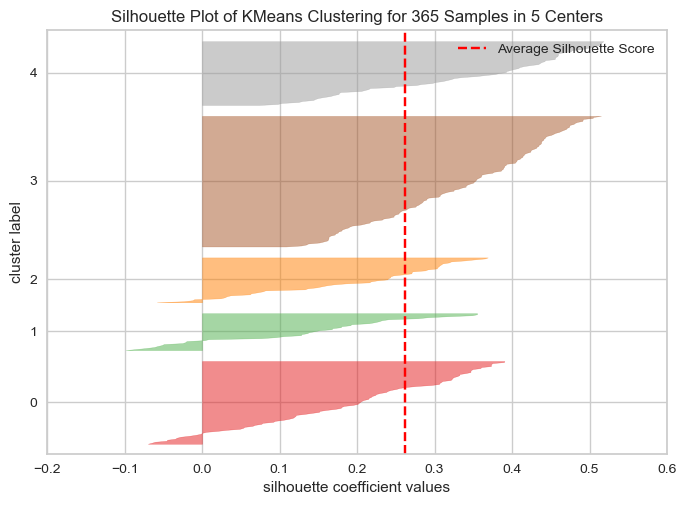

<Axes: title={'center': 'Silhouette Plot of KMeans Clustering for 365 Samples in 5 Centers'}, xlabel='silhouette coefficient values', ylabel='cluster label'>

In [162]:
kmeans = KMeans(n_clusters = 5, random_state=42)

sil_visualizer = SilhouetteVisualizer(kmeans)
sil_visualizer.fit(colWest_norm_ml)    
sil_visualizer.show()

In [163]:
# from sklearn silhouette can be directly called
silhouette_score(colWest_norm_ml, kmeans.labels_)

0.26161296424829406

**k=6 Clustering of "College st/Westmoreland"**

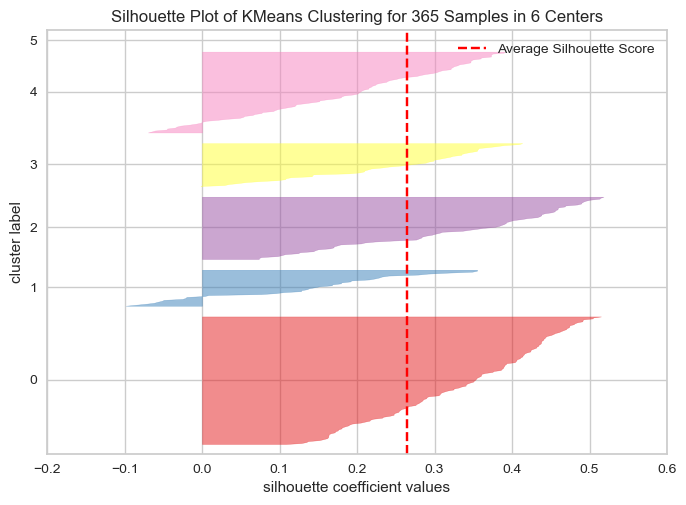

<Axes: title={'center': 'Silhouette Plot of KMeans Clustering for 365 Samples in 6 Centers'}, xlabel='silhouette coefficient values', ylabel='cluster label'>

In [164]:
kmeans = KMeans(n_clusters = 6, random_state=42)

sil_visualizer = SilhouetteVisualizer(kmeans)
sil_visualizer.fit(colWest_norm_ml)    
sil_visualizer.show()

In [165]:
# from sklearn silhouette can be directly called
silhouette_score(colWest_norm_ml, kmeans.labels_)

0.26410053764883423

### **4.1.2 Heatmap Diagrams of "College st/Westmoreland"** <br>
For illutrative and comparitive purposes, we will create heatmaps of each k-value

**k=2 Heatmap of "College st/Westmoreland" Clustering** 

In [166]:
# choose clusters
n_clusters = 2
# set kmeans
kmeans = KMeans(n_clusters=n_clusters, random_state=42)
# perform k means
k_colWest_ml = kmeans.fit_predict(colWest_norm_ml)

In [167]:
# show cluster labels

# k_colWest_ml

In [168]:
#add cluster labels to df
clustered_colWest_ml = colWest_ml
clustered_colWest_ml["Cluster"] = k_colWest_ml

In [169]:
# show clusters

# clustered_colWest_ml

In [170]:
# define clusters for plotting later
k2_centroid_colWest_ml = sc.inverse_transform(kmeans.cluster_centers_)

In [171]:
# how many days per cluster?
clustered_colWest_ml['Cluster'].value_counts()

Cluster
1    248
0    117
Name: count, dtype: int64

In [172]:
# sort by cluster
clustered_sort_colWest_ml = clustered_colWest_ml.sort_values("Cluster")

In [173]:
# show sorted clusters

# clustered_sort_colWest_ml

In [174]:
#drop cluster column for heat map
heatmap_colWest_ml = clustered_sort_colWest_ml.drop("Cluster", axis=1)

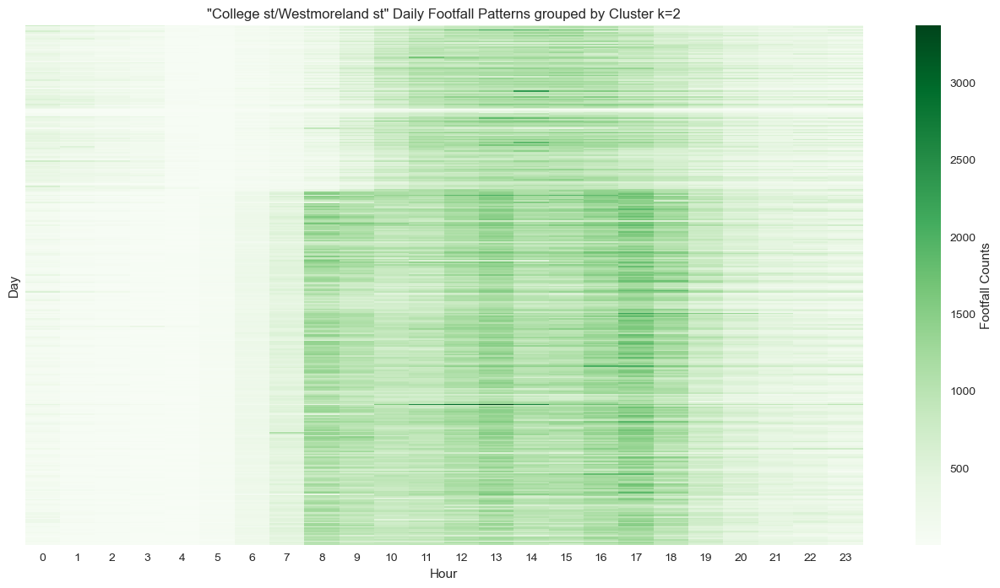

In [175]:
# plot heat map, yticklabels=False hides y-axis labels
plt.figure(figsize=(16, 8))
sns.heatmap(heatmap_colWest_ml, cmap='Greens', yticklabels=False, cbar_kws={'label': 'Footfall Counts'})
plt.title(f'"College st/Westmoreland st" Daily Footfall Patterns grouped by Cluster k={n_clusters}')
plt.xlabel('Hour')
plt.ylabel('Day')

plt.show()

**k=3 Heatmap of "College st/Westmoreland" Clustering** 

In [176]:
# choose clusters
n_clusters = 3
# set kmeans
kmeans = KMeans(n_clusters=n_clusters, random_state=42)
# perform k means
k_colWest_ml = kmeans.fit_predict(colWest_norm_ml)

In [177]:
# show cluster labels

# k_colWest_ml

In [178]:
#add cluster labels to df
clustered_colWest_ml = colWest_ml
clustered_colWest_ml["Cluster"] = k_colWest_ml

In [179]:
# show clusters

# clustered_colWest_ml

In [180]:
# define clusters for plotting later
k3_centroid_colWest_ml = sc.inverse_transform(kmeans.cluster_centers_)

In [181]:
# how many days per cluster?
clustered_colWest_ml['Cluster'].value_counts()

Cluster
0    160
2    113
1     92
Name: count, dtype: int64

In [182]:
# sort by cluster
clustered_sort_colWest_ml = clustered_colWest_ml.sort_values("Cluster")

In [183]:
# show sorted clusters

# clustered_sort_colWest_ml

In [184]:
#drop cluster column for heat map
heatmap_colWest_ml = clustered_sort_colWest_ml.drop("Cluster", axis=1)

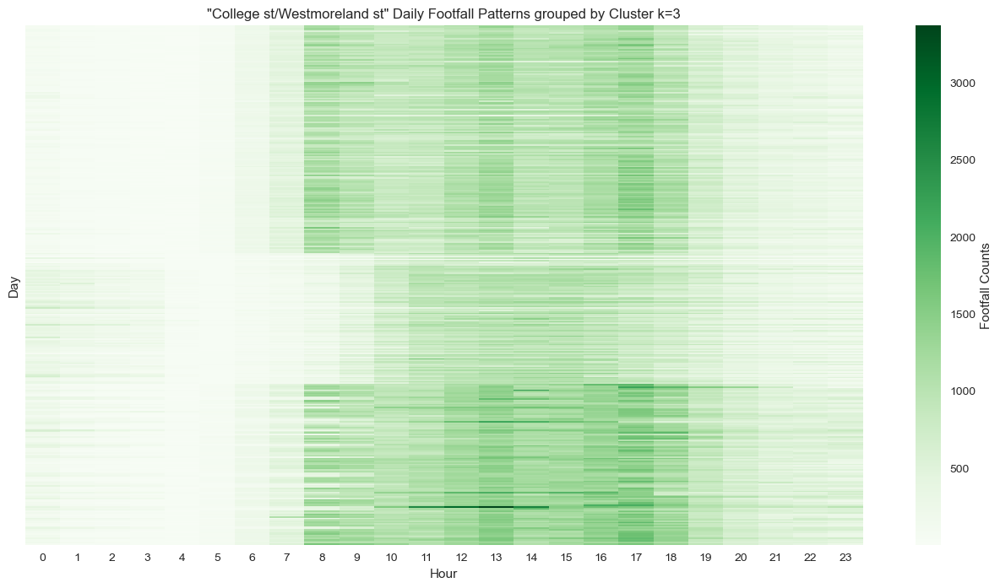

In [185]:
# plot heat map, yticklabels=False hides y-axis labels
plt.figure(figsize=(16, 8))
sns.heatmap(heatmap_colWest_ml, cmap='Greens', yticklabels=False, cbar_kws={'label': 'Footfall Counts'})
plt.title(f'"College st/Westmoreland st" Daily Footfall Patterns grouped by Cluster k={n_clusters}')
plt.xlabel('Hour')
plt.ylabel('Day')

plt.show()

**k=4 Heatmap of "College st/Westmoreland" Clustering** 

In [186]:
# choose clusters
n_clusters = 4
# set kmeans
kmeans = KMeans(n_clusters=n_clusters, random_state=42)
# perform k means
k_colWest_ml = kmeans.fit_predict(colWest_norm_ml)

In [187]:
# show cluster labels

# k_colWest_ml

In [188]:
#add cluster labels to df
clustered_colWest_ml = colWest_ml
clustered_colWest_ml["Cluster"] = k_colWest_ml

In [189]:
# show clusters

# clustered_colWest_ml

In [190]:
# define clusters for plotting later
k4_centroid_colWest_ml = sc.inverse_transform(kmeans.cluster_centers_)

In [191]:
# how many days per cluster?
clustered_colWest_ml['Cluster'].value_counts()

Cluster
0    130
3    114
2     74
1     47
Name: count, dtype: int64

In [192]:
# sort by cluster
clustered_sort_colWest_ml = clustered_colWest_ml.sort_values("Cluster")

In [193]:
# show sorted clusters

# clustered_sort_colWest_ml

In [194]:
#drop cluster column for heat map
heatmap_colWest_ml = clustered_sort_colWest_ml.drop("Cluster", axis=1)

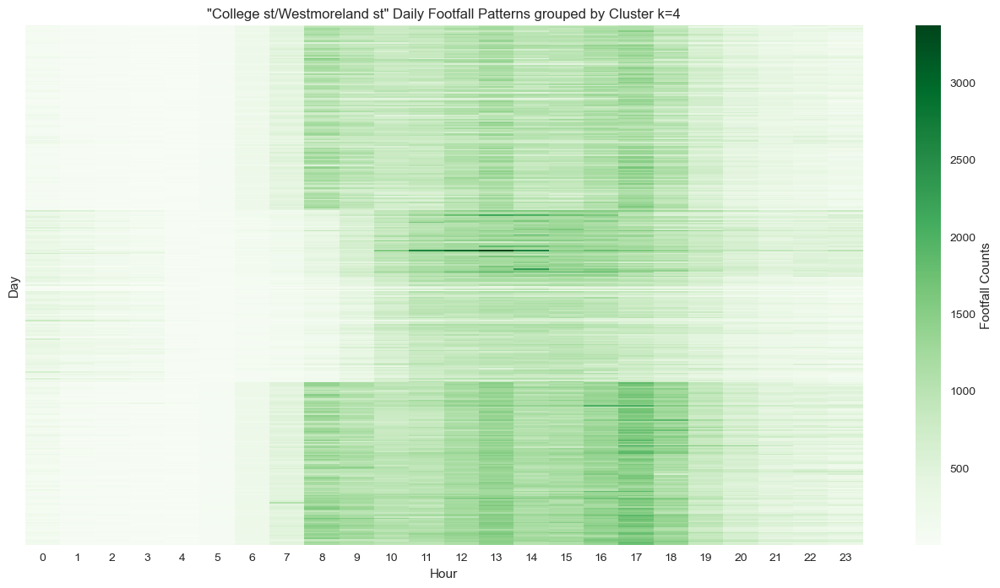

In [195]:
# plot heat map, yticklabels=False hides y-axis labels
plt.figure(figsize=(16, 8))
sns.heatmap(heatmap_colWest_ml, cmap='Greens', yticklabels=False, cbar_kws={'label': 'Footfall Counts'})
plt.title(f'"College st/Westmoreland st" Daily Footfall Patterns grouped by Cluster k={n_clusters}')
plt.xlabel('Hour')
plt.ylabel('Day')

plt.show()

**k=5 Heatmap of "College st/Westmoreland" Clustering** 

In [196]:
# choose clusters
n_clusters = 5
# set kmeans
kmeans = KMeans(n_clusters=n_clusters, random_state=42)
# perform k means
k_colWest_ml = kmeans.fit_predict(colWest_norm_ml)

In [197]:
# show cluster labels

# k_colWest_ml

In [198]:
#add cluster labels to df
clustered_colWest_ml = colWest_ml
clustered_colWest_ml["Cluster"] = k_colWest_ml

In [199]:
# create label df for comparison
k5_colWest_ml = k_colWest_ml

In [200]:
# show clusters

# clustered_colWest_ml

In [201]:
# define clusters for plotting later
k5_centroid_colWest_ml = sc.inverse_transform(kmeans.cluster_centers_)

In [202]:
# how many days per cluster?
clustered_colWest_ml['Cluster'].value_counts()

Cluster
3    132
0     84
4     65
2     46
1     38
Name: count, dtype: int64

In [203]:
# sort by cluster
clustered_sort_colWest_ml = clustered_colWest_ml.sort_values("Cluster")

In [204]:
# show sorted clusters

# clustered_sort_colWest_ml

In [205]:
#drop cluster column for heat map
heatmap_colWest_ml = clustered_sort_colWest_ml.drop("Cluster", axis=1)

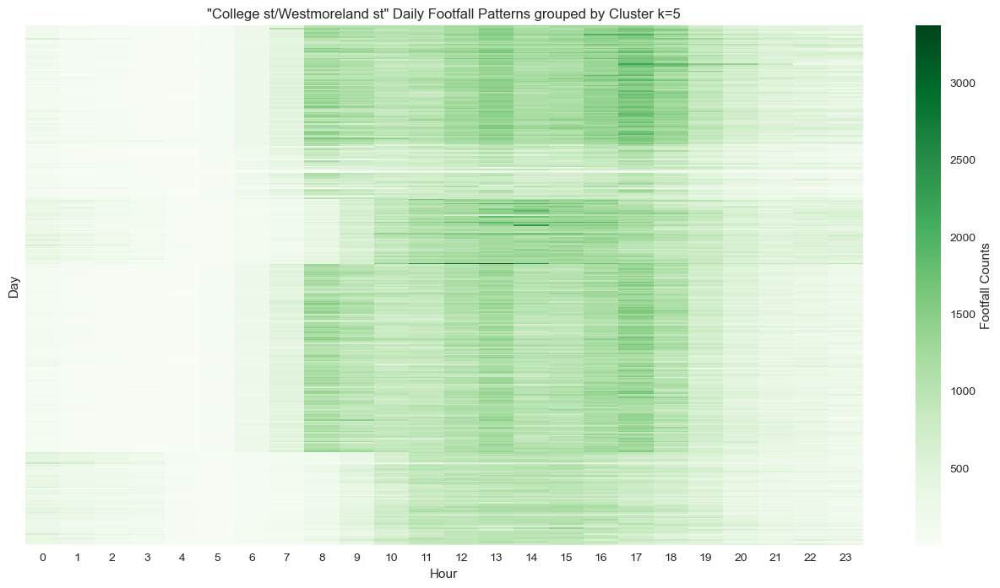

In [206]:
# plot heat map, yticklabels=False hides y-axis labels
plt.figure(figsize=(16, 8))
sns.heatmap(heatmap_colWest_ml, cmap='Greens', yticklabels=False, cbar_kws={'label': 'Footfall Counts'})
plt.title(f'"College st/Westmoreland st" Daily Footfall Patterns grouped by Cluster k={n_clusters}')
plt.xlabel('Hour')
plt.ylabel('Day')

plt.show()

In [207]:
#select dates for cluster
dates_colWest_ml = clustered_colWest_ml[clustered_colWest_ml['Cluster'] == 2]

In [208]:
# list dates for Cluster
dates_colWest_ml.index

Index([2023-01-21, 2023-01-28, 2023-02-11, 2023-02-18, 2023-02-25, 2023-03-04,
       2023-03-17, 2023-03-18, 2023-03-25, 2023-04-01, 2023-04-07, 2023-04-08,
       2023-04-15, 2023-04-29, 2023-05-06, 2023-05-13, 2023-05-20, 2023-05-27,
       2023-06-03, 2023-06-04, 2023-06-24, 2023-07-01, 2023-07-08, 2023-07-22,
       2023-07-29, 2023-08-05, 2023-08-19, 2023-08-26, 2023-09-02, 2023-09-09,
       2023-09-16, 2023-09-23, 2023-09-30, 2023-10-07, 2023-10-14, 2023-10-21,
       2023-10-28, 2023-10-29, 2023-11-04, 2023-11-11, 2023-11-18, 2023-11-25,
       2023-12-02, 2023-12-09, 2023-12-16, 2023-12-22],
      dtype='object', name='Date')

**k=6 Heatmap of "College st/Westmoreland" Clustering** 

In [209]:
# choose clusters
n_clusters = 6
# set kmeans
kmeans = KMeans(n_clusters=n_clusters, random_state=42)
# perform k means
k_colWest_ml = kmeans.fit_predict(colWest_norm_ml)

In [210]:
# show cluster labels

# k_colWest_ml

In [211]:
#add cluster labels to df
clustered_colWest_ml = colWest_ml
clustered_colWest_ml["Cluster"] = k_colWest_ml

In [212]:
# show clusters

# clustered_colWest_ml

In [213]:
# define clusters for plotting later
k6_centroid_colWest_ml = sc.inverse_transform(kmeans.cluster_centers_)

In [214]:
# how many days per cluster?
clustered_colWest_ml['Cluster'].value_counts()

Cluster
0    132
4     84
2     65
3     45
1     38
5      1
Name: count, dtype: int64

In [215]:
# sort by cluster
clustered_sort_colWest_ml = clustered_colWest_ml.sort_values("Cluster")

In [216]:
# show sorted clusters

# clustered_sort_colWest_ml

In [217]:
#drop cluster column for heat map
heatmap_colWest_ml = clustered_sort_colWest_ml.drop("Cluster", axis=1)

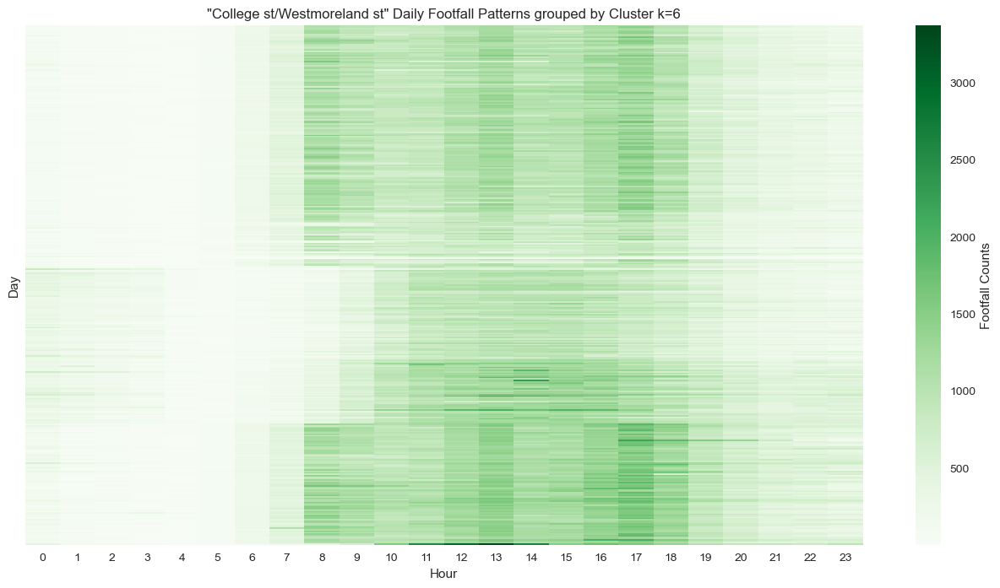

In [218]:
# plot heat map, yticklabels=False hides y-axis labels
plt.figure(figsize=(16, 8))
sns.heatmap(heatmap_colWest_ml, cmap='Greens', yticklabels=False, cbar_kws={'label': 'Footfall Counts'})
plt.title(f'"College st/Westmoreland st" Daily Footfall Patterns grouped by Cluster k={n_clusters}')
plt.xlabel('Hour')
plt.ylabel('Day')

plt.show()

### **4.1.3 Graphing Centroids of "College st/Westmoreland"**

In [219]:
k2_centroid_colWest_ml

array([[ 311.20512821,  232.27350427,  180.96153846,  139.7008547 ,
          39.4957265 ,   30.18803419,   86.74358974,  135.60683761,
         259.92307692,  469.71794872,  736.77777778,  929.12820513,
         980.94017094, 1045.05982906, 1072.4957265 , 1065.09401709,
         998.91452991,  880.12820513,  744.52991453,  604.97435897,
         447.73504274,  350.00854701,  343.57264957,  314.62393162],
       [ 118.07258065,   51.47580645,   37.56854839,   23.43145161,
          16.28225806,   60.46370968,  224.52419355,  452.40322581,
        1104.56048387,  980.68145161,  878.42741935,  919.22580645,
        1100.69758065, 1261.125     , 1032.77016129, 1045.16129032,
        1214.26209677, 1385.16532258, 1103.63306452,  745.20967742,
         544.67741935,  423.32258065,  385.28225806,  317.92741935]])

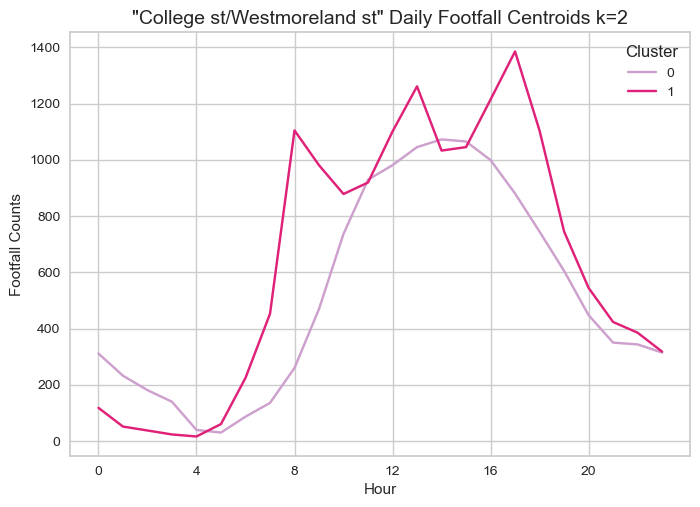

In [220]:
# conver to df for plotting
k_centroid_colWest_ml = pd.DataFrame(k2_centroid_colWest_ml).reset_index().melt(id_vars='index')
# name columns
k_centroid_colWest_ml.columns = ['Cluster', 'Hour', 'Footfall Counts']

# plot
sns.lineplot(data=k_centroid_colWest_ml, x='Hour', y='Footfall Counts', hue='Cluster',  palette='PuRd')
plt.xticks(ticks=[0,4,8,12,16,20])
plt.title('"College st/Westmoreland st" Daily Footfall Centroids k=2', fontsize=14)
plt.show()

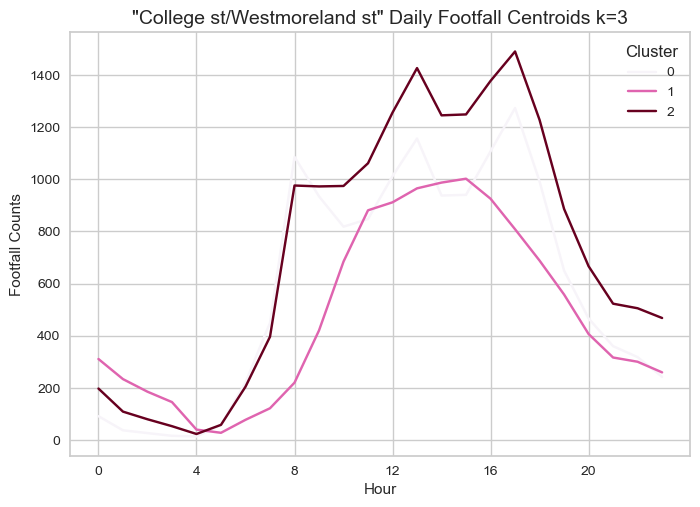

In [221]:
# conver to df for plotting
k_centroid_colWest_ml = pd.DataFrame(k3_centroid_colWest_ml).reset_index().melt(id_vars='index')
# name columns
k_centroid_colWest_ml.columns = ['Cluster', 'Hour', 'Footfall Counts']

# plot
sns.lineplot(data=k_centroid_colWest_ml, x='Hour', y='Footfall Counts', hue='Cluster', palette='PuRd')
plt.xticks(ticks=[0,4,8,12,16,20])
plt.title('"College st/Westmoreland st" Daily Footfall Centroids k=3', fontsize=14)
plt.show()

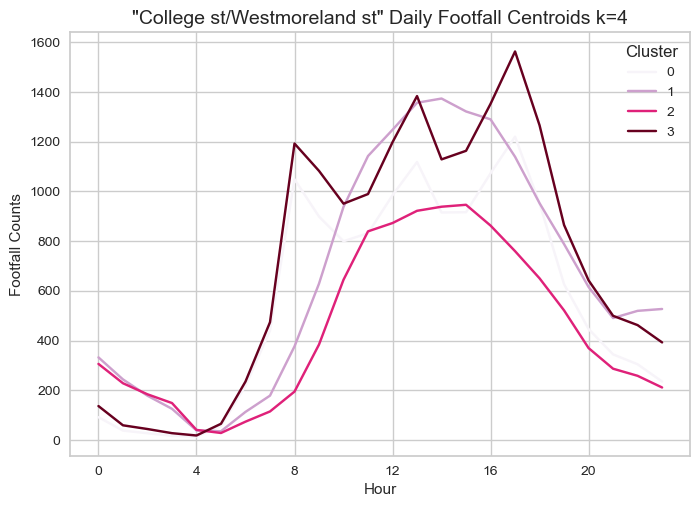

In [222]:
# convert to df for plotting
k_centroid_colWest_ml = pd.DataFrame(k4_centroid_colWest_ml).reset_index().melt(id_vars='index')
# name columns
k_centroid_colWest_ml.columns = ['Cluster', 'Hour', 'Footfall Counts']

# plot
sns.lineplot(data=k_centroid_colWest_ml, x='Hour', y='Footfall Counts', hue='Cluster', palette='PuRd')
plt.xticks(ticks=[0,4,8,12,16,20])
plt.title('"College st/Westmoreland st" Daily Footfall Centroids k=4', fontsize=14)
plt.show()

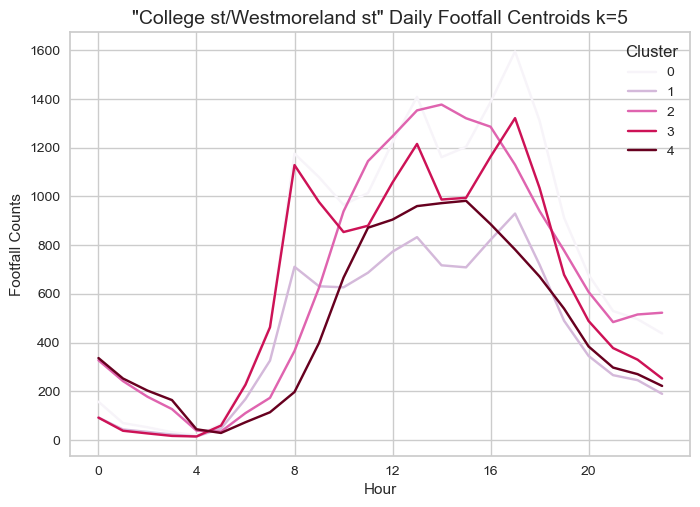

In [223]:
# convert to df for plotting
k_centroid_colWest_ml = pd.DataFrame(k5_centroid_colWest_ml).reset_index().melt(id_vars='index')
# name columns
k_centroid_colWest_ml.columns = ['Cluster', 'Hour', 'Footfall Counts']

# plot
sns.lineplot(data=k_centroid_colWest_ml, x='Hour', y='Footfall Counts', hue='Cluster', palette='PuRd')
plt.xticks(ticks=[0,4,8,12,16,20])
plt.title('"College st/Westmoreland st" Daily Footfall Centroids k=5', fontsize=14)
plt.show()

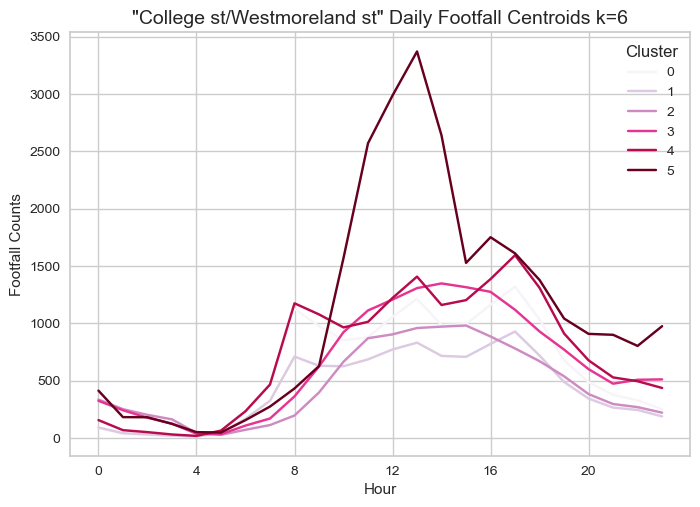

In [224]:
# conver to df for plotting
k_centroid_colWest_ml = pd.DataFrame(k6_centroid_colWest_ml).reset_index().melt(id_vars='index')
# name columns
k_centroid_colWest_ml.columns = ['Cluster', 'Hour', 'Footfall Counts']

# plot
sns.lineplot(data=k_centroid_colWest_ml, x='Hour', y='Footfall Counts', hue='Cluster', palette='PuRd')
plt.xticks(ticks=[0,4,8,12,16,20])
plt.title('"College st/Westmoreland st" Daily Footfall Centroids k=6', fontsize=14)
plt.show()

## **4.2 k-means Clustering of "Grafton Street / Nassau Street / Suffolk Street"**

In [225]:
# create pivot table: values specifies column; index specifies row labels, column specifies column labels
graNasSuff_ml = footfall23_ml.pivot_table(values='Grafton Street / Nassau Street / Suffolk Street', index='Date', columns='Hour')

In [226]:
# check for NaNs
graNasSuff_ml.isnull().sum()
# fill missing value # Note: unsure how NaNs get created here
graNasSuff_ml = graNasSuff_ml.fillna(method='ffill')

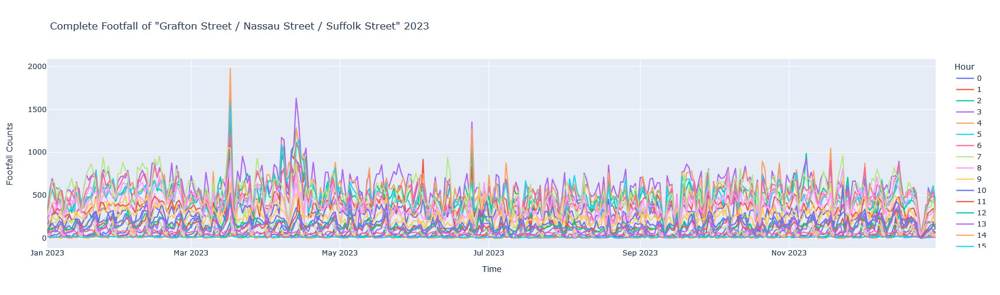

In [227]:
graNasSuff_ml_fig = px.line(graNasSuff_ml, y=graNasSuff_ml.columns, title='Complete Footfall of "Grafton Street / Nassau Street / Suffolk Street" 2023')

graNasSuff_ml_fig.update_layout(
    xaxis_title="Time",
    yaxis_title="Footfall Counts",
    legend_title="Hour",
    width=1500,
    height=500
    )

graNasSuff_ml_fig.show()

In [228]:
# normalize data
graNasSuff_norm_ml = sc.fit_transform(graNasSuff_ml)

In [229]:
# sets kmeans
kmeans = KMeans(random_state=42)

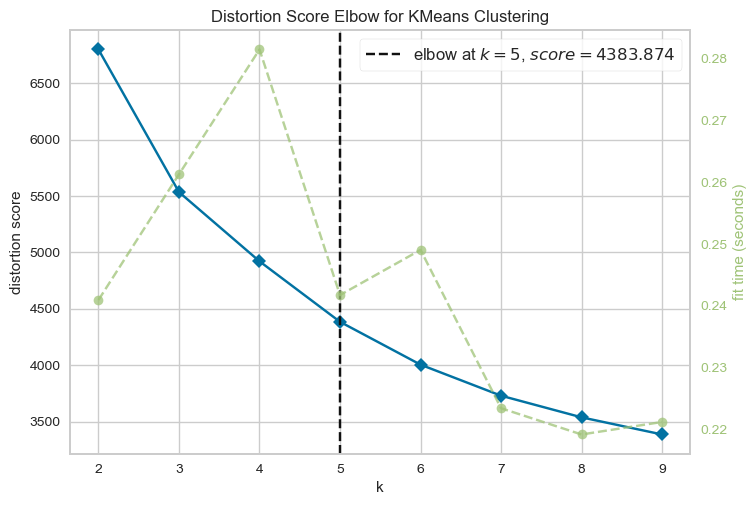

<Axes: title={'center': 'Distortion Score Elbow for KMeans Clustering'}, xlabel='k', ylabel='distortion score'>

In [230]:
# yellowbrick visualizer to display, distortion is essentially inertia
visualizer = KElbowVisualizer(kmeans, k=(2,10))
# fit data to yb visualizer
visualizer.fit(graNasSuff_norm_ml)        
visualizer.show()

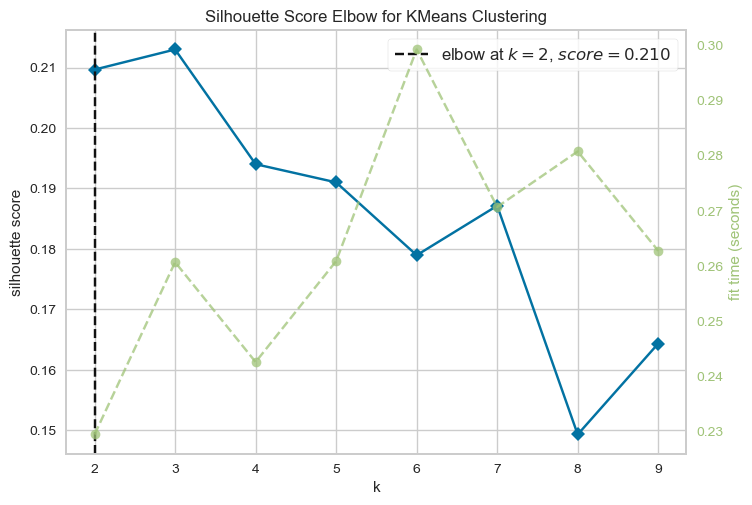

<Axes: title={'center': 'Silhouette Score Elbow for KMeans Clustering'}, xlabel='k', ylabel='silhouette score'>

In [231]:
# yellowbrick visualizer to display silhouette score at each k
visualizer = KElbowVisualizer(kmeans, k=(2,10), metric="silhouette")
# fit data to yb visualizer
visualizer.fit(graNasSuff_norm_ml)        
visualizer.show()

**k=5 Clustering of "Complete Footfall of "Grafton Street / Nassau Street / Suffolk Street" 2023"**

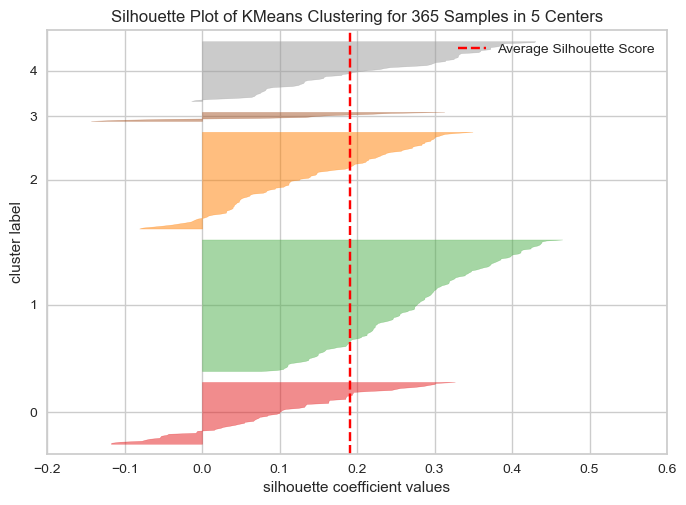

<Axes: title={'center': 'Silhouette Plot of KMeans Clustering for 365 Samples in 5 Centers'}, xlabel='silhouette coefficient values', ylabel='cluster label'>

In [232]:
kmeans = KMeans(n_clusters = 5, random_state=42)

sil_visualizer = SilhouetteVisualizer(kmeans)
sil_visualizer.fit(graNasSuff_norm_ml)    
sil_visualizer.show()

In [233]:
# from sklearn silhouette can be directly called
silhouette_score(graNasSuff_norm_ml, kmeans.labels_)

0.19100628577821546

**k=5 Heatmap of "Grafton Street / Nassau Street / Suffolk Street" Clustering** 

In [234]:
# choose clusters
n_clusters = 5
# set kmeans
kmeans = KMeans(n_clusters=n_clusters, random_state=42)
# perform k means
k_graNasSuff_ml = kmeans.fit_predict(graNasSuff_norm_ml)

In [235]:
# show cluster labels

# k_graNasSuff_ml

In [236]:
#add cluster labels to df
clustered_graNasSuff_ml = graNasSuff_ml
clustered_graNasSuff_ml["Cluster"] = k_graNasSuff_ml

In [237]:
# show clusters

# clustered_graNasSuff_ml

In [238]:
# define clusters for plotting later
k5_centroid_graNasSuff_ml = sc.inverse_transform(kmeans.cluster_centers_)

In [239]:
# how many days per cluster?
clustered_graNasSuff_ml['Cluster'].value_counts()

Cluster
1    133
2     98
0     63
4     61
3     10
Name: count, dtype: int64

In [240]:
# sort by cluster
clustered_sort_graNasSuff_ml = clustered_graNasSuff_ml.sort_values("Cluster")

In [241]:
# show sorted clusters

#clustered_sort_graNasSuff_ml

In [242]:
#drop cluster column for heat map
heatmap_graNasSuff_ml = clustered_sort_graNasSuff_ml.drop("Cluster", axis=1)

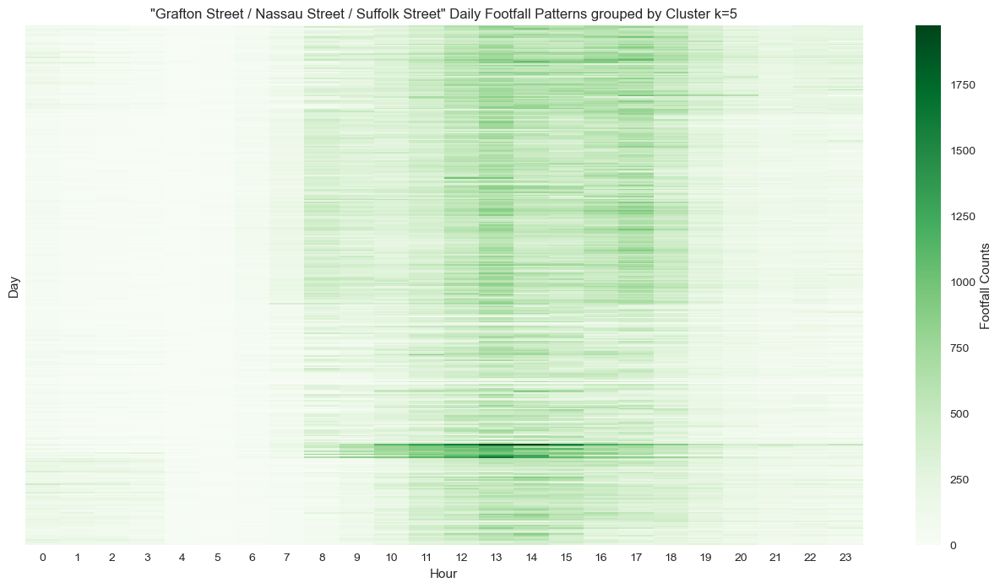

In [243]:
# plot heat map, yticklabels=False hides y-axis labels
plt.figure(figsize=(16, 8))
sns.heatmap(heatmap_graNasSuff_ml, cmap='Greens', yticklabels=False, cbar_kws={'label': 'Footfall Counts'})
plt.title(f'"Grafton Street / Nassau Street / Suffolk Street" Daily Footfall Patterns grouped by Cluster k={n_clusters}')
plt.xlabel('Hour')
plt.ylabel('Day')

plt.show()

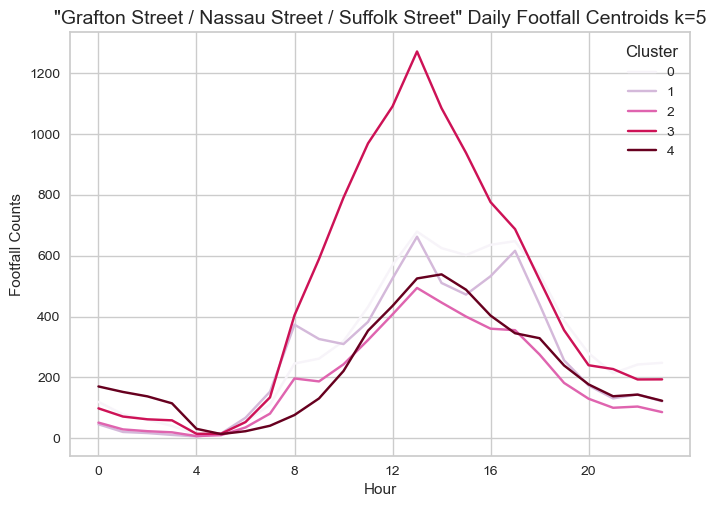

In [244]:
# convert to df for plotting
k_centroid_graNasSuff_ml = pd.DataFrame(k5_centroid_graNasSuff_ml).reset_index().melt(id_vars='index')
# name columns
k_centroid_graNasSuff_ml.columns = ['Cluster', 'Hour', 'Footfall Counts']

# plot
sns.lineplot(data=k_centroid_graNasSuff_ml, x='Hour', y='Footfall Counts', hue='Cluster', palette='PuRd')
plt.xticks(ticks=[0,4,8,12,16,20])
plt.title('"Grafton Street / Nassau Street / Suffolk Street" Daily Footfall Centroids k=5', fontsize=14)
plt.show()

In [245]:
#select dates for cluster
dates_graNasSuff_ml = clustered_graNasSuff_ml[clustered_graNasSuff_ml['Cluster'] == 3]

In [246]:
# list dates for Cluster
dates_graNasSuff_ml.index

Index([2023-03-17, 2023-04-07, 2023-04-08, 2023-04-11, 2023-04-12, 2023-04-13,
       2023-04-14, 2023-04-15, 2023-04-17, 2023-06-24],
      dtype='object', name='Date')

## **4.3 k-means Clustering of "Dame Street/Londis"**

In [247]:
# create pivot table: values specifies column; index specifies row labels, column specifies column labels
dameLon_ml = footfall23_ml.pivot_table(values="Dame Street/Londis", index='Date', columns='Hour')

In [248]:
# check for NaNs
dameLon_ml.isnull().sum()
# fill missing value # Note: unsure how NaNs get created here
dameLon_ml = dameLon_ml.fillna(method='ffill')

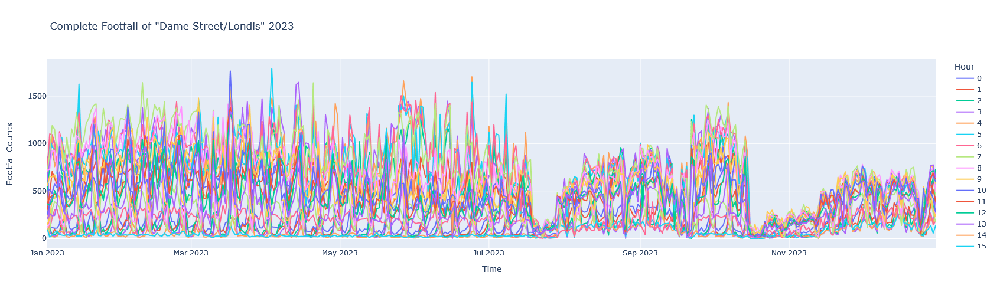

In [249]:
dameLon_ml_fig = px.line(dameLon_ml, y=dameLon_ml.columns, title='Complete Footfall of "Dame Street/Londis" 2023')

dameLon_ml_fig.update_layout(
    xaxis_title="Time",
    yaxis_title="Footfall Counts",
    legend_title="Hour",
    width=1500,
    height=500
    )

dameLon_ml_fig.show()

In [250]:
# normalize data
dameLon_norm_ml = sc.fit_transform(dameLon_ml)

In [251]:
# sets kmeans
kmeans = KMeans(random_state=42)

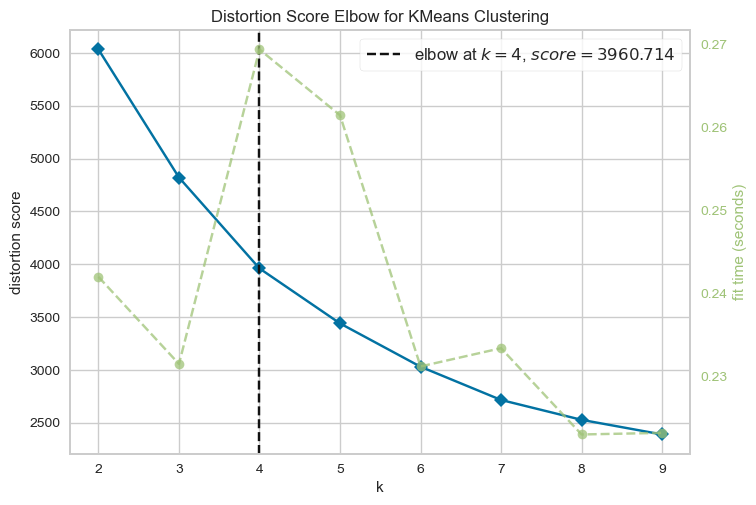

<Axes: title={'center': 'Distortion Score Elbow for KMeans Clustering'}, xlabel='k', ylabel='distortion score'>

In [252]:
# yellowbrick visualizer to display, distortion is essentially inertia
visualizer = KElbowVisualizer(kmeans, k=(2,10))
# fit data to yb visualizer
visualizer.fit(dameLon_norm_ml)        
visualizer.show()

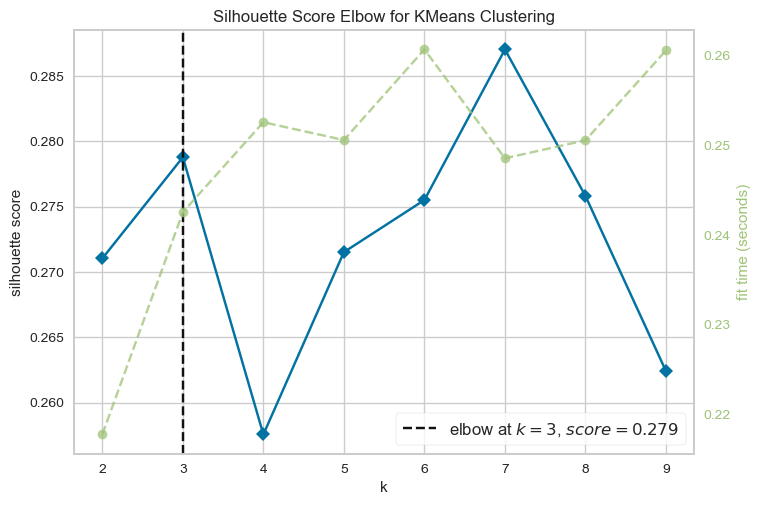

<Axes: title={'center': 'Silhouette Score Elbow for KMeans Clustering'}, xlabel='k', ylabel='silhouette score'>

In [253]:
# yellowbrick visualizer to display silhouette score at each k
visualizer = KElbowVisualizer(kmeans, k=(2,10), metric="silhouette")
# fit data to yb visualizer
visualizer.fit(dameLon_norm_ml)        
visualizer.show()

**k=5 Clustering of "Complete Footfall of "Dame Street/Londis" 2023"**

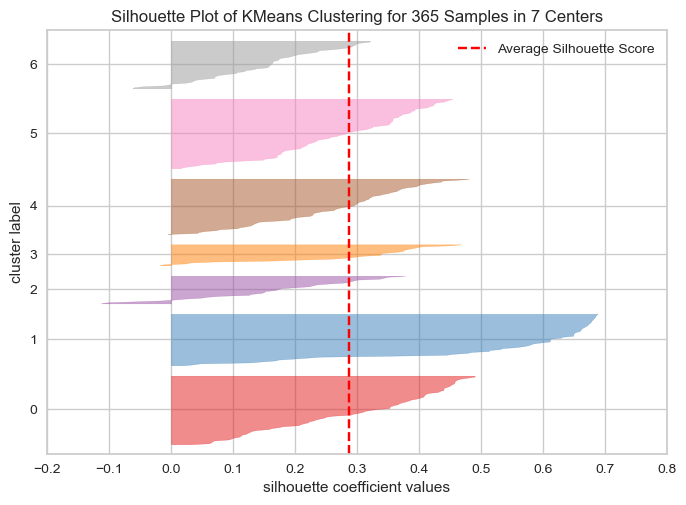

<Axes: title={'center': 'Silhouette Plot of KMeans Clustering for 365 Samples in 7 Centers'}, xlabel='silhouette coefficient values', ylabel='cluster label'>

In [254]:
kmeans = KMeans(n_clusters = 7, random_state=42)

sil_visualizer = SilhouetteVisualizer(kmeans)
sil_visualizer.fit(dameLon_norm_ml)    
sil_visualizer.show()

In [255]:
# from sklearn silhouette can be directly called
silhouette_score(dameLon_norm_ml, kmeans.labels_)

0.28704219202148956

**k=5 Heatmap of "Dame Street/Londis" Clustering** 

In [256]:
# choose clusters
n_clusters = 7
# set kmeans
kmeans = KMeans(n_clusters=n_clusters, random_state=42)
# perform k means
k_dameLon_ml = kmeans.fit_predict(dameLon_norm_ml)

In [257]:
# show cluster labels

# k_dameLon_ml

In [258]:
#add cluster labels to df
clustered_dameLon_ml = dameLon_ml
clustered_dameLon_ml["Cluster"] = k_dameLon_ml

In [259]:
# show clusters

# clustered_dameLon_ml

In [260]:
# define clusters for plotting later
k5_centroid_dameLon_ml = sc.inverse_transform(kmeans.cluster_centers_)

In [261]:
# how many days per cluster?
clustered_dameLon_ml['Cluster'].value_counts()

Cluster
5    74
0    73
4    59
1    55
6    51
2    30
3    23
Name: count, dtype: int64

In [262]:
# sort by cluster
clustered_sort_dameLon_ml = clustered_dameLon_ml.sort_values("Cluster")

In [263]:
# show sorted clusters

#clustered_sort_dameLon_ml

In [264]:
#drop cluster column for heat map
heatmap_dameLon_ml = clustered_sort_dameLon_ml.drop("Cluster", axis=1)

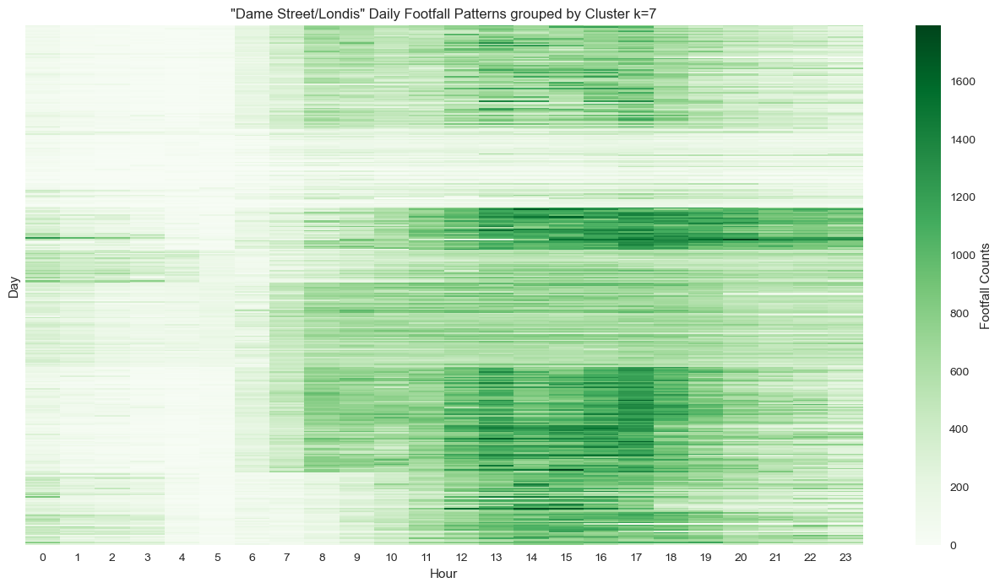

In [265]:
# plot heat map, yticklabels=False hides y-axis labels
plt.figure(figsize=(16, 8))
sns.heatmap(heatmap_dameLon_ml, cmap='Greens', yticklabels=False, cbar_kws={'label': 'Footfall Counts'})
plt.title(f'"Dame Street/Londis" Daily Footfall Patterns grouped by Cluster k={n_clusters}')
plt.xlabel('Hour')
plt.ylabel('Day')

plt.show()

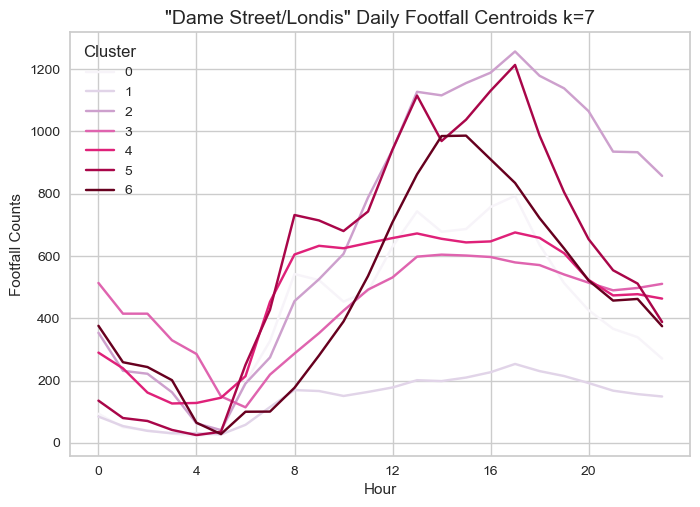

In [266]:
# convert to df for plotting
k_centroid_dameLon_ml = pd.DataFrame(k5_centroid_dameLon_ml).reset_index().melt(id_vars='index')
# name columns
k_centroid_dameLon_ml.columns = ['Cluster', 'Hour', 'Footfall Counts']

# plot
sns.lineplot(data=k_centroid_dameLon_ml, x='Hour', y='Footfall Counts', hue='Cluster', palette='PuRd')
plt.xticks(ticks=[0,4,8,12,16,20])
plt.title('"Dame Street/Londis" Daily Footfall Centroids k=7', fontsize=14)
plt.show()

Observations 
belongs to cluster 3

In [267]:
#select dates for cluster
dates_dameLon_ml = clustered_dameLon_ml[clustered_dameLon_ml['Cluster'] == 2]

In [268]:
# list dates for Cluster
dates_dameLon_ml.index

Index([2023-01-14, 2023-01-20, 2023-01-21, 2023-01-27, 2023-01-28, 2023-02-03,
       2023-02-04, 2023-02-10, 2023-02-11, 2023-02-17, 2023-02-18, 2023-02-24,
       2023-02-25, 2023-03-03, 2023-03-04, 2023-03-10, 2023-03-16, 2023-03-17,
       2023-03-18, 2023-03-24, 2023-03-25, 2023-04-07, 2023-04-14, 2023-04-15,
       2023-05-20, 2023-05-27, 2023-09-22, 2023-09-23, 2023-09-30, 2023-10-07],
      dtype='object', name='Date')

## **4.4 "From the Bottom Up": Hierarchical Clustering of "College st/Westmoreland"**

Hierarchical or Agglomerative Clustering is another form of unsupervised learning, which builds clusters from the "bottom up". A used analogy is that of tiny bubbles floating on water and gradually attaching to each other into a single group of large bubbles. Below, sklearn's agglomerative clustering algorithms will be employed to explore "College st/Westmoreland", in an effort to compare results against those from k-means clustering.

In [269]:
#set up
agg = AgglomerativeClustering(n_clusters=5, affinity='euclidean', linkage='ward')

In [270]:
# apply algo
agg_colWest_ml = agg.fit_predict(colWest_norm_ml)

In [271]:
# show agg labels
# agg_colWest_ml

In [272]:
#add cluster labels to df
clustered_agg_colWest_ml = colWest_ml
clustered_agg_colWest_ml["Cluster"] = agg_colWest_ml

In [273]:
# how many days per cluster?
clustered_agg_colWest_ml['Cluster'].value_counts()

Cluster
1    131
2    114
0     53
4     48
3     19
Name: count, dtype: int64

In [274]:
#select dates for cluster
dates_agg_colWest_ml = clustered_agg_colWest_ml[clustered_agg_colWest_ml['Cluster'] == 3]

In [275]:
# list dates for Cluster
dates_agg_colWest_ml.index

Index([2023-03-17, 2023-03-18, 2023-03-25, 2023-04-15, 2023-04-29, 2023-05-20,
       2023-06-24, 2023-08-26, 2023-09-23, 2023-10-07, 2023-10-14, 2023-10-21,
       2023-10-28, 2023-11-04, 2023-11-11, 2023-11-18, 2023-12-02, 2023-12-09,
       2023-12-16],
      dtype='object', name='Date')

In [276]:
# sort by cluster
clustered_sort_agg_colWest_ml = clustered_agg_colWest_ml.sort_values("Cluster")

In [277]:
#drop cluster column for heat map
heatmap_agg_colWest_ml = clustered_sort_agg_colWest_ml.drop("Cluster", axis=1)

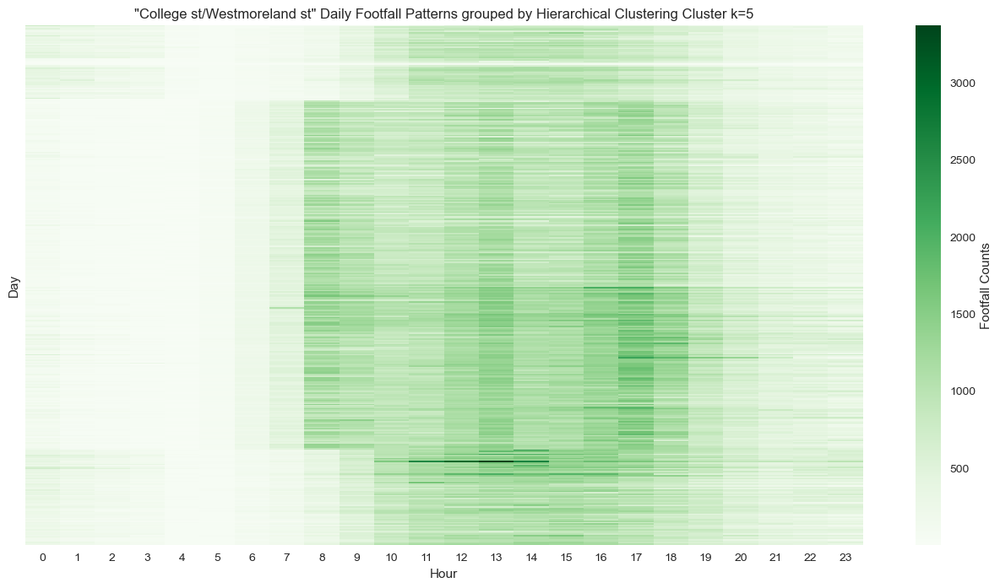

In [278]:
# plot heat map, yticklabels=False hides y-axis labels
plt.figure(figsize=(16, 8))
sns.heatmap(heatmap_agg_colWest_ml, cmap='Greens', yticklabels=False, cbar_kws={'label': 'Footfall Counts'})
plt.title(f'"College st/Westmoreland st" Daily Footfall Patterns grouped by Hierarchical Clustering Cluster k=5')
plt.xlabel('Hour')
plt.ylabel('Day')

plt.show()

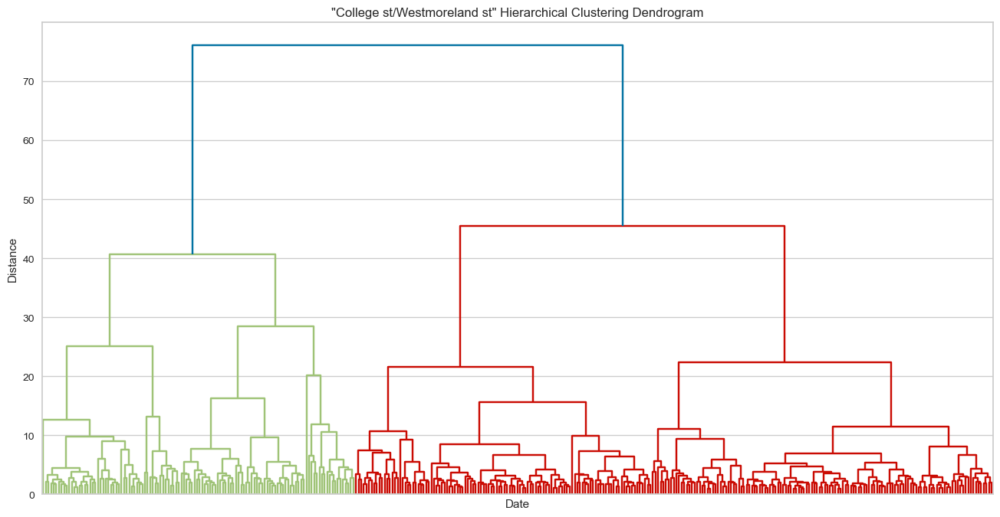

In [279]:
# generate the linkage matrix
Z = linkage(colWest_norm_ml, method='ward')

# Plotting the dendrogram
plt.figure(figsize=(16, 8))
dendrogram(Z, no_labels=1)
plt.title('"College st/Westmoreland st" Hierarchical Clustering Dendrogram')
plt.xlabel('Date')
plt.ylabel('Distance')
plt.show()